In [1]:
import pandas as pd
import os
import geopandas as gp
import osmnx as ox
import matplotlib.pyplot as plt
import seaborn as sns

# Examine semantic segmentation and choose city

In [41]:
ss = pd.read_csv('/Users/yujun/Downloads/60000-70000_output.csv').rename(columns={'Unnamed: 0': 'filename'})
ss

,filename,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total
0,869054e3-ea58-40b0-a5a8-a41cd86e7cf3.jpeg,0,0,0,412596,0,1044240,0,0,0,...,0,0,0,0,0,603540,0,0,0,11714712
1,a8ee77d5-922c-4666-9c2a-8901b6e77121.jpeg,0,0,0,19740,478428,873348,4290972,0,0,...,0,0,0,0,0,38940,0,0,0,11831892
2,426a535e-d26c-4ccc-bafe-f39f326492fa.jpeg,0,0,0,95700,74664,1262436,4172148,0,0,...,0,0,0,0,0,93360,0,0,0,11768232
3,1eaa423d-1fdd-426f-a7fb-adbc9ef16ff0.jpeg,0,0,0,1118784,61380,1203336,0,0,0,...,0,0,0,0,0,333720,0,0,0,11760384
4,c06e8b2a-d317-4ad1-bdfc-36dd09be6f95.jpeg,0,0,0,27744,235872,685368,0,0,0,...,0,0,0,135180,0,120528,0,0,0,11470644
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,d98c9fa9-c8ce-4fe9-9a62-b1924a54e978.jpeg,0,0,185020,481305,0,0,217778,519827,0,...,0,4081,0,0,0,138336,0,0,0,12898820
9996,ed56be3a-af3b-4b7f-87e5-07c8905cc4ce.jpeg,0,0,0,0,0,0,0,1512104,0,...,0,0,0,0,0,0,2607,0,0,12723271
9997,cc06e10d-dd9c-4cde-b093-bcf4b4fb21e0.jpeg,0,0,288486,331298,0,0,984632,0,0,...,0,0,0,0,0,0,0,0,0,12704373
9998,22273fd3-8cd7-4543-8819-4f73000b124a.jpeg,0,0,0,42196,0,0,1372888,0,0,...,0,0,0,0,0,0,0,0,0,12794738


In [7]:
ss['uuid'] = ss['filename'].apply(lambda x: x.split('.')[0])
ss

,filename,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,uuid
0,869054e3-ea58-40b0-a5a8-a41cd86e7cf3.jpeg,0,0,0,412596,0,1044240,0,0,0,...,0,0,0,0,603540,0,0,0,11714712,869054e3-ea58-40b0-a5a8-a41cd86e7cf3
1,a8ee77d5-922c-4666-9c2a-8901b6e77121.jpeg,0,0,0,19740,478428,873348,4290972,0,0,...,0,0,0,0,38940,0,0,0,11831892,a8ee77d5-922c-4666-9c2a-8901b6e77121
2,426a535e-d26c-4ccc-bafe-f39f326492fa.jpeg,0,0,0,95700,74664,1262436,4172148,0,0,...,0,0,0,0,93360,0,0,0,11768232,426a535e-d26c-4ccc-bafe-f39f326492fa
3,1eaa423d-1fdd-426f-a7fb-adbc9ef16ff0.jpeg,0,0,0,1118784,61380,1203336,0,0,0,...,0,0,0,0,333720,0,0,0,11760384,1eaa423d-1fdd-426f-a7fb-adbc9ef16ff0
4,c06e8b2a-d317-4ad1-bdfc-36dd09be6f95.jpeg,0,0,0,27744,235872,685368,0,0,0,...,0,0,135180,0,120528,0,0,0,11470644,c06e8b2a-d317-4ad1-bdfc-36dd09be6f95
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,d98c9fa9-c8ce-4fe9-9a62-b1924a54e978.jpeg,0,0,185020,481305,0,0,217778,519827,0,...,4081,0,0,0,138336,0,0,0,12898820,d98c9fa9-c8ce-4fe9-9a62-b1924a54e978
9996,ed56be3a-af3b-4b7f-87e5-07c8905cc4ce.jpeg,0,0,0,0,0,0,0,1512104,0,...,0,0,0,0,0,2607,0,0,12723271,ed56be3a-af3b-4b7f-87e5-07c8905cc4ce
9997,cc06e10d-dd9c-4cde-b093-bcf4b4fb21e0.jpeg,0,0,288486,331298,0,0,984632,0,0,...,0,0,0,0,0,0,0,0,12704373,cc06e10d-dd9c-4cde-b093-bcf4b4fb21e0
9998,22273fd3-8cd7-4543-8819-4f73000b124a.jpeg,0,0,0,42196,0,0,1372888,0,0,...,0,0,0,0,0,0,0,0,12794738,22273fd3-8cd7-4543-8819-4f73000b124a


In [8]:
sm = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/simplemaps.csv').drop(columns=['Unnamed: 0'])
sm.info()

/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (13) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7127577 entries, 0 to 7127576
Data columns (total 15 columns):
 #   Column      Dtype  
---  ------      -----  
 0   uuid        object 
 1   source      object 
 2   orig_id     int64  
 3   city        object 
 4   city_ascii  object 
 5   city_id     int64  
 6   city_lat    float64
 7   city_lon    float64
 8   country     object 
 9   iso2        object 
 10  iso3        object 
 11  admin_name  object 
 12  capital     object 
 13  population  float64
 14  continent   object 
dtypes: float64(3), int64(2), object(10)
memory usage: 815.7+ MB


In [9]:
ss = ss.merge(sm[['uuid', 'source', 'orig_id', 'city', 'city_ascii', 'city_id', 'city_lat', 'city_lon']], on='uuid', how='left')
ss.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 0 to 9999
Data columns (total 75 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   filename                  10000 non-null  object 
 1   Bird                      10000 non-null  int64  
 2   Ground-Animal             10000 non-null  int64  
 3   Curb                      10000 non-null  int64  
 4   Fence                     10000 non-null  int64  
 5   Guard-Rail                10000 non-null  int64  
 6   Barrier                   10000 non-null  int64  
 7   Wall                      10000 non-null  int64  
 8   Bike-Lane                 10000 non-null  int64  
 9   Crosswalk---Plain         10000 non-null  int64  
 10  Curb-Cut                  10000 non-null  int64  
 11  Parking                   10000 non-null  int64  
 12  Pedestrian-Area           10000 non-null  int64  
 13  Rail-Track                10000 non-null  int64  
 14  Road   

In [10]:
ss['city_id'].value_counts()

1188749877    7059
1392464033    2518
1250083981     347
1250363682      76
Name: city_id, dtype: int64

In [12]:
df = ss[ss['city_id'] == 1188749877].reset_index(drop=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7059 entries, 0 to 7058
Data columns (total 75 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   filename                  7059 non-null   object 
 1   Bird                      7059 non-null   int64  
 2   Ground-Animal             7059 non-null   int64  
 3   Curb                      7059 non-null   int64  
 4   Fence                     7059 non-null   int64  
 5   Guard-Rail                7059 non-null   int64  
 6   Barrier                   7059 non-null   int64  
 7   Wall                      7059 non-null   int64  
 8   Bike-Lane                 7059 non-null   int64  
 9   Crosswalk---Plain         7059 non-null   int64  
 10  Curb-Cut                  7059 non-null   int64  
 11  Parking                   7059 non-null   int64  
 12  Pedestrian-Area           7059 non-null   int64  
 13  Rail-Track                7059 non-null   int64  
 14  Road    

In [14]:
df['source'].value_counts()

KartaView    7059
Name: source, dtype: int64

# Construct gdf and visualise points distribution

In [15]:
meta = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/metadata.csv')[['uuid', 'lat', 'lon', 'datetime_local', 'sequenceIndex', 'kv_sequenceId']]

/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (14,17,18,19,21,23,28,29,31,33,35,36,37,38,39,42,43,44,45,46,47,48,49,54,60,61,64,65,70,73,74,75,77,78) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [16]:
df = df.merge(meta, on='uuid', how='left')
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7059 entries, 0 to 7058
Data columns (total 80 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   filename                  7059 non-null   object 
 1   Bird                      7059 non-null   int64  
 2   Ground-Animal             7059 non-null   int64  
 3   Curb                      7059 non-null   int64  
 4   Fence                     7059 non-null   int64  
 5   Guard-Rail                7059 non-null   int64  
 6   Barrier                   7059 non-null   int64  
 7   Wall                      7059 non-null   int64  
 8   Bike-Lane                 7059 non-null   int64  
 9   Crosswalk---Plain         7059 non-null   int64  
 10  Curb-Cut                  7059 non-null   int64  
 11  Parking                   7059 non-null   int64  
 12  Pedestrian-Area           7059 non-null   int64  
 13  Rail-Track                7059 non-null   int64  
 14  Road    

In [17]:
df.head()

,filename,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,city,city_ascii,city_id,city_lat,city_lon,lat,lon,datetime_local,sequenceIndex,kv_sequenceId
0,33eb6c19-de62-4966-96b4-ac9ce54d10b6.jpeg,0,0,73673,0,0,0,38161,0,0,...,San José,San Jose,1188749877,9.9333,-84.0833,9.927172,-84.078427,2014-11-21 04:45:52-06:00,153,3353309.0
1,5939624f-20e4-4250-908b-c6be090ef480.jpeg,0,0,5386,0,0,0,0,0,0,...,San José,San Jose,1188749877,9.9333,-84.0833,9.925792,-84.073704,2014-11-21 04:44:35-06:00,120,3353309.0
2,09342107-3158-4b68-b374-d6b3ba5df509.jpeg,0,0,129404,2482,0,0,71598,0,0,...,San José,San Jose,1188749877,9.9333,-84.0833,9.926512,-84.077588,2014-11-21 04:45:28-06:00,143,3353309.0
3,5bcf1fa0-3979-493f-bca6-86a99f65c80c.jpeg,0,0,109085,24185,0,0,130036,0,0,...,San José,San Jose,1188749877,9.9333,-84.0833,9.925954,-84.075133,2014-11-21 04:44:52-06:00,126,3353309.0
4,50164276-457f-44ae-b1ad-be488fa53544.jpeg,0,0,116615,1571,0,0,20632,0,0,...,San José,San Jose,1188749877,9.9333,-84.0833,9.927170,-84.077921,2014-11-21 04:45:42-06:00,148,3353309.0


In [25]:
pts = gp.GeoDataFrame(
    df, geometry=gp.points_from_xy(df.lon, df.lat), crs="EPSG:4326"
)
pts2 = ox.project_gdf(pts)

In [32]:
pts.total_bounds

array([-84.089341,   9.925601, -84.067386,   9.947207])

In [33]:
pts.total_bounds[0]

-84.089341

In [37]:
G = ox.graph_from_bbox(pts.total_bounds[3], pts.total_bounds[1], pts.total_bounds[2], pts.total_bounds[0], network_type='all_private', simplify=True, retain_all=True, truncate_by_edge=False)
G2 = ox.get_undirected(G)
df_G = ox.graph_to_gdfs(G2)
df_lines = df_G[1].copy()
df_lines_proj = ox.project_gdf(df_lines).reset_index().reset_index()

<AxesSubplot:>

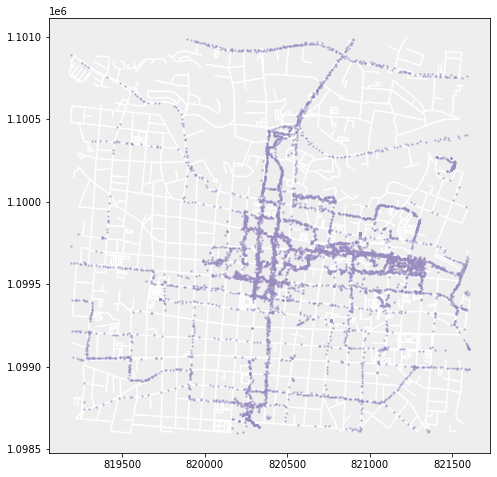

In [38]:
# create Matplotlib figure
fig, ax = plt.subplots(figsize=(8,8))
ax.set_facecolor('#EEEEEE')

# plot place area on Axis ax
df_lines_proj.plot(ax=ax, color='white', zorder=5)

# plot points on Axis ax
pts2.plot(ax=ax, marker='o', color='#998cc0', markersize=2, alpha=0.5, zorder=10)

# plot sampled images on Axis ax
#sample_df.plot(ax=ax, marker='o', color='red', markersize=2, alpha=1, zorder=15)



# Calculate GVI

In [42]:
pts2.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 7059 entries, 0 to 7058
Data columns (total 81 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   filename                  7059 non-null   object  
 1   Bird                      7059 non-null   int64   
 2   Ground-Animal             7059 non-null   int64   
 3   Curb                      7059 non-null   int64   
 4   Fence                     7059 non-null   int64   
 5   Guard-Rail                7059 non-null   int64   
 6   Barrier                   7059 non-null   int64   
 7   Wall                      7059 non-null   int64   
 8   Bike-Lane                 7059 non-null   int64   
 9   Crosswalk---Plain         7059 non-null   int64   
 10  Curb-Cut                  7059 non-null   int64   
 11  Parking                   7059 non-null   int64   
 12  Pedestrian-Area           7059 non-null   int64   
 13  Rail-Track                7059 non-null 

In [45]:
pts2['Vegetation'].value_counts()

0          1895
311030        2
4052830       2
22525         2
1993780       2
           ... 
231973        1
80327         1
482758        1
646852        1
5177238       1
Name: Vegetation, Length: 5152, dtype: int64

In [46]:
pts2['green_view_index'] = pts2.apply(lambda x: x['Vegetation']/x['Total'], axis=1)
pts2

,filename,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,city_id,city_lat,city_lon,lat,lon,datetime_local,sequenceIndex,kv_sequenceId,geometry,green_view_index
0,33eb6c19-de62-4966-96b4-ac9ce54d10b6.jpeg,0,0,73673,0,0,0,38161,0,0,...,1188749877,9.9333,-84.0833,9.927172,-84.078427,2014-11-21 04:45:52-06:00,153,3353309.0,POINT (820393.812 1098769.538),0.118970
1,5939624f-20e4-4250-908b-c6be090ef480.jpeg,0,0,5386,0,0,0,0,0,0,...,1188749877,9.9333,-84.0833,9.925792,-84.073704,2014-11-21 04:44:35-06:00,120,3353309.0,POINT (820913.531 1098621.337),0.027845
2,09342107-3158-4b68-b374-d6b3ba5df509.jpeg,0,0,129404,2482,0,0,71598,0,0,...,1188749877,9.9333,-84.0833,9.926512,-84.077588,2014-11-21 04:45:28-06:00,143,3353309.0,POINT (820486.539 1098697.287),0.056595
3,5bcf1fa0-3979-493f-bca6-86a99f65c80c.jpeg,0,0,109085,24185,0,0,130036,0,0,...,1188749877,9.9333,-84.0833,9.925954,-84.075133,2014-11-21 04:44:52-06:00,126,3353309.0,POINT (820756.532 1098637.889),0.246661
4,50164276-457f-44ae-b1ad-be488fa53544.jpeg,0,0,116615,1571,0,0,20632,0,0,...,1188749877,9.9333,-84.0833,9.927170,-84.077921,2014-11-21 04:45:42-06:00,148,3353309.0,POINT (820449.350 1098769.806),0.038316
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7054,d98c9fa9-c8ce-4fe9-9a62-b1924a54e978.jpeg,0,0,185020,481305,0,0,217778,519827,0,...,1188749877,9.9333,-84.0833,9.931675,-84.076592,2018-01-12 16:09:12-06:00,120,3359657.0,POINT (820590.822 1099269.791),0.333438
7055,ed56be3a-af3b-4b7f-87e5-07c8905cc4ce.jpeg,0,0,0,0,0,0,0,1512104,0,...,1188749877,9.9333,-84.0833,9.931910,-84.076236,2018-01-12 16:09:30-06:00,132,3359657.0,POINT (820629.665 1099296.149),0.053750
7056,cc06e10d-dd9c-4cde-b093-bcf4b4fb21e0.jpeg,0,0,288486,331298,0,0,984632,0,0,...,1188749877,9.9333,-84.0833,9.931642,-84.076646,2018-01-12 16:09:09-06:00,118,3359657.0,POINT (820584.928 1099266.085),0.342691
7057,22273fd3-8cd7-4543-8819-4f73000b124a.jpeg,0,0,0,42196,0,0,1372888,0,0,...,1188749877,9.9333,-84.0833,9.931579,-84.076816,2018-01-12 16:08:54-06:00,108,3359657.0,POINT (820566.331 1099258.947),0.469979


<AxesSubplot:>

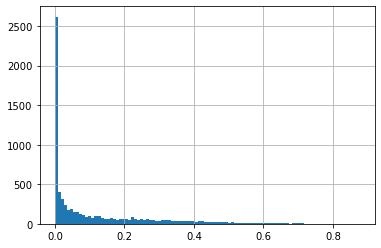

In [48]:
pts2.green_view_index.hist(bins=100)

# Import perception scores

In [49]:
perception = pd.read_csv('/Users/yujun/Data/global_streetscapes/model_output/place_pulse/Merge_Perception_Total.csv')
perception.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7127577 entries, 0 to 7127576
Data columns (total 7 columns):
 #   Column      Dtype  
---  ------      -----  
 0   Image_name  object 
 1   Beautiful   float64
 2   Boring      float64
 3   Depressing  float64
 4   Lively      float64
 5   Safe        float64
 6   Wealthy     float64
dtypes: float64(6), object(1)
memory usage: 380.7+ MB


In [50]:
perception.head()

,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
0,278f7c8a-3063-4acd-ae93-4c6ff848c8d3.jpeg,2.30,3.48,2.51,2.56,7.58,3.74
1,b6a4d5a1-dde2-40c9-9c55-bd6fb3431bef.jpeg,5.06,3.56,4.31,1.01,1.67,3.98
2,c502f3d8-0c08-407f-b2e1-14f3d5de49b6.jpeg,4.47,3.24,3.87,1.98,1.61,2.60
3,77536944-fd4e-4f0d-a724-a2d54f47b9a9.jpeg,6.03,2.83,0.92,4.44,4.13,3.59
4,fb8768bc-d9f6-4618-8dcb-7442a5337a5d.jpeg,1.95,5.57,1.43,2.71,2.48,3.59


In [51]:
perception['uuid'] = perception['Image_name'].apply(lambda x: x.split('.')[0])
perception.head()

,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,uuid
0,278f7c8a-3063-4acd-ae93-4c6ff848c8d3.jpeg,2.30,3.48,2.51,2.56,7.58,3.74,278f7c8a-3063-4acd-ae93-4c6ff848c8d3
1,b6a4d5a1-dde2-40c9-9c55-bd6fb3431bef.jpeg,5.06,3.56,4.31,1.01,1.67,3.98,b6a4d5a1-dde2-40c9-9c55-bd6fb3431bef
2,c502f3d8-0c08-407f-b2e1-14f3d5de49b6.jpeg,4.47,3.24,3.87,1.98,1.61,2.60,c502f3d8-0c08-407f-b2e1-14f3d5de49b6
3,77536944-fd4e-4f0d-a724-a2d54f47b9a9.jpeg,6.03,2.83,0.92,4.44,4.13,3.59,77536944-fd4e-4f0d-a724-a2d54f47b9a9
4,fb8768bc-d9f6-4618-8dcb-7442a5337a5d.jpeg,1.95,5.57,1.43,2.71,2.48,3.59,fb8768bc-d9f6-4618-8dcb-7442a5337a5d


In [52]:
pts2 = pts2.merge(perception.drop(columns=['Image_name']), on='uuid', how='left')
pts2

,filename,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,sequenceIndex,kv_sequenceId,geometry,green_view_index,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
0,33eb6c19-de62-4966-96b4-ac9ce54d10b6.jpeg,0,0,73673,0,0,0,38161,0,0,...,153,3353309.0,POINT (820393.812 1098769.538),0.118970,4.52,1.62,3.37,7.64,7.60,5.87
1,5939624f-20e4-4250-908b-c6be090ef480.jpeg,0,0,5386,0,0,0,0,0,0,...,120,3353309.0,POINT (820913.531 1098621.337),0.027845,6.10,5.58,2.95,4.38,3.94,2.42
2,09342107-3158-4b68-b374-d6b3ba5df509.jpeg,0,0,129404,2482,0,0,71598,0,0,...,143,3353309.0,POINT (820486.539 1098697.287),0.056595,6.12,3.45,6.48,7.38,2.65,1.96
3,5bcf1fa0-3979-493f-bca6-86a99f65c80c.jpeg,0,0,109085,24185,0,0,130036,0,0,...,126,3353309.0,POINT (820756.532 1098637.889),0.246661,8.48,3.15,5.36,3.98,5.58,5.62
4,50164276-457f-44ae-b1ad-be488fa53544.jpeg,0,0,116615,1571,0,0,20632,0,0,...,148,3353309.0,POINT (820449.350 1098769.806),0.038316,6.25,2.18,4.13,9.07,6.68,1.55
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7054,d98c9fa9-c8ce-4fe9-9a62-b1924a54e978.jpeg,0,0,185020,481305,0,0,217778,519827,0,...,120,3359657.0,POINT (820590.822 1099269.791),0.333438,7.23,2.13,3.00,7.50,7.03,4.39
7055,ed56be3a-af3b-4b7f-87e5-07c8905cc4ce.jpeg,0,0,0,0,0,0,0,1512104,0,...,132,3359657.0,POINT (820629.665 1099296.149),0.053750,7.51,1.36,7.14,7.92,8.01,4.14
7056,cc06e10d-dd9c-4cde-b093-bcf4b4fb21e0.jpeg,0,0,288486,331298,0,0,984632,0,0,...,118,3359657.0,POINT (820584.928 1099266.085),0.342691,8.40,2.26,1.68,5.91,4.59,5.02
7057,22273fd3-8cd7-4543-8819-4f73000b124a.jpeg,0,0,0,42196,0,0,1372888,0,0,...,108,3359657.0,POINT (820566.331 1099258.947),0.469979,6.63,3.76,1.97,5.45,8.15,3.74


# Import transportation mode

In [70]:
trans = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/transportation.csv').drop(columns=['Unnamed: 0'])
trans.info()

/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (5) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7127577 entries, 0 to 7127576
Data columns (total 11 columns):
 #   Column          Dtype  
---  ------          -----  
 0   uuid            object 
 1   source          object 
 2   orig_id         int64  
 3   sequenceIndex   int64  
 4   mly_sequenceId  object 
 5   kv_sequenceId   float64
 6   dist_seq_m      float64
 7   dist_seq_km     float64
 8   time_seq_hr     float64
 9   speed_seq_kph   float64
 10  transportation  object 
dtypes: float64(5), int64(2), object(4)
memory usage: 598.2+ MB


In [71]:
trans.head()

,uuid,source,orig_id,sequenceIndex,mly_sequenceId,kv_sequenceId,dist_seq_m,dist_seq_km,time_seq_hr,speed_seq_kph,transportation
0,d3cca4a7-7994-47ff-9749-7df8ca7228e3,Mapillary,412070930384924,162,64fWKYwo1QbyUl0jZmuBOF,NaN,1401.373212,1.401373,0.083044,16.875148,driving
1,33f474ab-496e-41a7-86a6-08fad8fe6638,Mapillary,897137344568478,77,PEOixVS4MCXw9ZD7kd1uF2,NaN,2845.008740,2.845009,0.063619,44.719365,driving
2,0da8bf8d-bf34-4d94-aa51-2a7a3c880f6b,Mapillary,266236242103987,138,qc2h9ZIeNtUoDbBy6wdizl,NaN,1732.315605,1.732316,0.084481,20.505293,driving
3,23c0aa2e-573b-4a3f-a65b-fb8f7349725b,Mapillary,646336503014104,61,zH6VgUcYoibQ8907ytedxT,NaN,282.448250,0.282448,0.025564,11.048720,cycling
4,4f47ba8e-8437-4213-9721-8336b02ea703,Mapillary,404485487755735,142,PEOixVS4MCXw9ZD7kd1uF2,NaN,2845.008740,2.845009,0.063619,44.719365,driving


In [72]:
pts2

,filename,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,geometry,green_view_index,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,easting,northing
0,33eb6c19-de62-4966-96b4-ac9ce54d10b6.jpeg,0,0,73673,0,0,0,38161,0,0,...,POINT (820393.812 1098769.538),0.118970,4.52,1.62,3.37,7.64,7.60,5.87,820393.811569,1.098770e+06
1,5939624f-20e4-4250-908b-c6be090ef480.jpeg,0,0,5386,0,0,0,0,0,0,...,POINT (820913.531 1098621.337),0.027845,6.10,5.58,2.95,4.38,3.94,2.42,820913.531177,1.098621e+06
2,09342107-3158-4b68-b374-d6b3ba5df509.jpeg,0,0,129404,2482,0,0,71598,0,0,...,POINT (820486.539 1098697.287),0.056595,6.12,3.45,6.48,7.38,2.65,1.96,820486.538954,1.098697e+06
3,5bcf1fa0-3979-493f-bca6-86a99f65c80c.jpeg,0,0,109085,24185,0,0,130036,0,0,...,POINT (820756.532 1098637.889),0.246661,8.48,3.15,5.36,3.98,5.58,5.62,820756.532291,1.098638e+06
4,50164276-457f-44ae-b1ad-be488fa53544.jpeg,0,0,116615,1571,0,0,20632,0,0,...,POINT (820449.350 1098769.806),0.038316,6.25,2.18,4.13,9.07,6.68,1.55,820449.349508,1.098770e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7054,d98c9fa9-c8ce-4fe9-9a62-b1924a54e978.jpeg,0,0,185020,481305,0,0,217778,519827,0,...,POINT (820590.822 1099269.791),0.333438,7.23,2.13,3.00,7.50,7.03,4.39,820590.822376,1.099270e+06
7055,ed56be3a-af3b-4b7f-87e5-07c8905cc4ce.jpeg,0,0,0,0,0,0,0,1512104,0,...,POINT (820629.665 1099296.149),0.053750,7.51,1.36,7.14,7.92,8.01,4.14,820629.665487,1.099296e+06
7056,cc06e10d-dd9c-4cde-b093-bcf4b4fb21e0.jpeg,0,0,288486,331298,0,0,984632,0,0,...,POINT (820584.928 1099266.085),0.342691,8.40,2.26,1.68,5.91,4.59,5.02,820584.927859,1.099266e+06
7057,22273fd3-8cd7-4543-8819-4f73000b124a.jpeg,0,0,0,42196,0,0,1372888,0,0,...,POINT (820566.331 1099258.947),0.469979,6.63,3.76,1.97,5.45,8.15,3.74,820566.331176,1.099259e+06


In [73]:
pts2 = pts2.merge(trans.drop(columns=['source', 'orig_id']), on='uuid', how='left')
pts2

,filename,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,easting,northing,sequenceIndex_y,mly_sequenceId,kv_sequenceId_y,dist_seq_m,dist_seq_km,time_seq_hr,speed_seq_kph,transportation
0,33eb6c19-de62-4966-96b4-ac9ce54d10b6.jpeg,0,0,73673,0,0,0,38161,0,0,...,820393.811569,1.098770e+06,153,NaN,3353309.0,1468.342629,1.468343,0.096944,15.146228,driving
1,5939624f-20e4-4250-908b-c6be090ef480.jpeg,0,0,5386,0,0,0,0,0,0,...,820913.531177,1.098621e+06,120,NaN,3353309.0,1468.342629,1.468343,0.096944,15.146228,driving
2,09342107-3158-4b68-b374-d6b3ba5df509.jpeg,0,0,129404,2482,0,0,71598,0,0,...,820486.538954,1.098697e+06,143,NaN,3353309.0,1468.342629,1.468343,0.096944,15.146228,driving
3,5bcf1fa0-3979-493f-bca6-86a99f65c80c.jpeg,0,0,109085,24185,0,0,130036,0,0,...,820756.532291,1.098638e+06,126,NaN,3353309.0,1468.342629,1.468343,0.096944,15.146228,driving
4,50164276-457f-44ae-b1ad-be488fa53544.jpeg,0,0,116615,1571,0,0,20632,0,0,...,820449.349508,1.098770e+06,148,NaN,3353309.0,1468.342629,1.468343,0.096944,15.146228,driving
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7054,d98c9fa9-c8ce-4fe9-9a62-b1924a54e978.jpeg,0,0,185020,481305,0,0,217778,519827,0,...,820590.822376,1.099270e+06,120,NaN,3359657.0,919.982615,0.919983,0.157222,5.851480,walking
7055,ed56be3a-af3b-4b7f-87e5-07c8905cc4ce.jpeg,0,0,0,0,0,0,0,1512104,0,...,820629.665487,1.099296e+06,132,NaN,3359657.0,919.982615,0.919983,0.157222,5.851480,walking
7056,cc06e10d-dd9c-4cde-b093-bcf4b4fb21e0.jpeg,0,0,288486,331298,0,0,984632,0,0,...,820584.927859,1.099266e+06,118,NaN,3359657.0,919.982615,0.919983,0.157222,5.851480,walking
7057,22273fd3-8cd7-4543-8819-4f73000b124a.jpeg,0,0,0,42196,0,0,1372888,0,0,...,820566.331176,1.099259e+06,108,NaN,3359657.0,919.982615,0.919983,0.157222,5.851480,walking


In [74]:
pts2.drop(columns=['geometry']).to_csv('/Users/yujun/Data/global_streetscapes/for_qgis/sanjose.csv')

# Visualise on maps

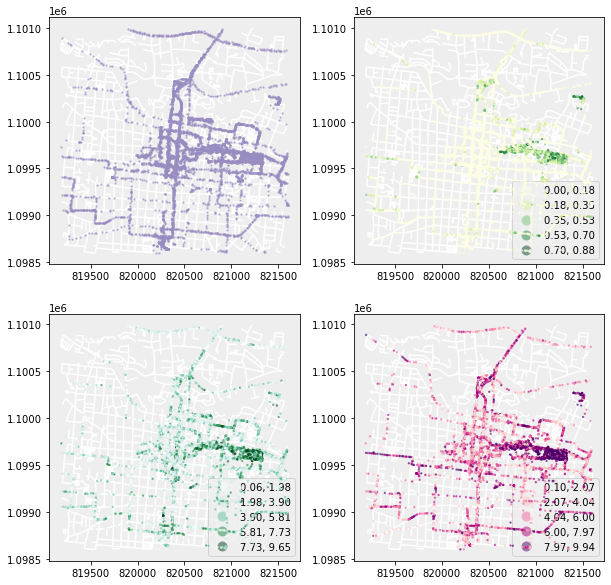

In [57]:
# create Matplotlib figure
fig, axes = plt.subplots(2, 2, figsize=(10,10))

for i in range(4):
    
    row, col = divmod(i, 2)
    ax = axes[row, col]
    
    ax.set_facecolor('#EEEEEE')
    df_lines_proj.plot(ax=ax, color='white', zorder=5)
    
    
    if i == 0:
        pts2.plot(ax=ax, marker='o', color='#998cc0', markersize=2, alpha=0.5, zorder=10)
    if i == 1:
        pts2.plot(ax=ax, 
                  column='green_view_index', 
                  scheme='equal_interval', 
                  cmap='YlGn',
                  k=5, 
                  alpha=0.5, 
                  markersize=2,
                  legend=True,
                  legend_kwds={'facecolor':'#EEEEEE',
                            'loc':'lower right'},
                  zorder=10)
    if i == 2:
        pts2.plot(ax=ax, 
                  column='Safe', 
                  scheme='equal_interval', 
                  cmap='BuGn',
                  k=5, 
                  alpha=0.5, 
                  markersize=2,
                  legend=True,
                  legend_kwds={'facecolor':'#EEEEEE',
                            'loc':'lower right'},
                  zorder=10)
    if i == 3:
        pts2.plot(ax=ax, 
                  column='Beautiful', 
                  scheme='equal_interval', 
                  cmap='RdPu',
                  k=5, 
                  alpha=0.5, 
                  markersize=2,
                  legend=True,
                  legend_kwds={'facecolor':'#EEEEEE',
                            'loc':'lower right'},
                  zorder=10)




In [60]:
pts2['easting'] = pts2.geometry.x
pts2['northing'] = pts2.geometry.y
pts2.drop(columns=['geometry']).to_csv('/Users/yujun/Data/global_streetscapes/for_qgis/sanjose.csv')

In [62]:
df_lines = df_lines.reset_index().reset_index()
df_lines

,index,u,v,key,osmid,oneway,name,highway,length,from,...,geometry,lanes,ref,maxspeed,access,service,width,bridge,tunnel,junction
0,0,115583771,3836418406,0,25111148,True,Avenida 3 Joaquín García Monge,residential,98.293,115583771,...,"LINESTRING (-84.08733 9.93632, -84.08822 9.93644)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,115583771,350548366,0,31437758,True,Avenida 3 Joaquín García Monge,residential,63.761,115583771,...,"LINESTRING (-84.08733 9.93632, -84.08675 9.93627)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,115583771,115583926,0,718050627,True,Calle 20 Juan Santamaría,tertiary,81.078,115583771,...,"LINESTRING (-84.08733 9.93632, -84.08738 9.93560)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,115583771,163366303,0,718050627,True,Calle 20 Juan Santamaría,tertiary,82.003,163366303,...,"LINESTRING (-84.08727 9.93706, -84.08733 9.93632)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,115583772,1878781692,0,30721346,True,Calle 18,residential,46.350,115583772,...,"LINESTRING (-84.08640 9.93625, -84.08634 9.93666)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2140,2140,11236853874,11236853878,0,"[1212832898, 1212832899, 1212832900]",False,NaN,service,46.185,11236853878,...,"LINESTRING (-84.07377 9.93510, -84.07376 9.935...",NaN,NaN,NaN,NaN,parking_aisle,NaN,NaN,building_passage,NaN
2141,2141,11237188734,11237210437,0,1212898612,False,NaN,footway,5.183,11237210437,...,"LINESTRING (-84.08451 9.93357, -84.08451 9.933...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2142,2142,11237188736,11237210437,0,1212898612,False,NaN,footway,9.309,11237210437,...,"LINESTRING (-84.08451 9.93357, -84.08450 9.933...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2143,2143,11244363129,11244363130,0,1213675276,False,NaN,footway,4.206,11244363130,...,"LINESTRING (-84.06778 9.93218, -84.06777 9.93222)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [63]:
df_lines['geometry_wkt'] = df_lines['geometry'].to_wkt()
df_lines

,index,u,v,key,osmid,oneway,name,highway,length,from,...,lanes,ref,maxspeed,access,service,width,bridge,tunnel,junction,geometry_wkt
0,0,115583771,3836418406,0,25111148,True,Avenida 3 Joaquín García Monge,residential,98.293,115583771,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (-84.0873277 9.9363231, -84.0882175..."
1,1,115583771,350548366,0,31437758,True,Avenida 3 Joaquín García Monge,residential,63.761,115583771,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (-84.0873277 9.9363231, -84.0867477..."
2,2,115583771,115583926,0,718050627,True,Calle 20 Juan Santamaría,tertiary,81.078,115583771,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (-84.0873277 9.9363231, -84.0873845..."
3,3,115583771,163366303,0,718050627,True,Calle 20 Juan Santamaría,tertiary,82.003,163366303,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (-84.0872703 9.9370584, -84.0873277..."
4,4,115583772,1878781692,0,30721346,True,Calle 18,residential,46.350,115583772,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (-84.0864012 9.9362483, -84.0863439..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2140,2140,11236853874,11236853878,0,"[1212832898, 1212832899, 1212832900]",False,NaN,service,46.185,11236853878,...,NaN,NaN,NaN,NaN,parking_aisle,NaN,NaN,building_passage,NaN,"LINESTRING (-84.0737696 9.9350989, -84.073758 ..."
2141,2141,11237188734,11237210437,0,1212898612,False,NaN,footway,5.183,11237210437,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (-84.0845082 9.9335676, -84.0845125..."
2142,2142,11237188736,11237210437,0,1212898612,False,NaN,footway,9.309,11237210437,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (-84.0845082 9.9335676, -84.0844977..."
2143,2143,11244363129,11244363130,0,1213675276,False,NaN,footway,4.206,11244363130,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (-84.0677832 9.9321837, -84.0677739..."


In [64]:
df_lines.drop(columns=['geometry']).to_csv('/Users/yujun/Data/global_streetscapes/for_qgis/sanjose_lines.csv')

In [59]:
sm[sm['city_id'] == 1188749877]

,uuid,source,orig_id,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent
3736793,5607f7bd-14ce-4521-b59b-c6546b1f5063,Mapillary,1129123497612854,San José,San Jose,1188749877,9.9333,-84.0833,Costa Rica,CR,CRI,San José,primary,288054.0,North America
3736794,27e2a1be-a47e-42d3-a345-777a08b47ea5,Mapillary,262744612271748,San José,San Jose,1188749877,9.9333,-84.0833,Costa Rica,CR,CRI,San José,primary,288054.0,North America
3736795,36b090e8-4961-47b2-a520-ad2531fb87e7,Mapillary,503232994051222,San José,San Jose,1188749877,9.9333,-84.0833,Costa Rica,CR,CRI,San José,primary,288054.0,North America
3736796,74342a6d-cfb6-43a6-8805-f1030069d075,Mapillary,290468265914176,San José,San Jose,1188749877,9.9333,-84.0833,Costa Rica,CR,CRI,San José,primary,288054.0,North America
3736797,cbf9edd5-960c-407e-a94a-949a111228ee,Mapillary,287248513031651,San José,San Jose,1188749877,9.9333,-84.0833,Costa Rica,CR,CRI,San José,primary,288054.0,North America
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6435022,ab26006f-44e7-4e93-9b46-2c354f85f9cb,KartaView,1711482345,San José,San Jose,1188749877,9.9333,-84.0833,Costa Rica,CR,CRI,San José,primary,288054.0,North America
6435023,3546c2a0-0480-41d1-8fa0-dd9c6048b1a1,KartaView,1711482361,San José,San Jose,1188749877,9.9333,-84.0833,Costa Rica,CR,CRI,San José,primary,288054.0,North America
6435024,c75e120d-788a-4478-82e2-7d8f61c81c3e,KartaView,1711482377,San José,San Jose,1188749877,9.9333,-84.0833,Costa Rica,CR,CRI,San José,primary,288054.0,North America
6435025,dd587ee4-b35f-4a32-92ad-89e264574a75,KartaView,1711482393,San José,San Jose,1188749877,9.9333,-84.0833,Costa Rica,CR,CRI,San José,primary,288054.0,North America


In [67]:
sm[sm['uuid'] == '48f38b07-8cda-4195-9d9f-475910bb29ea']

,uuid,source,orig_id,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent
1541171,48f38b07-8cda-4195-9d9f-475910bb29ea,Mapillary,472840530808961,Paris,Paris,1250015082,48.8566,2.3522,France,FR,FRA,Île-de-France,primary,11027000.0,Europe


In [68]:
sm[sm['uuid'] == '8d9387e8-6394-4340-9eca-7eb2be549778']

,uuid,source,orig_id,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent
1095348,8d9387e8-6394-4340-9eca-7eb2be549778,Mapillary,3922354811162882,Blumenau,Blumenau,1076618665,-26.9189,-49.0658,Brazil,BR,BRA,Santa Catarina,NaN,361855.0,South America


# Select multiple cities

In [9]:
# randomly sample one city from each continent
cities = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities677/cities677_koppen.csv').drop(columns=['Unnamed: 0'])
cities.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 677 entries, 0 to 676
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   city                677 non-null    object 
 1   city_ascii          677 non-null    object 
 2   city_id             677 non-null    int64  
 3   city_lat            677 non-null    float64
 4   city_lon            677 non-null    float64
 5   country             677 non-null    object 
 6   iso2                676 non-null    object 
 7   iso3                677 non-null    object 
 8   admin_name          649 non-null    object 
 9   capital             389 non-null    object 
 10  population          668 non-null    float64
 11  continent           677 non-null    object 
 12  koppen_geiger_zone  677 non-null    object 
 13  zone_description    677 non-null    object 
 14  img_count           677 non-null    int64  
dtypes: float64(3), int64(2), object(10)
memory usage: 79.5+ K

In [6]:
imgcnt = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities677/cities_covered.csv').drop(columns=['Unnamed: 0']).rename(columns={'id': 'city_id'})
cities = cities.merge(imgcnt[['city_id', 'img_count']], on='city_id', how='left')

<AxesSubplot:>

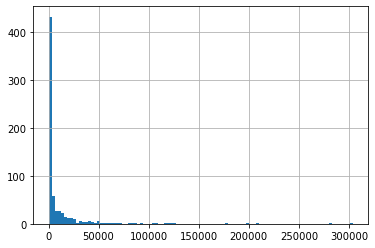

In [10]:
cities.img_count.hist(bins=100)

In [38]:
cities[cities['city'] == 'Baku']

,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent,koppen_geiger_zone,zone_description,img_count
227,Baku,Baku,1031946365,40.3667,49.8352,Azerbaijan,AZ,AZE,Bakı,primary,2181800.0,Asia,BSk,Mid-latitude steppe,29290


In [20]:
selected_cities = cities[(cities['img_count'] >= 8000) & (cities['img_count'] <= 10000) & (cities['capital'] == 'primary')].groupby('continent').apply(lambda x: x.sample(n=1, random_state=3))
selected_cities

,,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent,koppen_geiger_zone,zone_description,img_count
continent,,,,,,,,,,,,,,,,
Asia,414,Al Quds,Al Quds,1934000006,31.7764,35.2269,West Bank,XW,XWB,NaN,primary,NaN,Asia,Csa,"Mediterranean, hot summer",9543
North America,660,Kingstown,Kingstown,1670376659,13.1667,-61.2333,Saint Vincent And The Grenadines,VC,VCT,Saint George,primary,25000.0,North America,Af,Tropical rainforest,8185
Oceania,382,Canberra,Canberra,1036142029,-35.2931,149.1269,Australia,AU,AUS,Australian Capital Territory,primary,381488.0,Oceania,Cfb,"Marine west coast, warm summer",8199


In [24]:
selected_cities = cities[(cities['img_count'] >= 5000) & (cities['capital'] == 'primary')].groupby('continent').apply(lambda x: x.sample(n=1, random_state=0))
selected_cities

,,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent,koppen_geiger_zone,zone_description,img_count
continent,,,,,,,,,,,,,,,,
Africa,305,Rabat,Rabat,1504023252,34.0253,-6.8361,Morocco,MA,MAR,Rabat-Salé-Kénitra,primary,572717.0,Africa,Csa,"Mediterranean, hot summer",12185
Asia,341,Tokyo,Tokyo,1392685764,35.6839,139.7744,Japan,JP,JPN,Tōkyō,primary,39105000.0,Asia,Cfa,"Humid subtropical, no dry season",65040
Europe,396,Budapest,Budapest,1348611435,47.4983,19.0408,Hungary,HU,HUN,Budapest,primary,1723836.0,Europe,Cfb,"Marine west coast, warm summer",177050
North America,668,Fort-de-France,Fort-de-France,1474969110,14.6104,-61.0800,Martinique,MQ,MTQ,NaN,primary,253995.0,North America,Af,Tropical rainforest,13388
Oceania,399,Wellington,Wellington,1554772152,-41.2889,174.7772,New Zealand,NZ,NZL,Wellington,primary,418500.0,Oceania,Cfb,"Marine west coast, warm summer",23139
South America,348,Asunción,Asuncion,1600057911,-25.3000,-57.6333,Paraguay,PY,PRY,Asunción,primary,524190.0,South America,Cfa,"Humid subtropical, no dry season",37687


In [ ]:
# Wellington, Singapore, Rabat, Washington, Zagreb, Asunción, Ulaanbaatar, Baku

In [42]:
ls_cities = ['Wellington', 'Singapore', 'Dodoma', 'Washington', 'Zagreb', 'Asunción', 'Ulaanbaatar', 'Baku']
selected_cities = cities[cities['city'].isin(ls_cities)].reset_index(drop=True)
selected_cities

,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent,koppen_geiger_zone,zone_description,img_count
0,Baku,Baku,1031946365,40.3667,49.8352,Azerbaijan,AZ,AZE,Bakı,primary,2181800.0,Asia,BSk,Mid-latitude steppe,29290
1,Zagreb,Zagreb,1191233290,45.8131,15.9772,Croatia,HR,HRV,"Zagreb, Grad",primary,790017.0,Europe,Cfb,"Marine west coast, warm summer",34100
2,Ulaanbaatar,Ulaanbaatar,1496024767,47.9214,106.9055,Mongolia,MN,MNG,Ulaanbaatar,primary,1396288.0,Asia,BSk,Mid-latitude steppe,11131
3,Washington,Washington,1840006060,38.9047,-77.0163,United States,US,USA,District of Columbia,primary,5379184.0,North America,Cfa,"Humid subtropical, no dry season",207103
4,Asunción,Asuncion,1600057911,-25.3000,-57.6333,Paraguay,PY,PRY,Asunción,primary,524190.0,South America,Cfa,"Humid subtropical, no dry season",37687
5,Singapore,Singapore,1702341327,1.3000,103.8000,Singapore,SG,SGP,Central Singapore,primary,5271000.0,Asia,Af,Tropical rainforest,23047
6,Wellington,Wellington,1554772152,-41.2889,174.7772,New Zealand,NZ,NZL,Wellington,primary,418500.0,Oceania,Cfb,"Marine west coast, warm summer",23139
7,Dodoma,Dodoma,1834288497,-6.1835,35.7460,Tanzania,TZ,TZA,Dodoma,primary,410956.0,Africa,BSh,Subtropical steppe,25858


In [43]:
selected_cities.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/selected_cities.csv')

# Read & merge data

In [75]:
# city info
sm = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/simplemaps.csv').drop(columns=['Unnamed: 0'])[['uuid', 'source', 'orig_id', 'city_id']]
# pano
pano = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/pano.csv').drop(columns=['Unnamed: 0'])
# transportation mode
tm = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/transportation_mode.csv').drop(columns=['Unnamed: 0'])[['uuid', 'sequenceIndex', 'sequenceId', 'speed_seq_kph', 'transportation_mode', 'seq_img_count']]
# osm
osm = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/osm.csv').drop(columns=['Unnamed: 0'])[['uuid', 'highway', 'type_highway']]
# segmentation 
seg = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/segmentation.csv').drop(columns=['Unnamed: 0'])
# perception
perc = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/perception.csv').drop(columns=['Unnamed: 0', 'source', 'orig_id'])
# season
season = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/season.csv').drop(columns=['Unnamed: 0', 'source', 'orig_id'])
# time of day
ephem = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/ephem.csv').drop(columns=['Unnamed: 0', 'source', 'orig_id', 'timezone', 'utc_offset_s'])


/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (13) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (5) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (9,14,15,19,24,25,26) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [76]:
sm = sm[sm['city_id'].isin(selected_cities.city_id)]
sm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 391355 entries, 1876652 to 7043603
Data columns (total 4 columns):
 #   Column   Non-Null Count   Dtype 
---  ------   --------------   ----- 
 0   uuid     391355 non-null  object
 1   source   391355 non-null  object
 2   orig_id  391355 non-null  int64 
 3   city_id  391355 non-null  int64 
dtypes: int64(2), object(2)
memory usage: 14.9+ MB


In [77]:
data = sm.merge(pano, on='uuid', how='left')
data = data.merge(tm, on='uuid', how='left')
data = data.merge(osm, on='uuid', how='left')
data = data.merge(seg, on='uuid', how='left')
data = data.merge(perc, on='uuid', how='left')
data = data.merge(season, on='uuid', how='left')
data = data.merge(ephem, on='uuid', how='left')
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 391355 entries, 0 to 391354
Data columns (total 98 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   uuid                      391355 non-null  object 
 1   source                    391355 non-null  object 
 2   orig_id                   391355 non-null  int64  
 3   city_id                   391355 non-null  int64  
 4   pano_status               386134 non-null  object 
 5   sequenceIndex             391355 non-null  int64  
 6   sequenceId                391355 non-null  object 
 7   speed_seq_kph             390960 non-null  float64
 8   transportation_mode       390960 non-null  object 
 9   seq_img_count             391355 non-null  int64  
 10  highway                   382270 non-null  object 
 11  type_highway              379509 non-null  object 
 12  Bird                      335379 non-null  float64
 13  Ground-Animal             335379 non-null  f

In [49]:
cities_addon = pd.read_csv('/Users/yujun/Data/global_streetscapes/addon/cities_addon.csv').drop(columns=['Unnamed: 0'])
selected_cities[selected_cities['city_id'].isin(cities_addon.id)]

,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent,koppen_geiger_zone,zone_description,img_count
1,Zagreb,Zagreb,1191233290,45.8131,15.9772,Croatia,HR,HRV,"Zagreb, Grad",primary,790017.0,Europe,Cfb,"Marine west coast, warm summer",34100
2,Ulaanbaatar,Ulaanbaatar,1496024767,47.9214,106.9055,Mongolia,MN,MNG,Ulaanbaatar,primary,1396288.0,Asia,BSk,Mid-latitude steppe,11131
3,Washington,Washington,1840006060,38.9047,-77.0163,United States,US,USA,District of Columbia,primary,5379184.0,North America,Cfa,"Humid subtropical, no dry season",207103
4,Asunción,Asuncion,1600057911,-25.3000,-57.6333,Paraguay,PY,PRY,Asunción,primary,524190.0,South America,Cfa,"Humid subtropical, no dry season",37687
5,Singapore,Singapore,1702341327,1.3000,103.8000,Singapore,SG,SGP,Central Singapore,primary,5271000.0,Asia,Af,Tropical rainforest,23047
6,Wellington,Wellington,1554772152,-41.2889,174.7772,New Zealand,NZ,NZL,Wellington,primary,418500.0,Oceania,Cfb,"Marine west coast, warm summer",23139
7,Dodoma,Dodoma,1834288497,-6.1835,35.7460,Tanzania,TZ,TZA,Dodoma,primary,410956.0,Africa,BSh,Subtropical steppe,25858


In [79]:
selected_cities[selected_cities['city_id'].isin(cities_addon.id)].img_count.sum()

362065

In [82]:
pd.set_option('display.max_columns', None)
data[data['Total'] == 0]

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour
73594,f1a4206a-3371-429a-863c-7f567a0e0b28,Mapillary,634592981401049,1840006060,False,155,L92bGkyMehuv0ATmVWl1fi,25.844653,driving,383,secondary,for driving,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f1a4206a-3371-429a-863c-7f567a0e0b28.jpeg,2.59,1.72,3.98,1.29,1.61,1.95,38.899909,-77.031932,2021-12-15 04:14:21-05:00,Cfa,"Humid subtropical, no dry season",Winter,night,-3.09,NaN,2021,12,15,4
75633,32b7f24d-bc10-4821-84cd-405f0ee23c17,Mapillary,364013441887060,1840006060,False,729,8f0b5tv3o9qf7ot4spdb03,15.646432,driving,274,footway,for walking,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,32b7f24d-bc10-4821-84cd-405f0ee23c17.jpeg,2.18,5.71,4.67,3.20,7.77,4.14,38.904292,-77.021987,2019-12-24 10:05:34.299000-05:00,Cfa,"Humid subtropical, no dry season",Winter,day,2.69,NaN,2019,12,24,10
76974,6f9d8559-a0a9-450e-8648-b25d3de0555f,Mapillary,819456968738581,1840006060,False,152,r6nzr2eayo35zbxtaw89bs,13.630298,cycling,500,footway,for walking,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6f9d8559-a0a9-450e-8648-b25d3de0555f.jpeg,2.10,0.53,7.77,0.40,0.15,0.79,38.891993,-77.017341,2019-08-16 10:50:15-04:00,Cfa,"Humid subtropical, no dry season",Summer,day,4.46,NaN,2019,8,16,10
77617,36380ea8-a122-4dfc-9fe0-218eae723041,Mapillary,386234742900383,1840006060,False,340,5vzisy7jhf37jwuhvn7t83,15.821759,driving,208,secondary,for driving,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,36380ea8-a122-4dfc-9fe0-218eae723041.jpeg,2.80,5.70,4.94,1.71,6.62,5.54,38.905486,-77.021874,2019-12-24 11:11:25.140000-05:00,Cfa,"Humid subtropical, no dry season",Winter,day,3.78,NaN,2019,12,24,11
77705,ab970f61-dd5f-4c91-8155-161218f69d4d,Mapillary,2902291173328127,1840006060,True,265,4hcmahvlcv3hadlxhl6521,17.012916,driving,433,primary,for driving,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,ab970f61-dd5f-4c91-8155-161218f69d4d.jpeg,3.85,1.11,6.22,4.78,3.52,4.18,38.897296,-77.023956,2019-09-16 11:02:12-04:00,C

In [84]:
data['green_view_index'] = data.apply(lambda x: x['Vegetation']/x['Total'] if x['Total'] != 0 else None, axis=1)
data['sky_view_factor'] = data.apply(lambda x: x['Sky']/x['Total'] if x['Total'] != 0 else None, axis=1)

In [87]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 391355 entries, 0 to 391354
Data columns (total 100 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   uuid                      391355 non-null  object 
 1   source                    391355 non-null  object 
 2   orig_id                   391355 non-null  int64  
 3   city_id                   391355 non-null  int64  
 4   pano_status               386134 non-null  object 
 5   sequenceIndex             391355 non-null  int64  
 6   sequenceId                391355 non-null  object 
 7   speed_seq_kph             390960 non-null  float64
 8   transportation_mode       390960 non-null  object 
 9   seq_img_count             391355 non-null  int64  
 10  highway                   382270 non-null  object 
 11  type_highway              379509 non-null  object 
 12  Bird                      335379 non-null  float64
 13  Ground-Animal             335379 non-null  

In [128]:
osm = 0
seg = 0
tm = 0
pano = 0
perc = 0
season = 0
ephem = 0

In [94]:
data['age_y'] = data.apply(lambda x: 2023 - x['year'], axis=1)
data.head()

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y
0,473d9cf1-1461-4a36-b62a-8d086611c0d4,Mapillary,935511007286293,1031946365,False,464,w3X5SPtLZYFdrKNlGoXFAA,5.423646,walking,334,trunk,for driving,0.0,0.0,22665.0,4365.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,431080.0,0.0,452715.0,0.0,46610.0,0.0,1065.0,0.0,0.0,0.0,1850.0,88920.0,0.0,0.0,485210.0,0.0,0.0,378525.0,8775.0,990.0,0.0,0.0,180.0,3385.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2635.0,26170.0,0.0,0.0,0.0,0.0,30165.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1985305.0,473d9cf1-1461-4a36-b62a-8d086611c0d4.jpeg,3.76,5.23,5.37,7.89,5.99,4.76,40.373461,49.850598,2015-01-31 15:57:41+04:00,BSk,Mid-latitude steppe,Winter,day,NaN,-1.99,2015,1,31,15,0.190663,0.244401,8
1,dfc2dde8-67a9-4b8c-ac13-2ad8d84b714a,Mapillary,194336219193996,1031946365,False,435,GZyMn2Qvz0MnmFWpXGgkZQ,5.641219,walking,438,footway,for walking,0.0,0.0,0.0,0.0,0.0,0.0,3555.0,0.0,0.0,0.0,0.0,37095.0,0.0,451660.0,0.0,0.0,0.0,653340.0,0.0,375580.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,78040.0,0.0,0.0,89385.0,0.0,4775.0,0.0,0.0,9690.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,308835.0,0.0,0.0,0.0,0.0,0.0,670.0,0.0,0.0,0.0,2012625.0,dfc2dde8-67a9-4b8c-ac13-2ad8d84b714a.jpeg,5.24,6.98,1.22,3.71,2.75,9.44,40.369309,49.837300,2015-01-28 17:27:30+04:00,BSk,Mid-latitude steppe,Winter,day,NaN,-0.43,2015,1,28,17,0.044412,0.038775,8
2,e0cc056f-d3b7-44be-b6b4-20ba72a2090c,Mapillary,3969632146431336,1031946365,False,70,ekpmhQXaX2icQrAKujF0jg,5.961170,walking,468,"['footway', 'residential']",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,335.0,0.0,0.0,436145.0,0.0,1920.0,0.0,372375.0,0.0,105985.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,40545.0,0.0,0.0,445735.0,0.0,5335.0,0.0,0.0,57125.0,0.0,0.0,0.0,0.0,0.0,19275.0,0.0,0.0,0.0,205.0,0.0,0.0,0.0,0.0,2660.0,0.0,0.0,0.0,0.0,551510.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2039150.0,e0cc056f-d3b7-44be-b6b4-20ba72a2090c.jpeg,8.12,2.33,3.17,9.29,7.95,6.85,40.370842,49.838249,2015-01-28 16:58:18+04:00,BSk,Mid-latitude steppe,Winter,day,NaN,-0.92,2015,1,28,16,0.218589,0.019883,8
3,939beda8-4477-40a9-ae73-68ab06022906,Mapillary,851295529069490,1031946365,False,34,Lh7-3OS9dJnNhb_rT44vVg,3.950395,walking,48,footway,for walking,0.0,0.0,5590.0,2978.0,0.0,0.0,31386.0,0.0,0.0,0.0,0.0,24225.0,0.0,449310.0,0.0,0.0,0.0,320.0,0.0,2063.0,0.0,0.0,0.0,0.0,44733.0,0.0,0.0,109917.0,0.0,6323.0,1165789.0,0.0,0.0,16697.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1193.0,0.0,0.0,5432.0,31496.0,0.0,0.0,0.0,0.0,0.0,3177.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1900629.0,939beda8-4477-40a9-ae73-68ab06022906.jpeg,8.76,2.59,2.32,3.99,3.07,8.86,40.366329,49.839231,2015-01-17 12:12:19+04:00,BSk,Mid-latitude steppe,Winter,day,4.19,NaN,2015,1,17,12,0.613370,0.057832,8
4,7a35157d-3c02-4340-94d2-fefc6cd196f0,Mapillary,760284241351574,1031946365,False,47,3buqPNreOihzNPhFX8p5eg,4.711669,walking,142,footway,for walking,0.0,0.0,4069.0,2085.0,0.0,343947.0,12430.0,0.0,0.0,0.0,0.0,2621.0,0.0,142244.0,0.0,0.0,0.0,13226.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5

In [97]:
data.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 391355 entries, 0 to 391354
Data columns (total 101 columns):
 #    Column                    Non-Null Count   Dtype  
---   ------                    --------------   -----  
 0    uuid                      391355 non-null  object 
 1    source                    391355 non-null  object 
 2    orig_id                   391355 non-null  int64  
 3    city_id                   391355 non-null  int64  
 4    pano_status               386134 non-null  object 
 5    sequenceIndex             391355 non-null  int64  
 6    sequenceId                391355 non-null  object 
 7    speed_seq_kph             390960 non-null  float64
 8    transportation_mode       390960 non-null  object 
 9    seq_img_count             391355 non-null  int64  
 10   highway                   382270 non-null  object 
 11   type_highway              379509 non-null  object 
 12   Bird                      335379 non-null  float64
 13   Ground-Animal             3

In [98]:
data.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/data.csv')

In [89]:
selected_cities

,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent,koppen_geiger_zone,zone_description,img_count
0,Baku,Baku,1031946365,40.3667,49.8352,Azerbaijan,AZ,AZE,Bakı,primary,2181800.0,Asia,BSk,Mid-latitude steppe,29290
1,Zagreb,Zagreb,1191233290,45.8131,15.9772,Croatia,HR,HRV,"Zagreb, Grad",primary,790017.0,Europe,Cfb,"Marine west coast, warm summer",34100
2,Ulaanbaatar,Ulaanbaatar,1496024767,47.9214,106.9055,Mongolia,MN,MNG,Ulaanbaatar,primary,1396288.0,Asia,BSk,Mid-latitude steppe,11131
3,Washington,Washington,1840006060,38.9047,-77.0163,United States,US,USA,District of Columbia,primary,5379184.0,North America,Cfa,"Humid subtropical, no dry season",207103
4,Asunción,Asuncion,1600057911,-25.3000,-57.6333,Paraguay,PY,PRY,Asunción,primary,524190.0,South America,Cfa,"Humid subtropical, no dry season",37687
5,Singapore,Singapore,1702341327,1.3000,103.8000,Singapore,SG,SGP,Central Singapore,primary,5271000.0,Asia,Af,Tropical rainforest,23047
6,Wellington,Wellington,1554772152,-41.2889,174.7772,New Zealand,NZ,NZL,Wellington,primary,418500.0,Oceania,Cfb,"Marine west coast, warm summer",23139
7,Dodoma,Dodoma,1834288497,-6.1835,35.7460,Tanzania,TZ,TZA,Dodoma,primary,410956.0,Africa,BSh,Subtropical steppe,25858


In [99]:
baku = data[data['city_id'] == 1031946365]
zagreb = data[data['city_id'] == 1191233290]
ulaanbaatar = data[data['city_id'] == 1496024767]
washington = data[data['city_id'] == 1840006060]
asuncion = data[data['city_id'] == 1600057911]
singapore = data[data['city_id'] == 1702341327]
wellington = data[data['city_id'] == 1554772152]
dodoma = data[data['city_id'] == 1834288497]

In [100]:
baku.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/cities/baku.csv')
zagreb.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/cities/zagreb.csv')
ulaanbaatar.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/cities/ulaanbaatar.csv')
washington.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/cities/washington.csv')
asuncion.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/cities/asuncion.csv')
singapore.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/cities/singapore.csv')
wellington.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/cities/wellington.csv')
dodoma.to_csv('/Users/yujun/Data/global_streetscapes/use_cases/cities/dodoma.csv')

In [57]:
baku

,uuid,source,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,...,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour
0,473d9cf1-1461-4a36-b62a-8d086611c0d4,Mapillary,1031946365,False,464,w3X5SPtLZYFdrKNlGoXFAA,5.423646,walking,334,trunk,...,BSk,Mid-latitude steppe,Winter,day,NaN,-1.99,2015,1,31,15
1,dfc2dde8-67a9-4b8c-ac13-2ad8d84b714a,Mapillary,1031946365,False,435,GZyMn2Qvz0MnmFWpXGgkZQ,5.641219,walking,438,footway,...,BSk,Mid-latitude steppe,Winter,day,NaN,-0.43,2015,1,28,17
2,e0cc056f-d3b7-44be-b6b4-20ba72a2090c,Mapillary,1031946365,False,70,ekpmhQXaX2icQrAKujF0jg,5.961170,walking,468,"['footway', 'residential']",...,BSk,Mid-latitude steppe,Winter,day,NaN,-0.92,2015,1,28,16
3,939beda8-4477-40a9-ae73-68ab06022906,Mapillary,1031946365,False,34,Lh7-3OS9dJnNhb_rT44vVg,3.950395,walking,48,footway,...,BSk,Mid-latitude steppe,Winter,day,4.19,NaN,2015,1,17,12
4,7a35157d-3c02-4340-94d2-fefc6cd196f0,Mapillary,1031946365,False,47,3buqPNreOihzNPhFX8p5eg,4.711669,walking,142,footway,...,BSk,Mid-latitude steppe,Winter,day,NaN,-3.60,2015,1,12,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
364250,d68dbd52-941d-4101-a596-5b0bbc4ed805,KartaView,1031946365,False,191,3092430,15.316500,driving,50,primary,...,BSk,Mid-latitude steppe,Summer,night,NaN,2.78,2019,6,12,22
364251,fad2b921-8985-4bec-a523-0b9e8065f30c,KartaView,1031946365,False,192,3092430,15.316500,driving,50,primary,...,BSk,Mid-latitude steppe,Summer,night,NaN,2.79,2019,6,12,22
364252,703a0625-8dbf-4e2f-bd47-b10734797cc1,KartaView,1031946365,False,193,3092430,15.316500,driving,50,primary,...,BSk,Mid-latitude steppe,Summer,night,NaN,2.79,2019,6,12,22
364253,df8e3c38-738e-4666-9c54-2f2bba4383d1,KartaView,1031946365,False,194,3092430,15.316500,driving,50,primary,...,BSk,Mid-latitude steppe,Summer,night,NaN,2.79,2019,6,12,22


In [56]:
seg = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/segmentation.csv').drop(columns=['Unnamed: 0'])
seg[seg['uuid'].isin(baku.uuid)]

,uuid,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total


In [59]:
seg['uuid'] = seg['uuid'].apply(lambda x: x.split('.')[0])

In [60]:
seg

,uuid,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total
0,fd230af3-411d-434c-b0e3-c43639c0274d,0,0,16555,7025,0,45425,6845,0,0,...,0,0,0,0,0,0,0,0,0,2027560
1,5b6da398-f44e-49fe-96d8-9c1f229a156b,0,0,107548,3492,0,0,79008,0,0,...,0,363912,0,0,0,492,0,0,0,3059196
2,483b30a7-9a77-432b-bd74-ccb77922c3dd,0,0,6599,34335,0,107800,0,0,0,...,0,0,0,0,0,0,0,7914,551812,2313255
3,1ab32a4a-81d0-4a4d-8691-13aa8a6aaceb,0,0,3585,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2071720
4,9f5bcfa8-2700-4cda-80c9-8034dfa8316a,0,0,2463,0,0,0,0,0,0,...,0,6150,0,8385,0,0,0,0,630794,2024323
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6251866,d71cf262-6fe4-4f74-a4c4-964c11d056ac,0,0,0,165496,0,0,0,0,0,...,0,0,0,0,0,4736,0,0,0,3018800
6251867,212296b4-e8c9-4e37-b024-94fab909227e,0,0,24303,420477,10731,259323,0,0,0,...,0,0,0,0,0,0,0,0,22200,2332017
6251868,66de649b-c891-48c6-adf4-7e81800f9445,0,0,5620,0,0,0,0,289015,0,...,0,0,0,0,0,0,0,0,0,2051150
6251869,f559f0f2-cff9-49be-afdb-1b58d0573722,0,0,5120,132945,0,0,37570,0,0,...,0,0,0,0,0,0,0,8200,0,2037730


In [61]:
seg.to_csv('/Users/yujun/Data/global_streetscapes/all/tables/segmentation.csv')

In [63]:
ins = pd.read_csv('/Users/yujun/Data/global_streetscapes/all/tables/instances.csv').drop(columns=['Unnamed: 0'])
ins.head()

,uuid,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle
0,877cf78b-a9af-47d8-9b6b-6a8e2714c17d.jpeg,0,0,1,1,0,0,0,0,0,...,3,0,0,0,0,0,0,0,0,0
1,a49c6604-c713-42e9-af4b-1780ebe492a8.jpeg,0,0,1,0,0,0,1,0,0,...,4,0,0,0,0,0,1,0,0,0
2,b8686d18-e1a6-4769-a6fa-2e420b7fc0f3.jpeg,0,0,1,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,2
3,ea5fa0e3-0a39-4604-ada6-13229d56f6f7.jpeg,0,0,1,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
4,89be9593-8a82-4bab-98fd-0768c0ed2945.jpeg,0,0,1,0,0,0,1,0,0,...,6,0,0,0,0,0,0,0,0,1


In [64]:
ins['uuid'] = ins['uuid'].apply(lambda x: x.split('.')[0])

In [65]:
ins.head()

,uuid,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,...,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle
0,877cf78b-a9af-47d8-9b6b-6a8e2714c17d,0,0,1,1,0,0,0,0,0,...,3,0,0,0,0,0,0,0,0,0
1,a49c6604-c713-42e9-af4b-1780ebe492a8,0,0,1,0,0,0,1,0,0,...,4,0,0,0,0,0,1,0,0,0
2,b8686d18-e1a6-4769-a6fa-2e420b7fc0f3,0,0,1,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,2
3,ea5fa0e3-0a39-4604-ada6-13229d56f6f7,0,0,1,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
4,89be9593-8a82-4bab-98fd-0768c0ed2945,0,0,1,0,0,0,1,0,0,...,6,0,0,0,0,0,0,0,0,1


In [66]:
ins.to_csv('/Users/yujun/Data/global_streetscapes/all/tables/instances.csv')

In [101]:
zagreb.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 34100 entries, 28784 to 391354
Data columns (total 101 columns):
 #    Column                    Non-Null Count  Dtype  
---   ------                    --------------  -----  
 0    uuid                      34100 non-null  object 
 1    source                    34100 non-null  object 
 2    orig_id                   34100 non-null  int64  
 3    city_id                   34100 non-null  int64  
 4    pano_status               33778 non-null  object 
 5    sequenceIndex             34100 non-null  int64  
 6    sequenceId                34100 non-null  object 
 7    speed_seq_kph             34002 non-null  float64
 8    transportation_mode       34002 non-null  object 
 9    seq_img_count             34100 non-null  int64  
 10   highway                   32501 non-null  object 
 11   type_highway              32124 non-null  object 
 12   Bird                      28888 non-null  float64
 13   Ground-Animal             28888 non-nul

# Visualise

In [4]:
import geopandas as gp
data_path = '/Users/yujun/Data/global_streetscapes/use_cases/cities'
data_dict = {}
for file in os.listdir(data_path):
    if file == '.DS_Store':
        continue
    # if file == 'singapore.csv':
    #     continue
    fname = file.split('.')[0]
    if file == 'singapore_clipped.csv':
        continue
        #fname = file.split('_')[0]
    fpath = os.path.join(data_path, file)
    df = pd.read_csv(fpath).drop(columns=['Unnamed: 0'])
    gdf = gp.GeoDataFrame(df, geometry=gp.points_from_xy(df.lon, df.lat), crs="EPSG:4326")
    data_dict[fname] = gdf
print(len(data_dict))

/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (7) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (7) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


8


In [37]:
data_dict['singapore'].info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 22579 entries, 0 to 22578
Data columns (total 102 columns):
 #    Column                    Non-Null Count  Dtype   
---   ------                    --------------  -----   
 0    uuid                      22579 non-null  object  
 1    source                    22579 non-null  object  
 2    orig_id                   22579 non-null  int64   
 3    city_id                   22579 non-null  int64   
 4    pano_status               21774 non-null  object  
 5    sequenceIndex             22579 non-null  int64   
 6    sequenceId                22579 non-null  object  
 7    speed_seq_kph             22517 non-null  float64 
 8    transportation_mode       22517 non-null  object  
 9    seq_img_count             22579 non-null  int64   
 10   highway                   21920 non-null  object  
 11   type_highway              21673 non-null  object  
 12   Bird                      20645 non-null  float64 
 13   Ground-Animal        

In [38]:
attributes = ['source', 'pano_status', 'speed_seq_kph', 'type_highway', 'green_view_index', 'sky_view_factor', 'Beautiful', 'Safe', 'season', 'hour', 'age_y']

In [39]:
city_names = list(data_dict.keys())
city_names

['zagreb',
 'asuncion',
 'singapore',
 'wellington',
 'baku',
 'dodoma',
 'ulaanbaatar',
 'washington']

In [40]:
for i, a in enumerate(attributes):
    print(i, a)

0 source
1 pano_status
2 speed_seq_kph
3 type_highway
4 green_view_index
5 sky_view_factor
6 Beautiful
7 Safe
8 season
9 hour
10 age_y


In [41]:
for a in attributes:
    print(data_dict['zagreb'][a].dtype)

object
object
float64
object
float64
float64
float64
float64
object
int64
int64


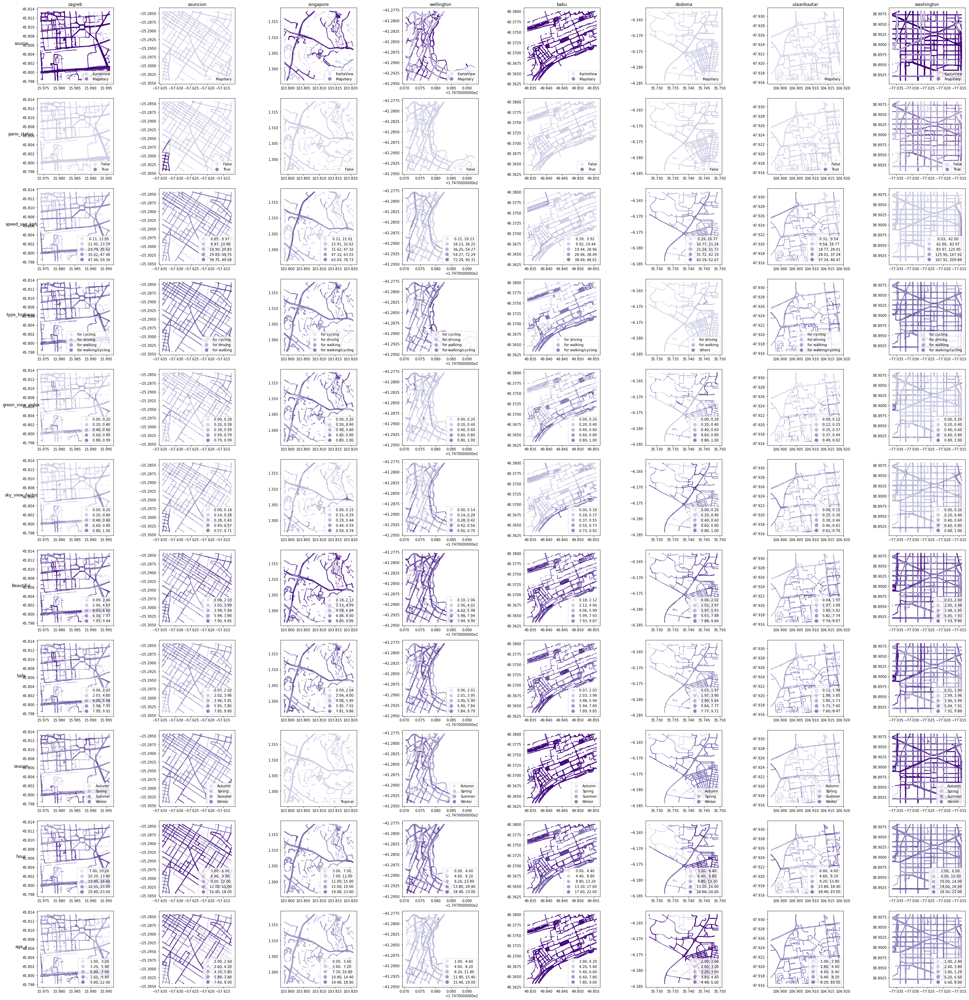

In [86]:
import numpy as np
import matplotlib

min_val, max_val = 0.3,1.0
n = 10
orig_cmap = plt.cm.Purples
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# Create a grid for the plots
fig, axes = plt.subplots(len(attributes), len(data_dict), figsize=(40, 40))

# Plot data for each attribute in a grid with the corrected order
for row, attribute in enumerate(attributes):
    for col, (city, gdf) in enumerate(data_dict.items()):
        #print(city)

        #axes[row, col].set_facecolor('black')
        if gdf[attribute].dtype == 'object':
            gdf.plot(ax=axes[row, col], 
                     column=attribute, 
                     cmap=cmap,
                     alpha=0.5, 
                     markersize=0.5,
                     legend=True,
                     legend_kwds={'loc':'lower right'})
        else:
            gdf.plot(ax=axes[row, col], 
              column=attribute, 
              scheme='equal_interval', 
              cmap=cmap,
              k=5, 
              alpha=0.5, 
              markersize=0.5,
              legend=True,
              legend_kwds={'loc':'lower right'})

        #gdf[gdf['source'] == 'Mapillary'].plot(ax=axes[row, col], marker='o', color='green', markersize=2, alpha=0.7)
        #gdf[gdf['source'] == 'KartaView'].plot(ax=axes[row, col], marker='o', color='purple', markersize=2, alpha=0.7)

        # Set title and labels

for ax, col in zip(axes[0], city_names):
    ax.set_title(col)

for ax, row in zip(axes[:,0], attributes):
    ax.set_ylabel(row, rotation=0, size='large')

# Adjust layout and display
plt.tight_layout()
plt.show()


<AxesSubplot:>

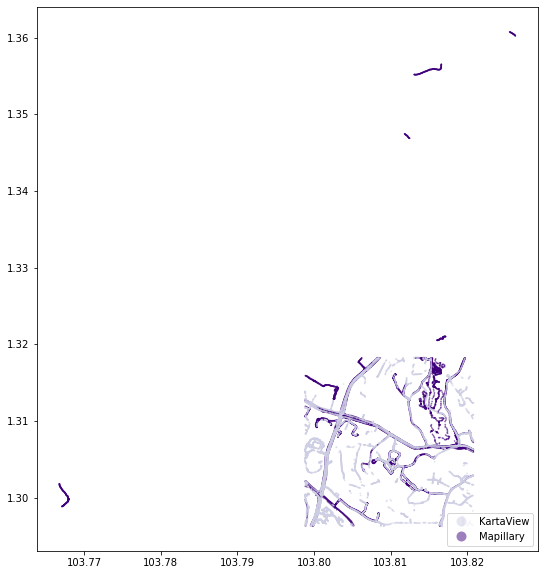

In [6]:
import numpy as np
import matplotlib

min_val, max_val = 0.3,1.0
n = 10
orig_cmap = plt.cm.Purples
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

sg = data_dict['singapore']
fig, ax = plt.subplots(figsize=(10, 10))
sg.plot(ax=ax,
     column='source', 
     cmap=cmap,
     alpha=0.5, 
     markersize=0.5,
     legend=True,
     legend_kwds={'loc':'lower right'})

In [28]:
sg_seg = sg[~sg['green_view_index'].isnull()]
sg_seg.total_bounds

array([103.79882812,   1.296277  , 103.8208    ,   1.31824306])

In [29]:
sg_seg.total_bounds[1]

1.296277

In [30]:
from shapely.geometry import box
sg_box = box(sg_seg.total_bounds[0], sg_seg.total_bounds[1], sg_seg.total_bounds[2], sg_seg.total_bounds[3])

In [31]:
sg_clipped = sg.clip(sg_box)

<AxesSubplot:>

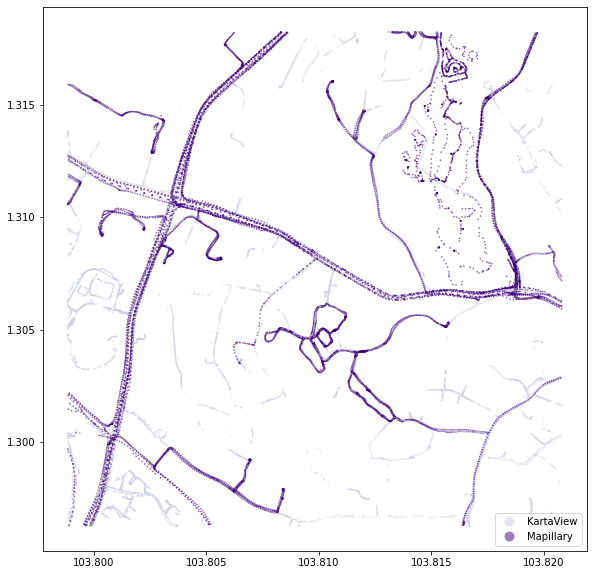

In [32]:
fig, ax = plt.subplots(figsize=(10, 10))
sg_clipped.plot(ax=ax,
     column='source', 
     cmap=cmap,
     alpha=0.5, 
     markersize=0.5,
     legend=True,
     legend_kwds={'loc':'lower right'})

In [33]:
data_dict['singapore'] = sg_clipped

In [34]:
data_dict['singapore'].to_csv('/Users/yujun/Data/global_streetscapes/use_cases/cities/singapore_clipped.csv')

# Check data availability across different years

<AxesSubplot:>

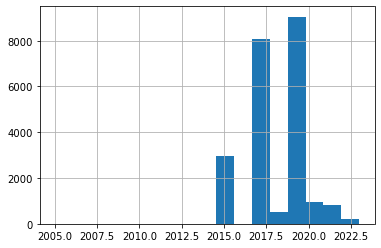

In [166]:
data_dict['singapore'].year.hist(bins=17)

In [163]:
data_dict['singapore'].year.value_counts()

2019    9049
2017    8059
2015    2953
2020     968
2021     836
2018     495
2023     121
2022      96
2005       1
2008       1
Name: year, dtype: int64

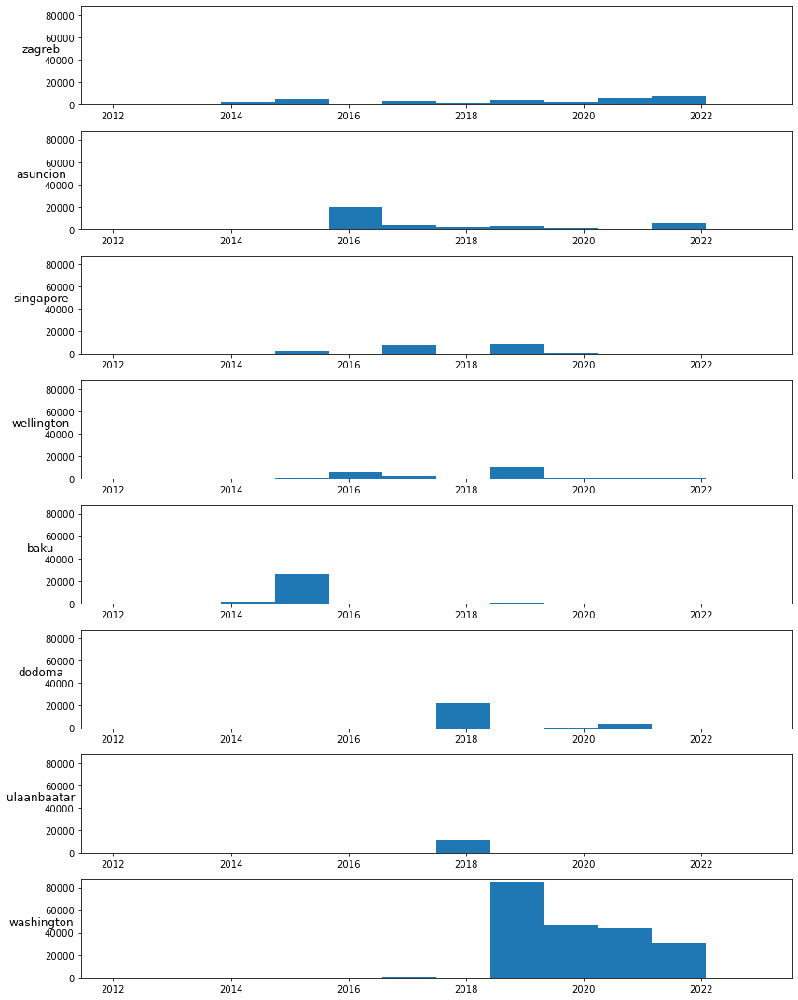

In [85]:
import numpy as np
import matplotlib

# Create a grid for the plots
fig, axes = plt.subplots(len(data_dict), 1, figsize=(12, 15))

# Plot data for each attribute in a grid with the corrected order
for row, (city, gdf) in enumerate(data_dict.items()):
    #print(city)

    #axes[row, col].set_facecolor('black')
    axes[row].hist(gdf.year, bins=12, range=[2012, 2023])
    axes[row].set_ylim([0,88000])
    #gdf[gdf['source'] == 'Mapillary'].plot(ax=axes[row, col], marker='o', color='green', markersize=2, alpha=0.7)
    #gdf[gdf['source'] == 'KartaView'].plot(ax=axes[row, col], marker='o', color='purple', markersize=2, alpha=0.7)

    # Set title and labels

for ax, row in zip(axes, city_names):
    ax.set_ylabel(row, rotation=0, size='large')

# Adjust layout and display
plt.tight_layout()
plt.show()


In [52]:
data_dict['zagreb'].year.value_counts()
# 2015 - 2022

2022    7525
2021    6097
2015    4793
2019    4569
2017    3206
2014    2791
2020    2407
2018    1787
2016     917
2011       8
Name: year, dtype: int64

In [51]:
data_dict['asuncion'].year.value_counts()
# 2016 - 2022

2016    20242
2022     6134
2017     3831
2019     2920
2018     2645
2020     1749
2015      111
2014       55
Name: year, dtype: int64

In [49]:
data_dict['singapore'].year.value_counts()
# 2017 - 2019

2019    9049
2017    8059
2015    2953
2020     968
2021     836
2018     495
2023     121
2022      96
2005       1
2008       1
Name: year, dtype: int64

In [53]:
data_dict['wellington'].year.value_counts()
# 2016 - 2019

2019    10454
2016     5605
2017     2271
2015     1392
2021     1250
2022     1111
2020      970
2014       70
2018       13
2004        3
Name: year, dtype: int64

In [55]:
data_dict['dodoma'].year.value_counts()
# 2018 - 2021

2018    22200
2021     3560
2020       98
Name: year, dtype: int64

In [56]:
data_dict['washington'].year.value_counts()
# 2019 - 2022

2019    84673
2020    46769
2021    44292
2022    30469
2017      678
2015      181
2016       41
Name: year, dtype: int64

In [54]:
data_dict['baku'].year.value_counts()

2015    26716
2014     1225
2019      796
2018      218
2020      150
2017      139
2016       46
Name: year, dtype: int64

In [50]:
data_dict['ulaanbaatar'].year.value_counts()

2018    10739
2013      132
2017      130
2019       83
2022       44
2021        2
2016        1
Name: year, dtype: int64

# H3

In [57]:
df_h3 = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities677/tables/h3.csv').drop(columns=['Unnamed: 0'])

In [58]:
df_h3.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7127577 entries, 0 to 7127576
Data columns (total 19 columns):
 #   Column   Non-Null Count    Dtype 
---  ------   --------------    ----- 
 0   uuid     7127577 non-null  object
 1   source   7127577 non-null  object
 2   orig_id  7127577 non-null  int64 
 3   h3_0     7127577 non-null  object
 4   h3_1     7127577 non-null  object
 5   h3_2     7127577 non-null  object
 6   h3_3     7127577 non-null  object
 7   h3_4     7127577 non-null  object
 8   h3_5     7127577 non-null  object
 9   h3_6     7127577 non-null  object
 10  h3_7     7127577 non-null  object
 11  h3_8     7127577 non-null  object
 12  h3_9     7127577 non-null  object
 13  h3_10    7127577 non-null  object
 14  h3_11    7127577 non-null  object
 15  h3_12    7127577 non-null  object
 16  h3_13    7127577 non-null  object
 17  h3_14    7127577 non-null  object
 18  h3_15    7127577 non-null  object
dtypes: int64(1), object(18)
memory usage: 1.0+ GB


In [59]:
res = 10
h3_dict = {}
for city in data_dict.keys():
    df = data_dict[city].copy()
    df = df.merge(df_h3[['uuid', f'h3_{res}']], on='uuid', how='left')
    h3_dict[city] = df
print(len(h3_dict))

8


In [62]:
d = '/Users/yujun/Data/global_streetscapes/use_cases/cities'
for _, (city, df) in enumerate(h3_dict.items()):
    path = os.path.join(d, f"{city}_h3.csv")
    df.to_csv(path)

In [64]:
h3_dict['singapore'].h3_10.value_counts()

8a6520d9c92ffff    443
8a6520d9cb97fff    427
8a6520d9cba7fff    398
8a6520d9cb07fff    374
8a6520d8278ffff    359
                  ... 
8a6520d8272ffff      1
8a6520d83437fff      1
8a6520d82227fff      1
8a6520d9ccf7fff      1
8a6520d9c997fff      1
Name: h3_10, Length: 303, dtype: int64

In [63]:
import h3

In [67]:
h3.h3_to_geo_boundary('8a6520d9cba7fff', geo_json=True)

((103.80363374846362, 1.30768924793182),
 (103.80370521388964, 1.3084155121257388),
 (103.80311127323961, 1.308827779022843),
 (103.80244586608086, 1.308513778533605),
 (103.80237440301349, 1.307787511803895),
 (103.80296834474622, 1.3073752480991885),
 (103.80363374846362, 1.30768924793182))

In [74]:
from shapely.geometry import Polygon

h3s = {}
for _, (city, df) in enumerate(h3_dict.items()):
    ls_hex = df['h3_10'].unique().tolist()
    df_hex = pd.DataFrame(ls_hex, columns=['h3_10'])
    df_hex['geometry'] = [Polygon(h3.h3_to_geo_boundary(x, geo_json=True)) for x in df_hex['h3_10']]
    gdf = gp.GeoDataFrame(df_hex, crs="EPSG:4326")
    h3s[city] = gdf

In [75]:
h3s['singapore']

,h3_10,geometry
0,8a6520d9ccb7fff,"POLYGON ((103.81604 1.31770, 103.81611 1.31843..."
1,8a6520d9cc8ffff,"POLYGON ((103.81352 1.31790, 103.81359 1.31862..."
2,8a6520d9cc87fff,"POLYGON ((103.81478 1.31780, 103.81485 1.31852..."
3,8a6520d8279ffff,"POLYGON ((103.82022 1.30859, 103.82029 1.30932..."
4,8a6520d91b6ffff,"POLYGON ((103.82096 1.30963, 103.82103 1.31036..."
...,...,...
298,8a6520d83087fff,"POLYGON ((103.79931 1.29595, 103.79938 1.29668..."
299,8a6520d83cd7fff,"POLYGON ((103.80560 1.29546, 103.80567 1.29619..."
300,8a6520d83c97fff,"POLYGON ((103.80886 1.29630, 103.80893 1.29703..."
301,8a6520d8356ffff,"POLYGON ((103.80182 1.29576, 103.80190 1.29648..."


In [76]:
type(h3s['singapore'])

geopandas.geodataframe.GeoDataFrame

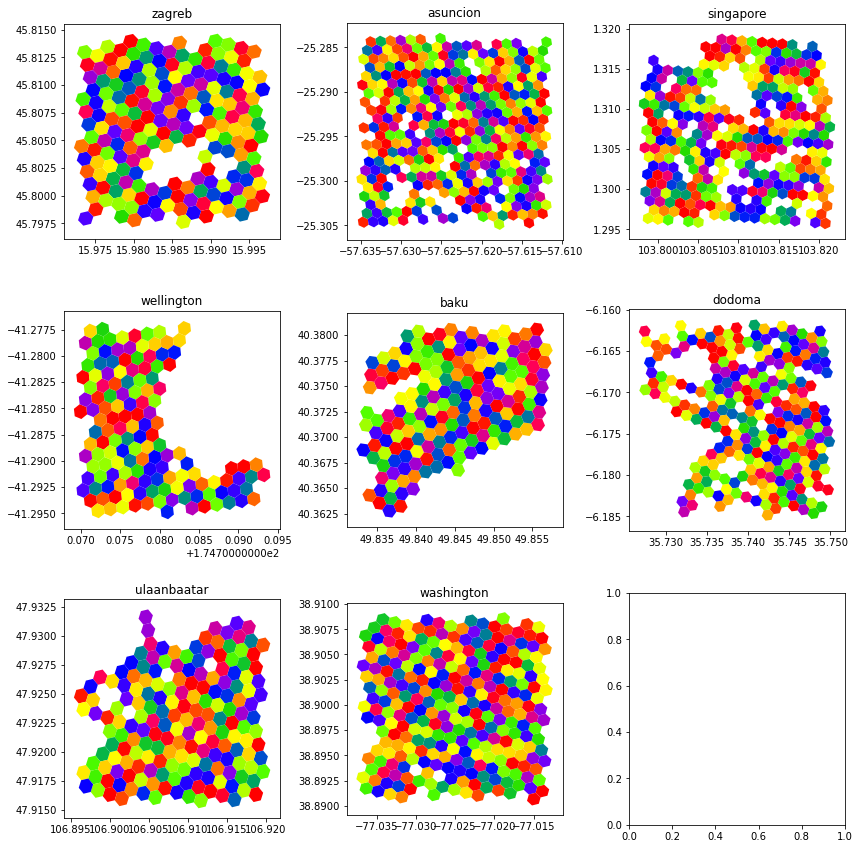

In [77]:
# Create a 3x3 grid for the plots
fig, axes = plt.subplots(3, 3, figsize=(12, 12))

# Plot data for each attribute in a 3x3 grid with the corrected order
for idx, (city, gdf) in enumerate(h3s.items()):
    row, col = divmod(idx, 3)
    gdf.plot(ax=axes[row, col], cmap='prism') 
    axes[row, col].set_title(f"{city}")

plt.tight_layout()
plt.show()


In [78]:
d = '/Users/yujun/Data/global_streetscapes/use_cases/cities'
for _, (city, df) in enumerate(h3s.items()):
    df_out = df.copy()
    df_out['wkt'] = df.geometry.to_wkt()
    path = os.path.join(d, f"{city}_h3_grid.csv")
    df_out.drop(columns=['geometry']).to_csv(path)

In [105]:
h3_dict['singapore'].groupby('h3_10')['green_view_index'].mean().to_frame().reset_index()

,h3_10,green_view_index
0,8a6520d82007fff,0.452226
1,8a6520d8200ffff,0.361338
2,8a6520d82017fff,0.314577
3,8a6520d8201ffff,0.360584
4,8a6520d82027fff,0.533113
...,...,...
298,8a6520d9cd97fff,0.712568
299,8a6520d9cd9ffff,0.682558
300,8a6520d9cda7fff,0.647804
301,8a6520d9cdaffff,0.580508


In [94]:
h3s['singapore']

,h3_10,geometry
0,8a6520d9ccb7fff,"POLYGON ((103.81604 1.31770, 103.81611 1.31843..."
1,8a6520d9cc8ffff,"POLYGON ((103.81352 1.31790, 103.81359 1.31862..."
2,8a6520d9cc87fff,"POLYGON ((103.81478 1.31780, 103.81485 1.31852..."
3,8a6520d8279ffff,"POLYGON ((103.82022 1.30859, 103.82029 1.30932..."
4,8a6520d91b6ffff,"POLYGON ((103.82096 1.30963, 103.82103 1.31036..."
...,...,...
298,8a6520d83087fff,"POLYGON ((103.79931 1.29595, 103.79938 1.29668..."
299,8a6520d83cd7fff,"POLYGON ((103.80560 1.29546, 103.80567 1.29619..."
300,8a6520d83c97fff,"POLYGON ((103.80886 1.29630, 103.80893 1.29703..."
301,8a6520d8356ffff,"POLYGON ((103.80182 1.29576, 103.80190 1.29648..."


In [114]:
h3_avg = {}
for _, (city, df) in enumerate(h3_dict.items()):
    df2 = df.copy()
    gvi_avg = df2.groupby('h3_10')['green_view_index'].mean().to_frame().reset_index().rename(columns={'green_view_index': 'green_view_index_avg'})
    svf_avg = df2.groupby('h3_10')['sky_view_factor'].mean().to_frame().reset_index().rename(columns={'sky_view_factor': 'sky_view_factor_avg'})
    df3 = h3s[city]
    df4 = df3.merge(gvi_avg, on='h3_10', how='left')
    df4 = df4.merge(svf_avg, on='h3_10', how='left')
    gdf = gp.GeoDataFrame(df4, crs="EPSG:4326")
    h3_avg[city] = gdf

In [115]:
h3_avg['singapore']

,h3_10,geometry,green_view_index_avg,sky_view_factor_avg
0,8a6520d9ccb7fff,"POLYGON ((103.81604 1.31770, 103.81611 1.31843...",0.606973,0.035578
1,8a6520d9cc8ffff,"POLYGON ((103.81352 1.31790, 103.81359 1.31862...",0.549472,0.062044
2,8a6520d9cc87fff,"POLYGON ((103.81478 1.31780, 103.81485 1.31852...",0.511464,0.096152
3,8a6520d8279ffff,"POLYGON ((103.82022 1.30859, 103.82029 1.30932...",0.501038,0.021849
4,8a6520d91b6ffff,"POLYGON ((103.82096 1.30963, 103.82103 1.31036...",0.586612,0.018924
...,...,...,...,...
298,8a6520d83087fff,"POLYGON ((103.79931 1.29595, 103.79938 1.29668...",0.489115,0.146085
299,8a6520d83cd7fff,"POLYGON ((103.80560 1.29546, 103.80567 1.29619...",0.352491,0.111494
300,8a6520d83c97fff,"POLYGON ((103.80886 1.29630, 103.80893 1.29703...",0.362348,0.093183
301,8a6520d8356ffff,"POLYGON ((103.80182 1.29576, 103.80190 1.29648...",0.120804,0.131805


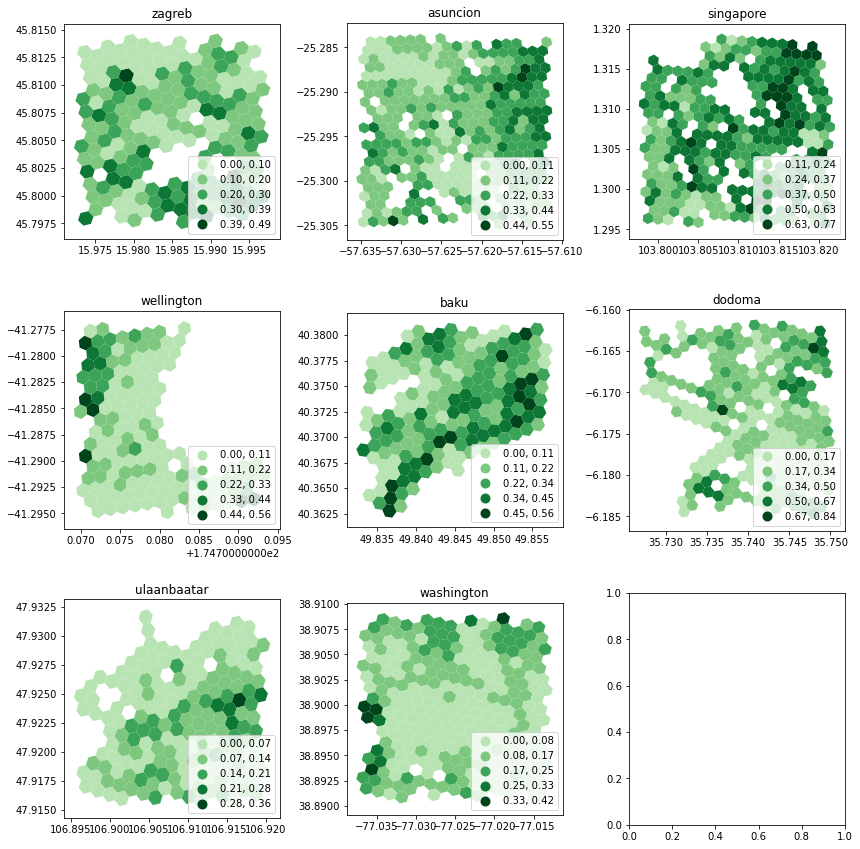

In [120]:
# Create a 3x3 grid for the plots
fig, axes = plt.subplots(3, 3, figsize=(12, 12))

min_val, max_val = 0.3,1.0
n = 10
orig_cmap = plt.cm.Greens
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# Plot data for each attribute in a 3x3 grid with the corrected order
for idx, (city, gdf) in enumerate(h3_avg.items()):
    row, col = divmod(idx, 3)
    gdf.dropna().plot(ax=axes[row, col], column='green_view_index_avg', scheme='equal_interval', cmap=cmap, legend=True,
                     legend_kwds={'loc':'lower right'}) 
    axes[row, col].set_title(f"{city}")

plt.tight_layout()
plt.show()


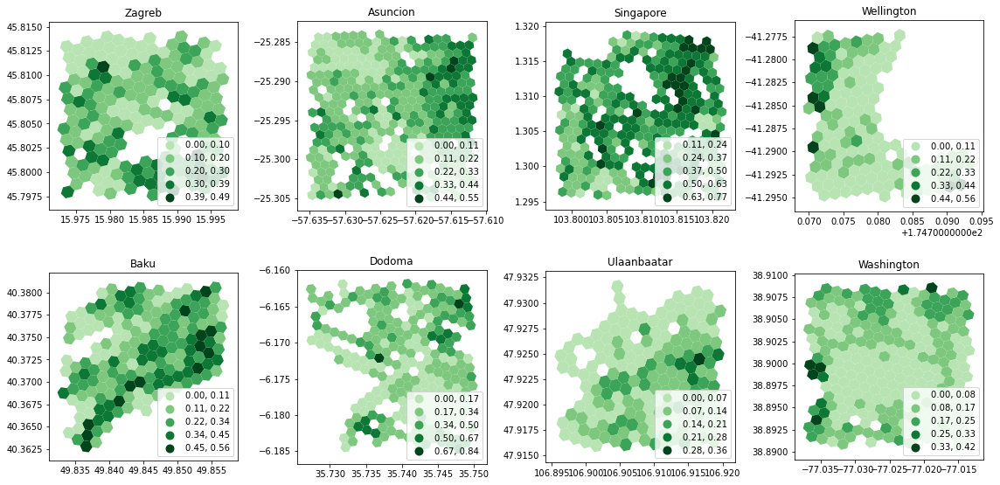

In [272]:
# Create a 3x3 grid for the plots
fig, axes = plt.subplots(2, 4, figsize=(16, 8))

min_val, max_val = 0.3,1.0
n = 10
orig_cmap = plt.cm.Greens
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# Plot data for each attribute in a 3x3 grid with the corrected order
for idx, (city, gdf) in enumerate(h3_avg.items()):
    row, col = divmod(idx, 4)
    gdf.dropna().plot(ax=axes[row, col], column='green_view_index_avg', scheme='equal_interval', cmap=cmap, legend=True,
                     legend_kwds={'loc':'lower right'}) 
    axes[row, col].set_title(f"{city}".capitalize())

plt.tight_layout()
plt.show()


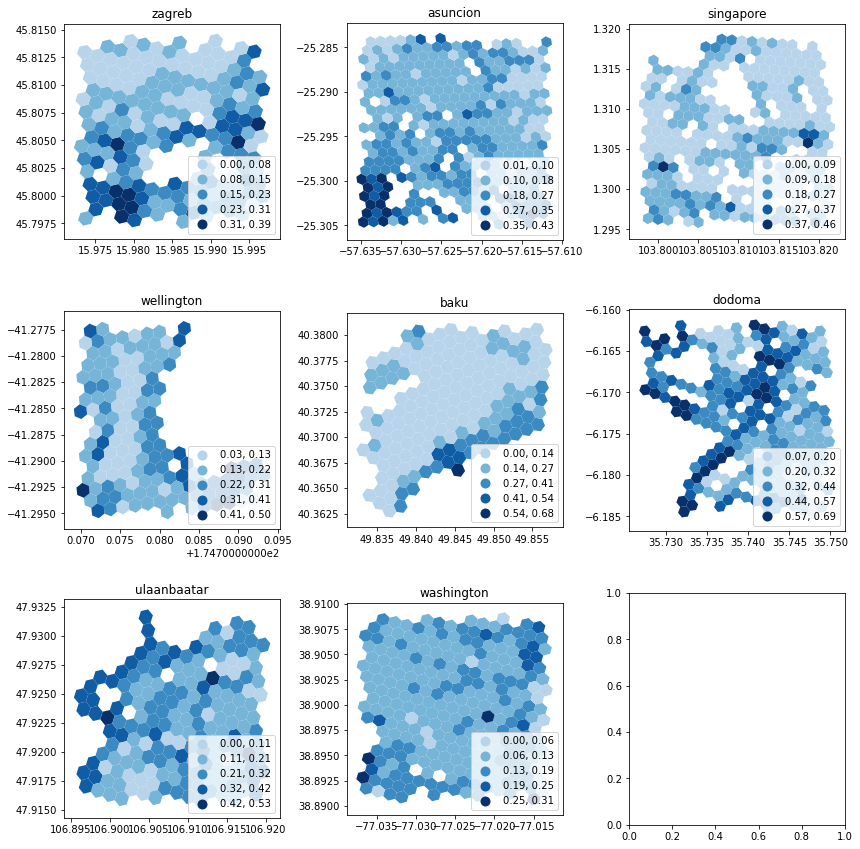

In [123]:
# Create a 3x3 grid for the plots
fig, axes = plt.subplots(3, 3, figsize=(12, 12))

min_val, max_val = 0.3,1.0
n = 10
orig_cmap = plt.cm.Blues
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# Plot data for each attribute in a 3x3 grid with the corrected order
for idx, (city, gdf) in enumerate(h3_avg.items()):
    row, col = divmod(idx, 3)
    gdf.dropna().plot(ax=axes[row, col], column='sky_view_factor_avg', scheme='equal_interval', cmap=cmap, legend=True,
                     legend_kwds={'loc':'lower right'}) 
    axes[row, col].set_title(f"{city}")

plt.tight_layout()
plt.show()


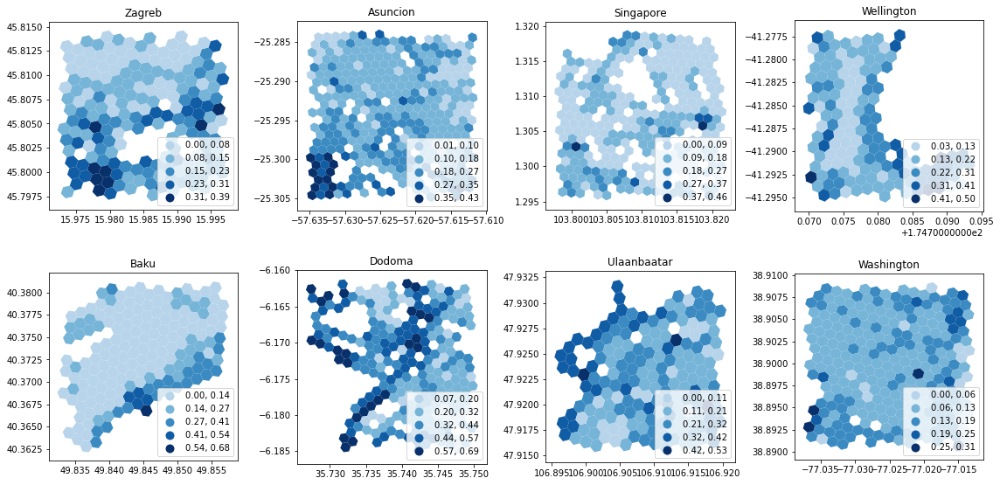

In [273]:
# Create a 3x3 grid for the plots
fig, axes = plt.subplots(2, 4, figsize=(16, 8))

min_val, max_val = 0.3,1.0
n = 10
orig_cmap = plt.cm.Blues
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# Plot data for each attribute in a 3x3 grid with the corrected order
for idx, (city, gdf) in enumerate(h3_avg.items()):
    row, col = divmod(idx, 4)
    gdf.dropna().plot(ax=axes[row, col], column='sky_view_factor_avg', scheme='equal_interval', cmap=cmap, legend=True,
                     legend_kwds={'loc':'lower right'}) 
    axes[row, col].set_title(f"{city}".capitalize())

plt.tight_layout()
plt.show()


In [783]:
d = '/Users/yujun/Data/global_streetscapes/use_cases/cities'
for _, (city, df) in enumerate(h3_avg.items()):
    df_out = df.copy()
    df_out['wkt'] = df.geometry.to_wkt()
    path = os.path.join(d, f"{city}_h3_grid.csv")
    df_out.drop(columns=['geometry']).to_csv(path)

In [81]:
np.load('/Users/yujun/Downloads/ilsvrc_2012_mean.npy').mean(1).mean(1)

array([104.00698793, 116.66876762, 122.67891434])

In [ ]:
red color component you subtract 123.68, from green you subtract 116.779, and from blue 103.939
123.68, 116.779, 103.939
104.00698793  116.66876762  122.67891434

In [83]:
np.array([104.00698793, 116.66876762, 122.67891434])

array([104.00698793, 116.66876762, 122.67891434])

In [84]:
np.array([103.939, 116.779, 123.68])

array([103.939, 116.779, 123.68 ])

In [ ]:
BGR mean values need to be subtracted as follows: 
    BGR
    [103.939, 116.779, 123.68] before passing the image blob into the network
mean-subtracted values: [('B', 104.0069879317889), ('G', 116.66876761696767), ('R', 122.6789143406786)]

# H3 - change

In [127]:
data_path = '/Users/yujun/Data/global_streetscapes/use_cases/cities'
data_dict = {}
for file in os.listdir(data_path):
    if 'h3.csv' in file:
        city = file.split('_')[0]
        fpath = os.path.join(data_path, file)
        df = pd.read_csv(fpath).drop(columns=['Unnamed: 0'])
        data_dict[city] = df
print(len(data_dict))

/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (7) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


8


In [234]:
data_dict['wellington'].info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23139 entries, 0 to 23138
Data columns (total 103 columns):
 #    Column                    Dtype  
---   ------                    -----  
 0    uuid                      object 
 1    source                    object 
 2    orig_id                   int64  
 3    city_id                   int64  
 4    pano_status               object 
 5    sequenceIndex             int64  
 6    sequenceId                object 
 7    speed_seq_kph             float64
 8    transportation_mode       object 
 9    seq_img_count             int64  
 10   highway                   object 
 11   type_highway              object 
 12   Bird                      float64
 13   Ground-Animal             float64
 14   Curb                      float64
 15   Fence                     float64
 16   Guard-Rail                float64
 17   Barrier                   float64
 18   Wall                      float64
 19   Bike-Lane                 float64
 20   Cros

In [146]:
test1 = data_dict['singapore'].groupby(['year', 'h3_10'])['green_view_index'].mean().to_frame().reset_index().rename(columns={'green_view_index': 'green_view_index_avg'}).dropna()
test1

,year,h3_10,green_view_index_avg
0,2005,8a6520d8268ffff,0.687784
2,2015,8a6520d82607fff,0.537858
3,2015,8a6520d8260ffff,0.648650
4,2015,8a6520d82617fff,0.689118
5,2015,8a6520d8261ffff,0.631888
...,...,...,...
674,2022,8a6520d9cb27fff,0.472020
675,2022,8a6520d9cb87fff,0.288271
676,2022,8a6520d9cba7fff,0.410820
677,2023,8a6520d8275ffff,0.282628


In [150]:
test2 = data_dict['singapore'].groupby(['year', 'h3_10'])['sky_view_factor'].mean().to_frame().reset_index().rename(columns={'sky_view_factor': 'sky_view_factor_avg'}).dropna()
test2

,year,h3_10,sky_view_factor_avg
0,2005,8a6520d8268ffff,0.008578
2,2015,8a6520d82607fff,0.157076
3,2015,8a6520d8260ffff,0.092498
4,2015,8a6520d82617fff,0.003814
5,2015,8a6520d8261ffff,0.048442
...,...,...,...
674,2022,8a6520d9cb27fff,0.058274
675,2022,8a6520d9cb87fff,0.178352
676,2022,8a6520d9cba7fff,0.128886
677,2023,8a6520d8275ffff,0.198864


In [153]:
test2.query('year==2005')

,year,h3_10,sky_view_factor_avg
0,2005,8a6520d8268ffff,0.008578


In [154]:
pd.merge(test1, test2)

,year,h3_10,green_view_index_avg,sky_view_factor_avg
0,2005,8a6520d8268ffff,0.687784,0.008578
1,2015,8a6520d82607fff,0.537858,0.157076
2,2015,8a6520d8260ffff,0.648650,0.092498
3,2015,8a6520d82617fff,0.689118,0.003814
4,2015,8a6520d8261ffff,0.631888,0.048442
...,...,...,...,...
673,2022,8a6520d9cb27fff,0.472020,0.058274
674,2022,8a6520d9cb87fff,0.288271,0.178352
675,2022,8a6520d9cba7fff,0.410820,0.128886
676,2023,8a6520d8275ffff,0.282628,0.198864


In [131]:
pd.set_option('display.max_columns', None)
data_dict['singapore'].query('year==2008')

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10
19462,c7728e83-ac0a-485b-948d-8aa5cb9c6afb,Mapillary,174864344513001,1702341327,False,0,Y4prahkKgpoJRrfi7Zj0Eg,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,c7728e83-ac0a-485b-948d-8aa5cb9c6afb.jpeg,7.88,2.89,0.89,7.31,2.42,8.08,1.300427,103.799193,2008-07-09 05:34:23.120000+08:00,Af,Tropical rainforest,Tropical,night,-1.5,NaN,2008,7,9,5,NaN,NaN,15,POINT (103.79919290542604 1.3004271132029004),8a6520d8345ffff


In [135]:
from shapely import wkt

h3_geoms = {}

d = '/Users/yujun/Data/global_streetscapes/use_cases/cities'
for file in os.listdir(data_path):
    if 'h3_grid.csv' in file:
        city = file.split('_')[0]
        fpath = os.path.join(data_path, file)
        df = pd.read_csv(fpath).drop(columns=['Unnamed: 0'])
        df['geometry'] = df['wkt'].apply(wkt.loads)
        gdf = gp.GeoDataFrame(df.drop(columns=['wkt']), crs='epsg:4326')
        h3_geoms[city] = gdf
print(len(h3_geoms))

8


In [136]:
h3_geoms['singapore']

,h3_10,geometry
0,8a6520d9ccb7fff,"POLYGON ((103.81604 1.31770, 103.81611 1.31843..."
1,8a6520d9cc8ffff,"POLYGON ((103.81352 1.31790, 103.81359 1.31862..."
2,8a6520d9cc87fff,"POLYGON ((103.81478 1.31780, 103.81485 1.31852..."
3,8a6520d8279ffff,"POLYGON ((103.82022 1.30859, 103.82029 1.30932..."
4,8a6520d91b6ffff,"POLYGON ((103.82096 1.30963, 103.82103 1.31036..."
...,...,...
298,8a6520d83087fff,"POLYGON ((103.79931 1.29595, 103.79938 1.29668..."
299,8a6520d83cd7fff,"POLYGON ((103.80560 1.29546, 103.80567 1.29619..."
300,8a6520d83c97fff,"POLYGON ((103.80886 1.29630, 103.80893 1.29703..."
301,8a6520d8356ffff,"POLYGON ((103.80182 1.29576, 103.80190 1.29648..."


In [157]:
# calculate GVI and SVF averages per year for each city
h3_avg_yr = {}
for _, (city, df) in enumerate(data_dict.items()):
    gvi_avg_yr = df.groupby(['year', 'h3_10'])['green_view_index'].mean().to_frame().reset_index().rename(columns={'green_view_index': 'green_view_index_avg'}).dropna()
    svf_avg_yr = df.groupby(['year', 'h3_10'])['sky_view_factor'].mean().to_frame().reset_index().rename(columns={'sky_view_factor': 'sky_view_factor_avg'}).dropna()
    geom = h3_geoms[city]
    df2 = pd.merge(gvi_avg_yr, svf_avg_yr)
    # df2 = df2.merge(h3_geoms, on='h3_10', how='left')
    # gdf = gp.GeoDataFrame(df2, crs="EPSG:4326")
    h3_avg_yr[city] = df2
print(len(h3_avg_yr))

8


In [237]:
h3_avg_yr['singapore']

,year,h3_10,green_view_index_avg,sky_view_factor_avg
0,2005,8a6520d8268ffff,0.687784,0.008578
1,2015,8a6520d82607fff,0.537858,0.157076
2,2015,8a6520d8260ffff,0.648650,0.092498
3,2015,8a6520d82617fff,0.689118,0.003814
4,2015,8a6520d8261ffff,0.631888,0.048442
...,...,...,...,...
673,2022,8a6520d9cb27fff,0.472020,0.058274
674,2022,8a6520d9cb87fff,0.288271,0.178352
675,2022,8a6520d9cba7fff,0.410820,0.128886
676,2023,8a6520d8275ffff,0.282628,0.198864


In [161]:
test3 = h3_avg_yr['singapore']
before = test3[test3['year'] == 2017].rename(columns={'year': 'start', 'green_view_index_avg': 'green_view_index_avg_start', 'sky_view_factor_avg': 'sky_view_factor_avg_start'})
after = test3[test3['year'] == 2019].rename(columns={'year': 'end', 'green_view_index_avg': 'green_view_index_avg_end', 'sky_view_factor_avg': 'sky_view_factor_avg_end'})
c = pd.merge(before, after, on='h3_10')
c['green_view_index_avg_delta'] = c['green_view_index_avg_end'] - c['green_view_index_avg_start']
c['sky_view_factor_avg_delta'] = c['sky_view_factor_avg_end'] - c['sky_view_factor_avg_start']
c

,start,h3_10,green_view_index_avg_start,sky_view_factor_avg_start,end,green_view_index_avg_end,sky_view_factor_avg_end,green_view_index_avg_delta,sky_view_factor_avg_delta
0,2017,8a6520d82047fff,0.584827,0.092041,2019,0.616639,0.034821,0.031812,-0.057220
1,2017,8a6520d8205ffff,0.634870,0.017827,2019,0.621701,0.014407,-0.013169,-0.003419
2,2017,8a6520d8206ffff,0.445749,0.239392,2019,0.436547,0.160723,-0.009202,-0.078668
3,2017,8a6520d8208ffff,0.514600,0.124640,2019,0.455080,0.083676,-0.059521,-0.040964
4,2017,8a6520d8209ffff,0.425459,0.156792,2019,0.499233,0.043131,0.073775,-0.113661
...,...,...,...,...,...,...,...,...,...
135,2017,8a6520d9cd57fff,0.480300,0.172549,2019,0.419948,0.064449,-0.060352,-0.108100
136,2017,8a6520d9cd5ffff,0.440271,0.139026,2019,0.436527,0.077207,-0.003744,-0.061818
137,2017,8a6520d9cd67fff,0.506183,0.142250,2019,0.530270,0.065646,0.024087,-0.076604
138,2017,8a6520d9cda7fff,0.740837,0.053423,2019,0.684821,0.023142,-0.056016,-0.030281


In [162]:
c.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140 entries, 0 to 139
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   start                       140 non-null    int64  
 1   h3_10                       140 non-null    object 
 2   green_view_index_avg_start  140 non-null    float64
 3   sky_view_factor_avg_start   140 non-null    float64
 4   end                         140 non-null    int64  
 5   green_view_index_avg_end    140 non-null    float64
 6   sky_view_factor_avg_end     140 non-null    float64
 7   green_view_index_avg_delta  140 non-null    float64
 8   sky_view_factor_avg_delta   140 non-null    float64
dtypes: float64(6), int64(2), object(1)
memory usage: 10.9+ KB


<AxesSubplot:>

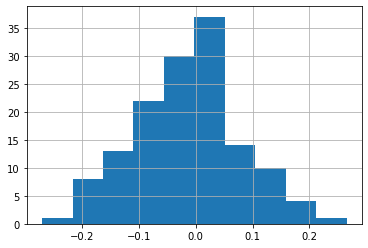

In [163]:
c['green_view_index_avg_delta'].hist()

<AxesSubplot:>

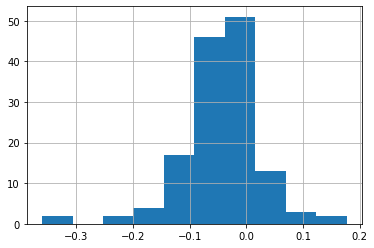

In [164]:
c['sky_view_factor_avg_delta'].hist()

In [238]:
# calculate change:
# zagreb: 2015 - 2022
# asuncion: 2016 - 2022
# singapore: 2017 - 2019
# wellington: 2016 - 2019
# dodoma: 2018 - 2021
# washington: 2019 - 2022

years = {
    'zagreb': [2015, 2022],
    'asuncion': [2016, 2022],
    'singapore': [2017, 2019],
    'wellington': [2016, 2019],
    'dodoma': [2018, 2021],
    'washington': [2019, 2022]
}

change = {}

for _, (city, df) in enumerate(h3_avg_yr.items()):
    if city in years.keys():
        y_start = years[city][0]
        y_end = years[city][1]
        before = df[df['year'] == y_start].rename(columns={'year': 'start', 'green_view_index_avg': 'green_view_index_avg_start', 'sky_view_factor_avg': 'sky_view_factor_avg_start'})
        after = df[df['year'] == y_end].rename(columns={'year': 'end', 'green_view_index_avg': 'green_view_index_avg_end', 'sky_view_factor_avg': 'sky_view_factor_avg_end'})
        c = pd.merge(before, after, on='h3_10')
        c['green_view_index_avg_delta'] = c['green_view_index_avg_end'] - c['green_view_index_avg_start']
        c['sky_view_factor_avg_delta'] = c['sky_view_factor_avg_end'] - c['sky_view_factor_avg_start']
        gdf = h3_geoms[city].merge(c, on='h3_10', how='left')
        gdf = gp.GeoDataFrame(gdf, crs="EPSG:4326")
        change[city] = gdf

print(len(change))

6


In [185]:
change['singapore']

,h3_10,geometry,start,green_view_index_avg_start,sky_view_factor_avg_start,end,green_view_index_avg_end,sky_view_factor_avg_end,green_view_index_avg_delta,sky_view_factor_avg_delta
0,8a6520d9ccb7fff,"POLYGON ((103.81604 1.31770, 103.81611 1.31843...",2017.0,0.595846,0.055346,2019.0,0.540742,0.018098,-0.055104,-0.037248
1,8a6520d9cc8ffff,"POLYGON ((103.81352 1.31790, 103.81359 1.31862...",2017.0,0.576007,0.069077,2019.0,0.501709,0.049384,-0.074299,-0.019694
2,8a6520d9cc87fff,"POLYGON ((103.81478 1.31780, 103.81485 1.31852...",2017.0,0.517662,0.116051,2019.0,0.496234,0.047259,-0.021427,-0.068792
3,8a6520d8279ffff,"POLYGON ((103.82022 1.30859, 103.82029 1.30932...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,8a6520d91b6ffff,"POLYGON ((103.82096 1.30963, 103.82103 1.31036...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
298,8a6520d83087fff,"POLYGON ((103.79931 1.29595, 103.79938 1.29668...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
299,8a6520d83cd7fff,"POLYGON ((103.80560 1.29546, 103.80567 1.29619...",2017.0,0.442882,0.088956,2019.0,0.248598,0.143284,-0.194284,0.054328
300,8a6520d83c97fff,"POLYGON ((103.80886 1.29630, 103.80893 1.29703...",2017.0,0.353373,0.140796,2019.0,0.370057,0.052285,0.016683,-0.088510
301,8a6520d8356ffff,"POLYGON ((103.80182 1.29576, 103.80190 1.29648...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [214]:
change['zagreb']['start'].dropna().unique()[0]

2015.0

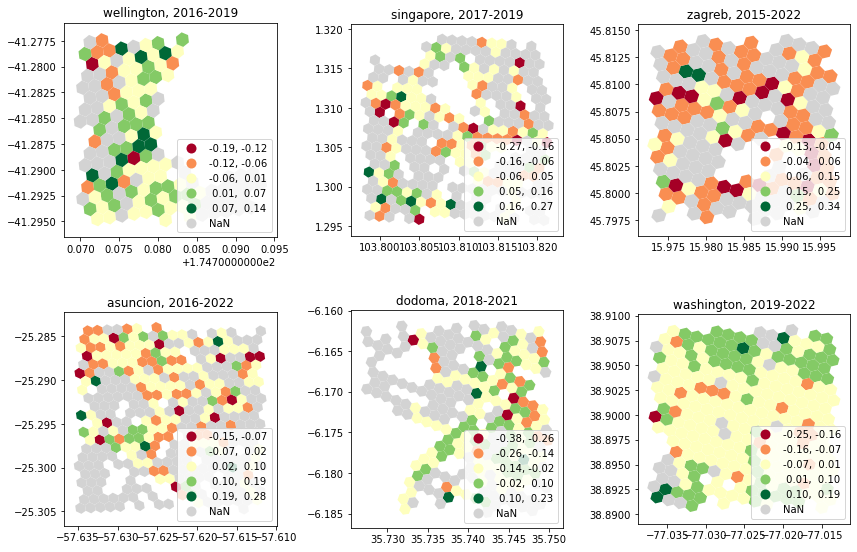

In [239]:
# Create a 3x3 grid for the plots
fig, axes = plt.subplots(2, 3, figsize=(12, 8))

# min_val, max_val = 0.3,1.0
# n = 10
# orig_cmap = plt.cm.RdYlGn
# colors = orig_cmap(np.linspace(min_val, max_val, n))
# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# Plot data for each attribute in a 3x3 grid with the corrected order
for idx, (city, gdf) in enumerate(change.items()):
    row, col = divmod(idx, 3)
    gdf.plot(ax=axes[row, col], column='green_view_index_avg_delta', missing_kwds={'color': 'lightgrey'}, scheme='equal_interval', cmap='RdYlGn', legend=True,
                     legend_kwds={'loc':'lower right'}) 
    start = gdf['start'].dropna().unique()[0].astype(int)
    end = gdf['end'].dropna().unique()[0].astype(int)
    axes[row, col].set_title(f"{city}, {start}-{end}")

plt.tight_layout()
plt.show()


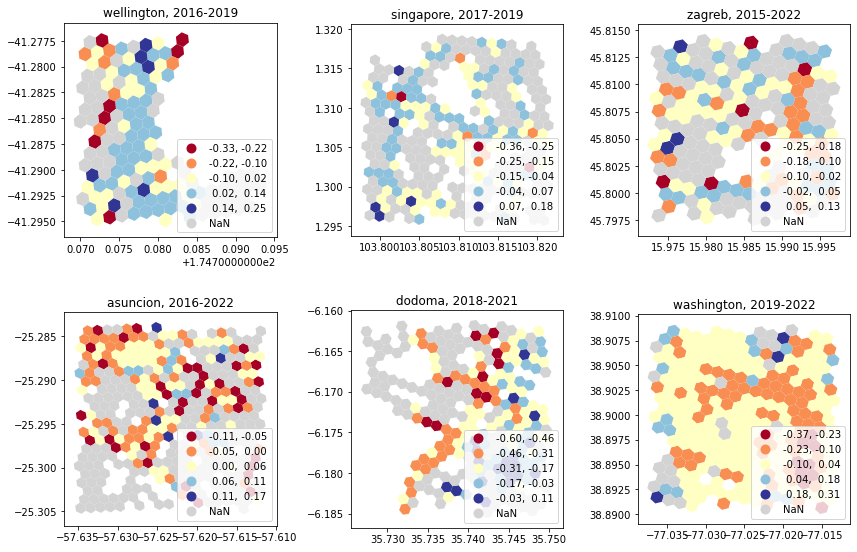

In [240]:
# Create a 3x3 grid for the plots
fig, axes = plt.subplots(2, 3, figsize=(12, 8))

# min_val, max_val = 0.3,1.0
# n = 10
# orig_cmap = plt.cm.RdYlGn
# colors = orig_cmap(np.linspace(min_val, max_val, n))
# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# Plot data for each attribute in a 3x3 grid with the corrected order
for idx, (city, gdf) in enumerate(change.items()):
    row, col = divmod(idx, 3)
    gdf.plot(ax=axes[row, col], column='sky_view_factor_avg_delta', missing_kwds={'color': 'lightgrey'}, scheme='equal_interval', cmap='RdYlBu', legend=True,
                     legend_kwds={'loc':'lower right'}) 
    start = gdf['start'].dropna().unique()[0].astype(int)
    end = gdf['end'].dropna().unique()[0].astype(int)
    axes[row, col].set_title(f"{city}, {start}-{end}")

plt.tight_layout()
plt.show()


In [241]:
test4 = ox.project_gdf(change['zagreb'])
print((test4.total_bounds[2] - test4.total_bounds[0])/1000)
print((test4.total_bounds[3] - test4.total_bounds[1])/1000)

1.9834042766919593
1.966769858814776


In [785]:
d = '/Users/yujun/Data/global_streetscapes/use_cases/cities'
for _, (city, df) in enumerate(change.items()):
    df_out = df.copy()
    df_out['wkt'] = df.geometry.to_wkt()
    path = os.path.join(d, f"{city}_h3_change.csv")
    df_out.drop(columns=['geometry']).to_csv(path)

# H3 - change (without winter)

In [232]:
data_dict['zagreb'].season.value_counts()

Spring    10810
Autumn    10460
Summer     9948
Winter     2882
Name: season, dtype: int64

In [224]:
data_dict2 = {}
for _, (city, df) in enumerate(data_dict.items()):
    if city == 'singapore':
        data_dict2[city] = df
    else:
        df2 = df[df['season'] != 'Winter']
        data_dict2[city] = df2
print(len(data_dict2))

8


In [225]:
print(len(data_dict2['zagreb']))
print(len(data_dict['zagreb']))

31218
34100


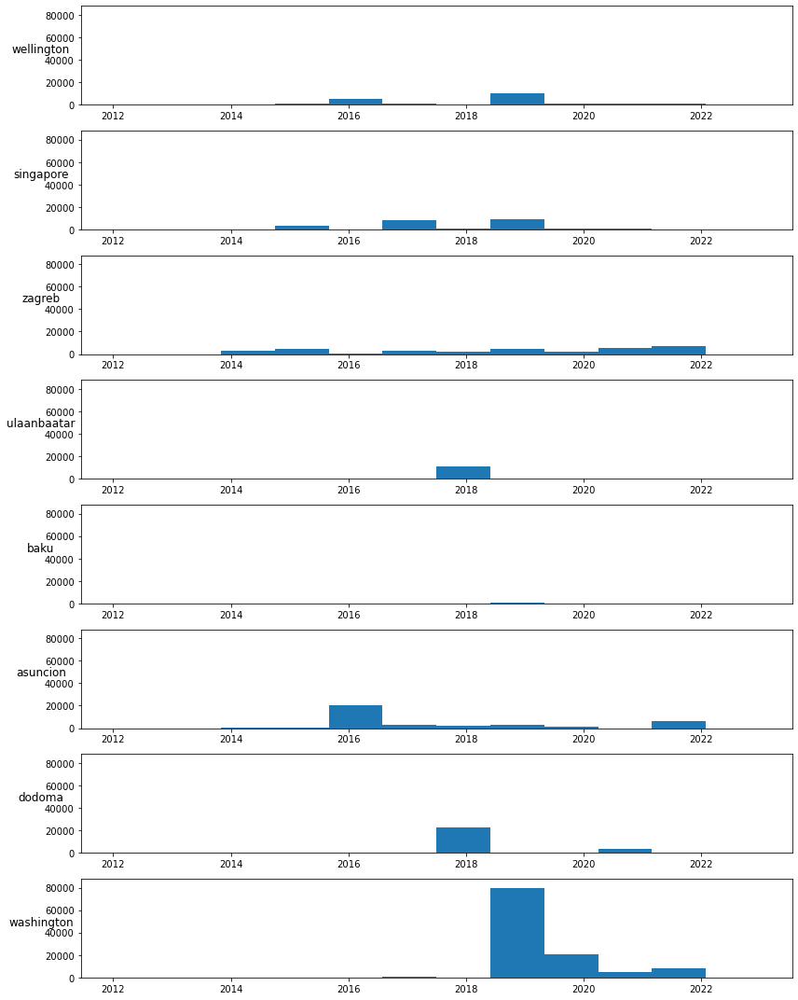

In [233]:
import numpy as np
import matplotlib

# Create a grid for the plots
fig, axes = plt.subplots(len(data_dict2), 1, figsize=(12, 15))

# Plot data for each attribute in a grid with the corrected order
for row, (city, gdf) in enumerate(data_dict2.items()):
    #print(city)

    #axes[row, col].set_facecolor('black')
    axes[row].hist(gdf.year, bins=12, range=[2012, 2023])
    axes[row].set_ylim([0,88000])
    #gdf[gdf['source'] == 'Mapillary'].plot(ax=axes[row, col], marker='o', color='green', markersize=2, alpha=0.7)
    #gdf[gdf['source'] == 'KartaView'].plot(ax=axes[row, col], marker='o', color='purple', markersize=2, alpha=0.7)

    # Set title and labels

city_names2 = list(data_dict2.keys())
for ax, row in zip(axes, city_names2):
    ax.set_ylabel(row, rotation=0, size='large')

# Adjust layout and display
plt.tight_layout()
plt.show()

# calculate change:
# zagreb: 2015 - 2022
# asuncion: 2016 - 2022
# singapore: 2017 - 2019
# wellington: 2016 - 2019
# dodoma: 2018 - 2021
# washington: 2019 - 2022

In [242]:
# calculate GVI and SVF averages per year for each city
h3_avg_yr2 = {}
for _, (city, df) in enumerate(data_dict2.items()):
    gvi_avg_yr = df.groupby(['year', 'h3_10'])['green_view_index'].mean().to_frame().reset_index().rename(columns={'green_view_index': 'green_view_index_avg'}).dropna()
    svf_avg_yr = df.groupby(['year', 'h3_10'])['sky_view_factor'].mean().to_frame().reset_index().rename(columns={'sky_view_factor': 'sky_view_factor_avg'}).dropna()
    geom = h3_geoms[city]
    df2 = pd.merge(gvi_avg_yr, svf_avg_yr)
    # df2 = df2.merge(h3_geoms, on='h3_10', how='left')
    # gdf = gp.GeoDataFrame(df2, crs="EPSG:4326")
    h3_avg_yr2[city] = df2
print(len(h3_avg_yr2))

8


In [243]:
print(len(h3_avg_yr2['zagreb']))
print(len(h3_avg_yr['zagreb']))

893
914


In [248]:
# calculate change:
# zagreb: 2015 - 2022
# asuncion: 2016 - 2022
# singapore: 2017 - 2019
# wellington: 2016 - 2019
# dodoma: 2018 - 2021
# washington: 2019 - 2022

years = {
    'zagreb': [2015, 2022],
    'asuncion': [2016, 2022],
    'singapore': [2017, 2019],
    'wellington': [2016, 2019],
    'dodoma': [2018, 2021],
    'washington': [2019, 2022]
}

change2 = {}

for _, (city, df) in enumerate(h3_avg_yr2.items()):
    if city in years.keys():
        y_start = years[city][0]
        y_end = years[city][1]
        before = df[df['year'] == y_start].rename(columns={'year': 'start', 'green_view_index_avg': 'green_view_index_avg_start', 'sky_view_factor_avg': 'sky_view_factor_avg_start'})
        after = df[df['year'] == y_end].rename(columns={'year': 'end', 'green_view_index_avg': 'green_view_index_avg_end', 'sky_view_factor_avg': 'sky_view_factor_avg_end'})
        c = pd.merge(before, after, on='h3_10')
        c['green_view_index_avg_delta'] = c['green_view_index_avg_end'] - c['green_view_index_avg_start']
        c['sky_view_factor_avg_delta'] = c['sky_view_factor_avg_end'] - c['sky_view_factor_avg_start']
        gdf = h3_geoms[city].merge(c, on='h3_10', how='left')
        gdf = gp.GeoDataFrame(gdf, crs="EPSG:4326")
        change2[city] = gdf

print(len(change2))

6


In [249]:
print(len(change['zagreb']))
print(len(change2['zagreb']))

192
192


In [214]:
change['zagreb']['start'].dropna().unique()[0]

2015.0

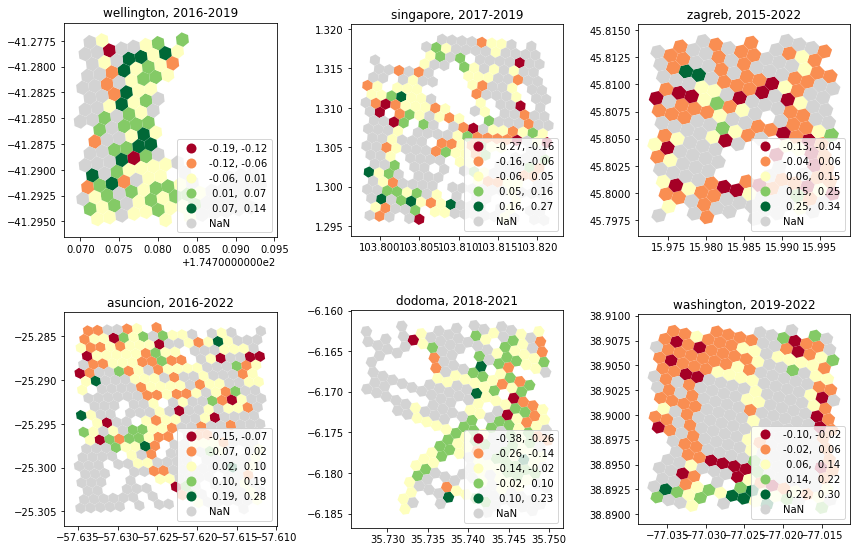

In [250]:
# Create a 3x3 grid for the plots
fig, axes = plt.subplots(2, 3, figsize=(12, 8))

# min_val, max_val = 0.3,1.0
# n = 10
# orig_cmap = plt.cm.RdYlGn
# colors = orig_cmap(np.linspace(min_val, max_val, n))
# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# Plot data for each attribute in a 3x3 grid with the corrected order
for idx, (city, gdf) in enumerate(change2.items()):
    row, col = divmod(idx, 3)
    gdf.plot(ax=axes[row, col], column='green_view_index_avg_delta', missing_kwds={'color': 'lightgrey'}, scheme='equal_interval', cmap='RdYlGn', legend=True,
                     legend_kwds={'loc':'lower right'}) 
    start = gdf['start'].dropna().unique()[0].astype(int)
    end = gdf['end'].dropna().unique()[0].astype(int)
    axes[row, col].set_title(f"{city}, {start}-{end}")

plt.tight_layout()
plt.show()


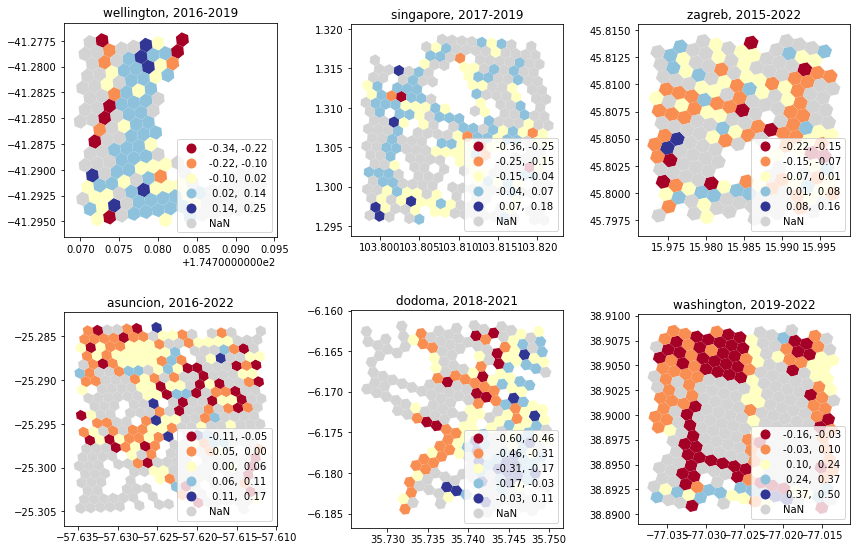

In [251]:
# Create a 3x3 grid for the plots
fig, axes = plt.subplots(2, 3, figsize=(12, 8))

# min_val, max_val = 0.3,1.0
# n = 10
# orig_cmap = plt.cm.RdYlGn
# colors = orig_cmap(np.linspace(min_val, max_val, n))
# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# Plot data for each attribute in a 3x3 grid with the corrected order
for idx, (city, gdf) in enumerate(change2.items()):
    row, col = divmod(idx, 3)
    gdf.plot(ax=axes[row, col], column='sky_view_factor_avg_delta', missing_kwds={'color': 'lightgrey'}, scheme='equal_interval', cmap='RdYlBu', legend=True,
                     legend_kwds={'loc':'lower right'}) 
    start = gdf['start'].dropna().unique()[0].astype(int)
    end = gdf['end'].dropna().unique()[0].astype(int)
    axes[row, col].set_title(f"{city}, {start}-{end}")

plt.tight_layout()
plt.show()


In [252]:
test4 = ox.project_gdf(change2['zagreb'])
print((test4.total_bounds[2] - test4.total_bounds[0])/1000)
print((test4.total_bounds[3] - test4.total_bounds[1])/1000)

1.9834042766919593
1.966769858814776


In [297]:
test4 = ox.project_gdf(change2['singapore'])
print((test4.total_bounds[2] - test4.total_bounds[0])/1000)
print((test4.total_bounds[3] - test4.total_bounds[1])/1000)

2.728314574444725
2.70029625460587


In [257]:
print(len(data_dict['washington'].query("year==2022 & season=='Winter'")))
print(len(data_dict['washington'].query("year==2019 & season=='Winter'")))

21918
4978


In [258]:
data_dict['washington'].query("year==2022 & season=='Winter'")

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10
6,6665bd4e-9bce-4203-ad6d-e4463bad3369,Mapillary,761583151774863,1840006060,False,41,FOygodslvHurX71AYP4K9q,29.692925,driving,109,footway,for walking,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6665bd4e-9bce-4203-ad6d-e4463bad3369.jpeg,7.41,2.81,2.69,5.58,4.78,4.60,38.894532,-77.026176,2022-02-01 04:38:58-05:00,Cfa,"Humid subtropical, no dry season",Winter,night,-2.59,NaN,2022,2,1,4,NaN,NaN,1,POINT (-77.02617645263672 38.89453168255608),8a2aa845aaa7fff
7,138c6677-8adb-49e1-ab74-9af0339d61da,Mapillary,5522623691116982,1840006060,False,125,B4ktL2vpF0xwDPRh9NyiXg,42.722473,driving,218,cycleway,for cycling,0.0,0.0,0.0,0.0,0.0,0.0,1284135.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8359.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1292494.0,138c6677-8adb-49e1-ab74-9af0339d61da.jpeg,5.61,3.71,7.10,5.09,2.41,2.68,38.895133,-77.028360,2022-02-01 04:39:13-05:00,Cfa,"Humid subtropical, no dry season",Winter,night,-2.58,NaN,2022,2,1,4,0.000000,0.000000,1,POINT (-77.02835977077484 38.89513290061245),8a2aa845aab7fff
15,047e4700-3e7d-491e-b408-20bd465657be,Mapillary,462035459181544,1840006060,False,12,aTM0UQ8tFbw9jES3JxRVnd,22.546813,driving,59,cycleway,for cycling,0.0,0.0,8407.0,21480.0,0.0,0.0,0.0,5019.0,0.0,0.0,0.0,0.0,0.0,1628786.0,0.0,13316.0,0.0,69709.0,0.0,6734.0,0.0,0.0,0.0,1736.0,130703.0,0.0,0.0,13668.0,0.0,0.0,173580.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2374.0,0.0,0.0,5553.0,0.0,5199.0,0.0,0.0,0.0,0.0,10925.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2097189.0,047e4700-3e7d-491e-b408-20bd465657be.jpeg,8.83,3.40,2.80,4.60,7.60,6.43,38.891901,-77.016574,2022-02-01 04:35:42-05:00,Cfa,"Humid subtropical, no dry season",Winter,night,-2.64,NaN,2022,2,1,4,0.082768,0.006517,1,POINT (-77.0165741443634 38.89190129371781),8a2aa8458687fff
22,a7119b57-1d86-4f11-8c5e-08ad1ce04dbf,Mapillary,1043421549684074,1840006060,False,39,DU59mfabrlQtxZ2gyGOF3c,11.396435,cycling,69,primary,for driving,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8677.0,0.0,0.0,935871.0,0.0,34970.0,0.0,135722.0,0.0,0.0,0.0,0.0,0.0,270.0,0.0,0.0,0.0,5407.0,0.0,9273.0,209568.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13148.0,0.0,0.0,0.0,8128.0,0.0,971.0,0.0,0.0,6871.0,0.0,0.0,0.0,0.0,686490.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2055366.0,a7119b57-1d86-4f11-8c5e-08ad1ce04dbf.jpeg,5.63,1.88,0.74,8.61,6.19,4.00,38.896615,-77.016177,2022-01-19 05:50:53-05:00,Cfa,"Humid subtropical, no dry season",Winter,night,-1.54,NaN,2022,1,19,5,0.101961,0.002631,1,POINT (-77.0161771774292 38.89661504838662),8a2aa84584effff
28,c2a6bf18-1f63-47c5-bf3f-7eecc8f20f70,Mapillary,130145906426109,184000606

In [259]:
data_dict['washington'].query("orig_id==770090847648350")

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10
51909,d0d49b0e-1962-4339-b4aa-cf0ed34a4ab4,Mapillary,770090847648350,1840006060,False,214,2UqDTZEjs8aMetnOzSLr0k,31.549084,driving,251,primary,for driving,0.0,0.0,0.0,0.0,0.0,0.0,1282428.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,72.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1282500.0,d0d49b0e-1962-4339-b4aa-cf0ed34a4ab4.jpeg,2.42,1.18,5.59,7.84,4.06,4.15,38.90625,-77.03352,2022-01-24 08:28:29-05:00,Cfa,"Humid subtropical, no dry season",Winter,day,1.13,NaN,2022,1,24,8,0.0,0.0,1,POINT (-77.0335203409195 38.90625034214605),8a2aa845ad2ffff


In [296]:
print(len(data_dict['washington'].query("green_view_index==0")))
print(len(data_dict['washington'].query("sky_view_factor==0")))

55614
65412


In [264]:
data_dict['washington'].query("green_view_index==0").groupby('sequenceId').first()

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10
sequenceId,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2082814,9a60c2b7-6f42-40fd-aa96-984c88442963,KartaView,592213282,1840006060,False,24,6.759819,cycling,171,footway,for walking,0.0,0.0,51350.0,0.0,0.0,0.0,0.0,0.0,2473070.0,65860.0,0.0,0.0,0.0,325440.0,0.0,547230.0,0.0,2755410.0,0.0,731540.0,0.0,0.0,0.0,0.0,191260.0,0.0,0.0,437240.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,28740.0,0.0,0.0,0.0,0.0,0.0,17250.0,0.0,0.0,0.0,90520.0,0.0,0.0,133990.0,0.0,46830.0,19640.0,0.0,0.0,0.0,5420.0,0.0,0.0,0.0,0.0,0.0,43470.0,0.0,0.0,0.0,7964260.0,9a60c2b7-6f42-40fd-aa96-984c88442963.jpeg,3.43,1.39,5.26,8.70,7.65,4.49,38.897572,-77.029256,2020-02-22 08:51:35-05:00,Cfa,"Humid subtropical, no dry season",Winter,day,2.01,NaN,2020,2,22,8,0.0,0.054900,3,POINT (-77.029256 38.897572),8a2aa845a167fff
2082882,b6a79e0f-02bc-4ed2-a466-b4b9d0e91846,KartaView,592284286,1840006060,False,127,6.357862,cycling,308,trunk,for driving,0.0,0.0,830.0,0.0,0.0,0.0,0.0,720810.0,0.0,0.0,40140.0,0.0,0.0,1946190.0,0.0,13630.0,0.0,2690750.0,0.0,0.0,0.0,0.0,0.0,0.0,193640.0,0.0,0.0,620110.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5720.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,44080.0,0.0,0.0,0.0,0.0,11350.0,0.0,0.0,0.0,0.0,1843010.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8130260.0,b6a79e0f-02bc-4ed2-a466-b4b9d0e91846.jpeg,6.42,4.21,1.75,8.55,7.34,7.89,38.903481,-77.027092,2020-02-22 10:41:44-05:00,Cfa,"Humid subtropical, no dry season",Winter,day,3.85,NaN,2020,2,22,10,0.0,0.076272,3,POINT (-77.027092 38.903481),8a2aa845a9affff
2084294,391135d4-9b95-4436-9237-21afdea40c2d,KartaView,594495886,1840006060,False,128,9.513829,cycling,217,primary,for driving,0.0,0.0,34450.0,22000.0,0.0,0.0,0.0,0.0,0.0,70240.0,0.0,0.0,0.0,1851280.0,0.0,306540.0,0.0,3298960.0,0.0,11350.0,0.0,0.0,0.0,15290.0,107170.0,0.0,0.0,815510.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,32200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13350.0,29150.0,0.0,0.0,0.0,0.0,125310.0,20620.0,0.0,0.0,0.0,1413100.0,0.0,740.0,0.0,0.0,0.0,24100.0,0.0,0.0,0.0,8191360.0,391135d4-9b95-4436-9237-21afdea40c2d.jpeg,2.39,1.13,2.64,9.45,5.74,7.76,38.899691,-77.031346,2020-02-27 15:47:31-05:00,Cfa,"Humid subtropical, no dry season",Winter,day,NaN,-2.18,2020,2,27,15,0.0,0.099557,3,POINT (-77.031346 38.899691),8a2aa845a127fff
2084350,e3eae1e0-5aa8-49dc-94d2-8ea156c3d883,KartaView,594521898,1840006060,False,108,12.982204,cycling,122,None,None,0.0,0.0,27430.0,0.0,0.0,0.0,0.0,503640.0,0.0,47930.0,0.0,0.0,0.0,2369960.0,0.0,292530.0,0.0,3733860.0,0.0,11120.0,0.0,0.0,0.0,0.0,235510.0,0.0,0.0,702740.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13430.0,0.0,0.0,0.0,0.0,0.0,21040.0,0.0,0.0,0.0,74030.0,0.0,0.0,0.0,3660.0,3270.0,0.0,0.0,0.0,0.0,120920.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8161070.0,e3eae1e0-5aa8-49dc-94d2-8ea156c3d883.jpeg,7.91,2.28,1.26,8.79,8.06,4.49,38.903490,-77.027176,2020-02-27 16:30:17-05:00,Cfa,"Humid subtropical, no dry season",Winter,day,NaN,-1.47,2020,2,27,16,0.0,0.086109,3,POINT (-77.027176 38.90349),8a2a

In [281]:
import re
loss_pattern = re.compile(r'validation_loss=([0-9]+\.[0-9]+)')
file = 'e14259c3-aea1-4469-a70d-451955255a80_lighting_condition_lighting_condition_uniform_checkpoint.ckpt'
file = 'e14259c3-aea1-4469-a70d-451955255a80-epoch=1_validation_loss=0.08'
loss_match = loss_pattern.search(file)
loss = float(loss_match.group(1))
print('loss:', loss)

loss: 0.08


In [276]:
re.findall(r'validation_loss=([0-9]+\.[0-9]+)', file)

[]

In [278]:
re.findall("validation_loss=(\d+\.\d+)", file)

[]

In [280]:
'./checkpoints/lighting_condition_uniform/e14259c3-aea1-4469-a70d-451955255a80_lighting_condition_lighting_condition_uniform_checkpoint.ckpt'.split('/')[-2]

'lighting_condition_uniform'

In [283]:
attr_dict =  {
                    # 'field_of_view': 'field_of_view.csv',
                    # 'glare': 'glare.csv',
                    'lighting_condition': 'lighting_condition.csv'
                    # 'pano_status': 'pano_status.csv',
                    # 'platform': 'platform.csv',
                    # 'quality': 'quality.csv',
                    # 'reflection': 'reflection.csv',
                    # 'view_direction': 'view_direction.csv',
                    # 'weather': 'weather.csv',
                    # 'weather_precipitation': 'weather_precipitation.csv',
                    # 'weather_nonprecipitation': 'weather_nonprecipitation.csv'
                    }
for index,(attribute,filename) in enumerate(attr_dict.items()):
    print(index, attribute, filename)

0 lighting_condition lighting_condition.csv


In [293]:
list(attr_dict.keys())[0]

'lighting_condition'

In [295]:
os.path.join('1', '2', '3', '4')

'1/2/3/4'

# Correlations

In [ ]:
# Relationship between perception scores and other variables 
# (e.g. GVI, SVF, OSM road type, season, time of day, quality)

In [306]:
data_dict['singapore'].head()

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10
0,1adf9bb9-8525-4048-aa9e-b2bdf4476c3e,KartaView,728186370,1702341327,NaN,267,2270946,24.251058,driving,109,residential,for driving,0.0,0.0,108185.0,191227.0,0.0,0.0,31675.0,0.0,0.0,0.0,0.0,0.0,0.0,4948778.0,0.0,0.0,0.0,312722.0,0.0,13325.0,0.0,0.0,0.0,0.0,232569.0,0.0,0.0,352688.0,0.0,34142.0,5596653.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,160.0,5345.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,99685.0,11927154.0,1adf9bb9-8525-4048-aa9e-b2bdf4476c3e.jpeg,9.25,2.27,1.33,6.84,8.59,7.50,1.318085,103.815243,2020-05-23 12:51:00+08:00,Af,Tropical rainforest,Tropical,day,5.92,NaN,2020,5,23,12,0.469236,0.029570,3,POINT (103.815243 1.318085),8a6520d9ccb7fff
1,ebb9ead9-7c84-45de-b806-f6c2778995fb,Mapillary,492175448486006,1702341327,False,25,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,10020.0,608.0,0.0,0.0,22380.0,0.0,0.0,0.0,0.0,7312.0,0.0,843064.0,0.0,1684.0,0.0,0.0,0.0,10644.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,76640.0,1967264.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,79644.0,0.0,0.0,0.0,0.0,0.0,10536.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3029796.0,ebb9ead9-7c84-45de-b806-f6c2778995fb.jpeg,9.87,5.75,1.17,2.82,6.40,8.76,1.318088,103.815426,2018-06-17 15:04:13.202000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.649306,0.000000,5,POINT (103.81542563438416 1.3180875299077286),8a6520d9ccb7fff
2,caab976b-d893-47b3-99ae-49a1ad26c4b1,Mapillary,369268314457198,1702341327,False,5,Kob0RdnEWnfxYC2lOyaDGg,2.029842,walking,6,footway,for walking,0.0,0.0,11633.0,0.0,0.0,0.0,752.0,0.0,0.0,0.0,0.0,39671.0,0.0,399656.0,0.0,40454.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,409213.0,2149227.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1176.0,0.0,0.0,0.0,0.0,0.0,28996.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3080778.0,caab976b-d893-47b3-99ae-49a1ad26c4b1.jpeg,9.66,6.74,1.44,5.79,8.04,8.34,1.318093,103.815882,2015-06-10 16:37:32.299000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-2.54,2015,6,10,16,0.697625,0.000000,8,POINT (103.81588160991669 1.3180928929063214),8a6520d9ccb7fff
3,97154acd-c911-4a70-b8fc-f60a1f72d55c,Mapillary,474959053813041,1702341327,False,202,of4KNy8PhL3NTXlpkguNeA,20.889756,driving,194,residential,for driving,0.0,0.0,8650.0,79450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,77300.0,0.0,78935.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3950.0,0.0,0.0,0.0,0.0,102470.0,1544530.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1170.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4990.0,0.0,0.0,0.0,0.0,0.0,25.0,0.0,0.0,137615.0,2039085.0,97154acd-c911-4a70-b8fc-f60a1f72d55c.jpeg,8.13,4.04,5.97,1.92,1.03,4.67,1.318109,103.815286,2017-01-19 11:46:58+08:00,Af,Tropical rainforest,Tropical,day,4.55,NaN,2017,1,19,11,0.757462,0.000000,6,POINT (103.81528615951538 1.3181089819020002),8a6520d9ccb7fff
4,56441441-7162-4961-a56c-432b535b080b,Mapillary,836484953940223,1702341327,

In [309]:
dfs = [df for city, df in data_dict.items()]
len(dfs)

8

In [312]:
for city,df in data_dict.items():
    print(city, ":", df.iloc[0]['city_id'])

wellington : 1554772152
singapore : 1702341327
zagreb : 1191233290
ulaanbaatar : 1496024767
baku : 1031946365
asuncion : 1600057911
dodoma : 1834288497
washington : 1840006060


## for all 8 cities

In [313]:
df_all = pd.concat(dfs).reset_index(drop=True)
df_all.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390887 entries, 0 to 390886
Data columns (total 103 columns):
 #    Column                    Non-Null Count   Dtype  
---   ------                    --------------   -----  
 0    uuid                      390887 non-null  object 
 1    source                    390887 non-null  object 
 2    orig_id                   390887 non-null  int64  
 3    city_id                   390887 non-null  int64  
 4    pano_status               385666 non-null  object 
 5    sequenceIndex             390887 non-null  int64  
 6    sequenceId                390887 non-null  object 
 7    speed_seq_kph             390492 non-null  float64
 8    transportation_mode       390492 non-null  object 
 9    seq_img_count             390887 non-null  int64  
 10   highway                   381802 non-null  object 
 11   type_highway              379044 non-null  object 
 12   Bird                      335379 non-null  float64
 13   Ground-Animal             3

In [315]:
cols = [
    'uuid',
    'source',
    'orig_id',
    'city_id',
    'pano_status',
    'sequenceId',
    'sequenceIndex',
    'transportation_mode',
    'seq_img_count',
    'highway',
    'type_highway',
    'Total',
    'Image_name',
    'lat',
    'lon',
    'datetime_local',
    'koppen_geiger_zone',
    'zone_description',
    'season',
    'calculated_day_night',
    'hrs_aft_sunrise',
    'hrs_aft_sunset',
    'year',
    'geometry',
    'h3_10'
]
df_all_cont = df_all.drop(columns=cols)

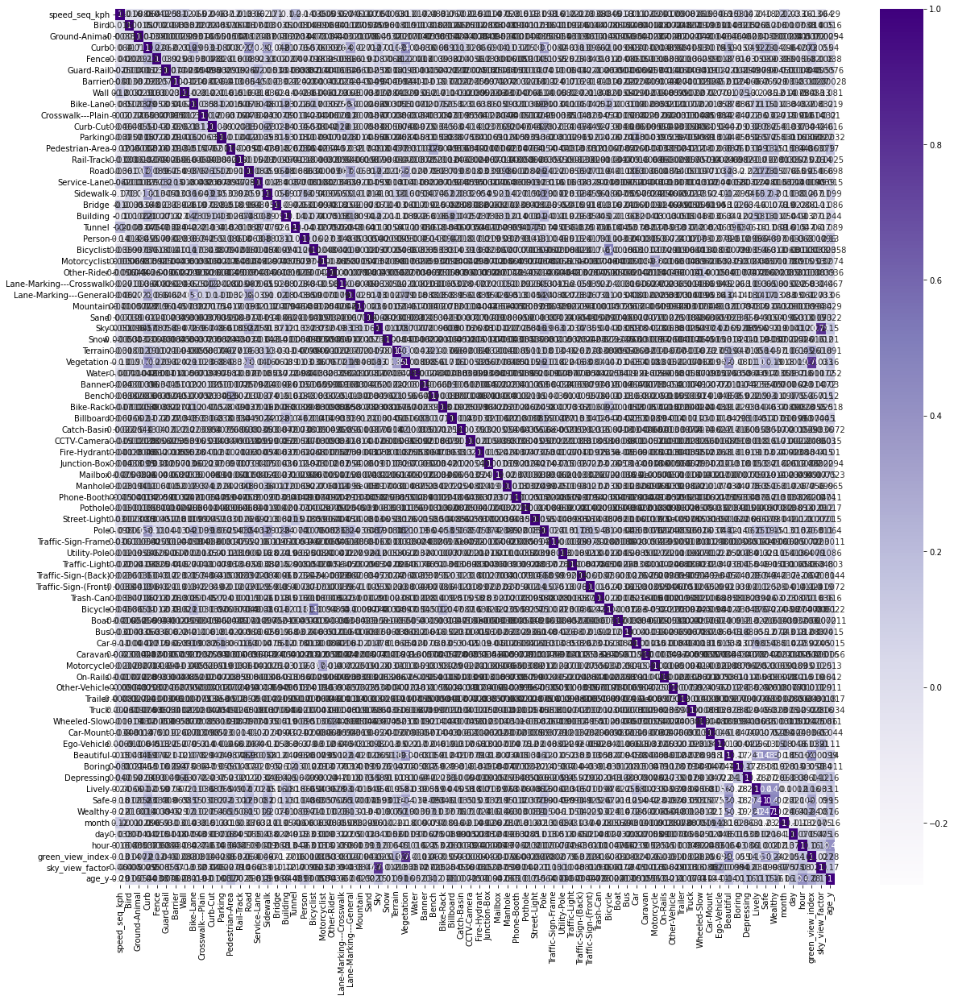

In [318]:
import matplotlib.pyplot as plt

corr = df_all_cont.corr()
plt.figure(figsize=(20,20))
sns.heatmap(corr, cmap="Purples",annot=True)
plt.show()

In [347]:
cols = [
    'Beautiful',
    'Lively',
    'Safe',
    'Wealthy',
    'Boring',
    'Depressing',
    'green_view_index',
    'sky_view_factor',
    'speed_seq_kph',
    'year',
    'month',
    'hour',
    'age_y'
]
df_all_cont = df_all[cols]

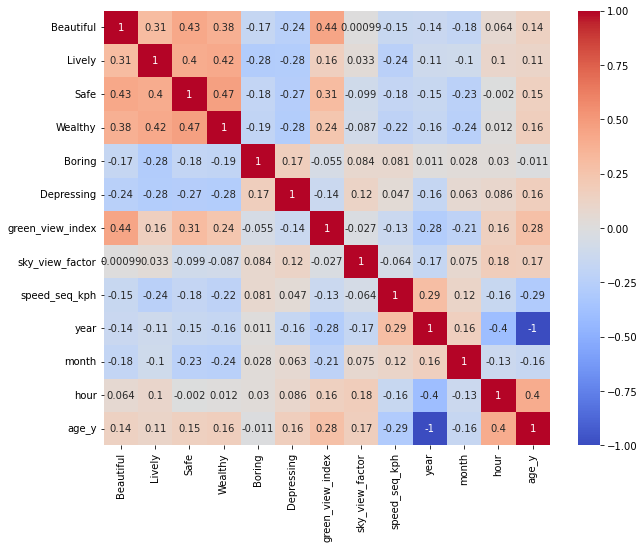

In [348]:
import matplotlib.pyplot as plt

corr = df_all_cont.corr()
plt.figure(figsize=(10,8))
sns.heatmap(corr, cmap="coolwarm",annot=True)
plt.show()

In [338]:
df_all['type_highway'].value_counts()

for driving            291088
for walking             71947
for cycling             12168
for walking/cycling      3839
others                      2
Name: type_highway, dtype: int64

In [404]:
df_dummies = pd.get_dummies(df_all['type_highway'])
df_new = pd.concat([df_all, df_dummies], axis=1)
del df_new['type_highway']
df_new.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390887 entries, 0 to 390886
Data columns (total 107 columns):
 #    Column                    Non-Null Count   Dtype  
---   ------                    --------------   -----  
 0    uuid                      390887 non-null  object 
 1    source                    390887 non-null  object 
 2    orig_id                   390887 non-null  int64  
 3    city_id                   390887 non-null  int64  
 4    pano_status               385666 non-null  object 
 5    sequenceIndex             390887 non-null  int64  
 6    sequenceId                390887 non-null  object 
 7    speed_seq_kph             390492 non-null  float64
 8    transportation_mode       390492 non-null  object 
 9    seq_img_count             390887 non-null  int64  
 10   highway                   381802 non-null  object 
 11   Bird                      335379 non-null  float64
 12   Ground-Animal             335379 non-null  float64
 13   Curb                      3

In [405]:
df_dummies = pd.get_dummies(df_new['pano_status'])
df_new = pd.concat([df_new, df_dummies], axis=1)
del df_new['pano_status']
df_new.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390887 entries, 0 to 390886
Data columns (total 108 columns):
 #    Column                    Non-Null Count   Dtype  
---   ------                    --------------   -----  
 0    uuid                      390887 non-null  object 
 1    source                    390887 non-null  object 
 2    orig_id                   390887 non-null  int64  
 3    city_id                   390887 non-null  int64  
 4    sequenceIndex             390887 non-null  int64  
 5    sequenceId                390887 non-null  object 
 6    speed_seq_kph             390492 non-null  float64
 7    transportation_mode       390492 non-null  object 
 8    seq_img_count             390887 non-null  int64  
 9    highway                   381802 non-null  object 
 10   Bird                      335379 non-null  float64
 11   Ground-Animal             335379 non-null  float64
 12   Curb                      335379 non-null  float64
 13   Fence                     3

In [406]:
df_new = df_new.rename(columns={False: 'pano_False', True: 'pano_True'})

In [407]:
df_dummies = pd.get_dummies(df_new['koppen_geiger_zone'])
df_new = pd.concat([df_new, df_dummies], axis=1)
del df_new['koppen_geiger_zone']
df_new.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390887 entries, 0 to 390886
Data columns (total 112 columns):
 #    Column                    Non-Null Count   Dtype  
---   ------                    --------------   -----  
 0    uuid                      390887 non-null  object 
 1    source                    390887 non-null  object 
 2    orig_id                   390887 non-null  int64  
 3    city_id                   390887 non-null  int64  
 4    sequenceIndex             390887 non-null  int64  
 5    sequenceId                390887 non-null  object 
 6    speed_seq_kph             390492 non-null  float64
 7    transportation_mode       390492 non-null  object 
 8    seq_img_count             390887 non-null  int64  
 9    highway                   381802 non-null  object 
 10   Bird                      335379 non-null  float64
 11   Ground-Animal             335379 non-null  float64
 12   Curb                      335379 non-null  float64
 13   Fence                     3

In [408]:
df_dummies = pd.get_dummies(df_new['season'])
df_new = pd.concat([df_new, df_dummies], axis=1)
del df_new['season']
df_new.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390887 entries, 0 to 390886
Data columns (total 116 columns):
 #    Column                    Non-Null Count   Dtype  
---   ------                    --------------   -----  
 0    uuid                      390887 non-null  object 
 1    source                    390887 non-null  object 
 2    orig_id                   390887 non-null  int64  
 3    city_id                   390887 non-null  int64  
 4    sequenceIndex             390887 non-null  int64  
 5    sequenceId                390887 non-null  object 
 6    speed_seq_kph             390492 non-null  float64
 7    transportation_mode       390492 non-null  object 
 8    seq_img_count             390887 non-null  int64  
 9    highway                   381802 non-null  object 
 10   Bird                      335379 non-null  float64
 11   Ground-Animal             335379 non-null  float64
 12   Curb                      335379 non-null  float64
 13   Fence                     3

In [409]:
df_dummies = pd.get_dummies(df_new['calculated_day_night']).rename(columns={'day': 'lighting_day', 'night': 'lighting_night'})
df_new = pd.concat([df_new, df_dummies], axis=1)
del df_new['calculated_day_night']
df_new.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390887 entries, 0 to 390886
Data columns (total 117 columns):
 #    Column                    Non-Null Count   Dtype  
---   ------                    --------------   -----  
 0    uuid                      390887 non-null  object 
 1    source                    390887 non-null  object 
 2    orig_id                   390887 non-null  int64  
 3    city_id                   390887 non-null  int64  
 4    sequenceIndex             390887 non-null  int64  
 5    sequenceId                390887 non-null  object 
 6    speed_seq_kph             390492 non-null  float64
 7    transportation_mode       390492 non-null  object 
 8    seq_img_count             390887 non-null  int64  
 9    highway                   381802 non-null  object 
 10   Bird                      335379 non-null  float64
 11   Ground-Animal             335379 non-null  float64
 12   Curb                      335379 non-null  float64
 13   Fence                     3

In [410]:
cols = [
    'Beautiful',
    'Lively',
    'Safe',
    'Wealthy',
    'Boring',
    'Depressing',
    'green_view_index',
    'sky_view_factor',
    'speed_seq_kph',
    'year',
    'month',
    'hour',
    'age_y',
    'for cycling',
    'for driving',
    'for walking',
    'for walking/cycling',
    'others',
    'pano_False',
    'pano_True',
    'Af',
    'BSh',
    'BSk',
    'Cfa',
    'Cfb',
    'Autumn',
    'Spring',
    'Summer',
    'Tropical',
    'Winter',
    'lighting_day',
    'lighting_night'
]
df_for_corr = df_new[cols]

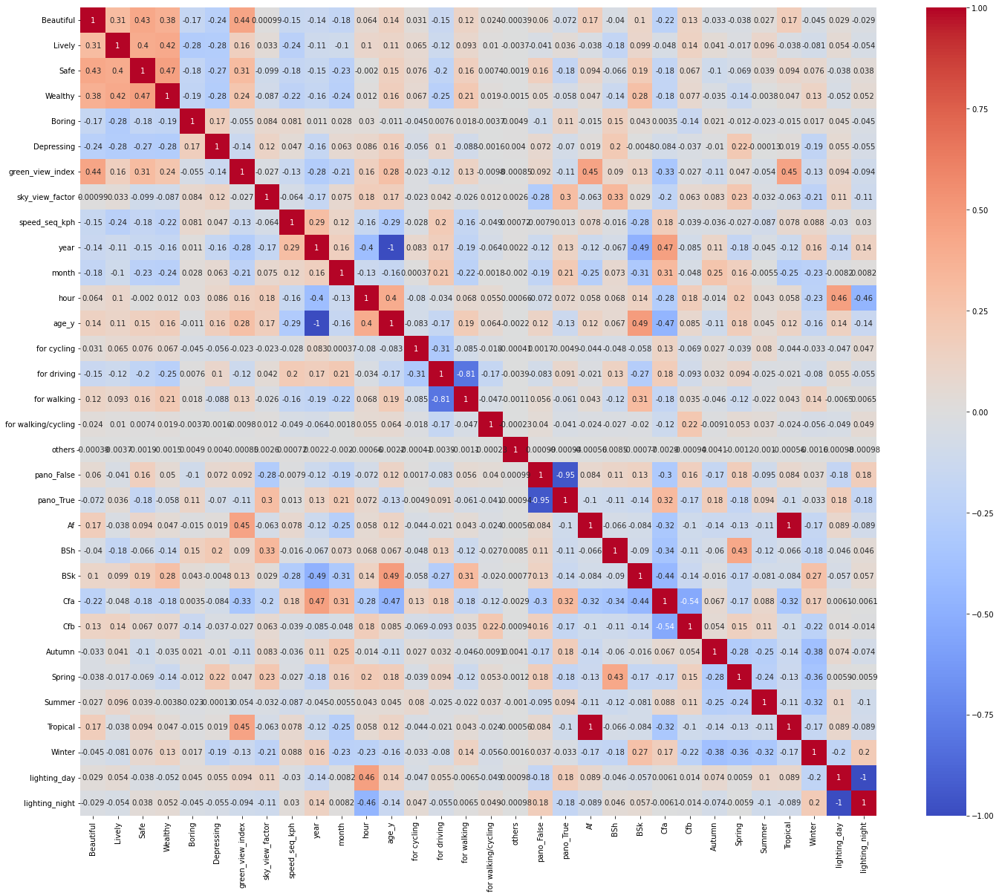

In [411]:
import matplotlib.pyplot as plt

corr = df_for_corr.corr()
plt.figure(figsize=(24,20))
sns.heatmap(corr, cmap="coolwarm",annot=True)
plt.show()

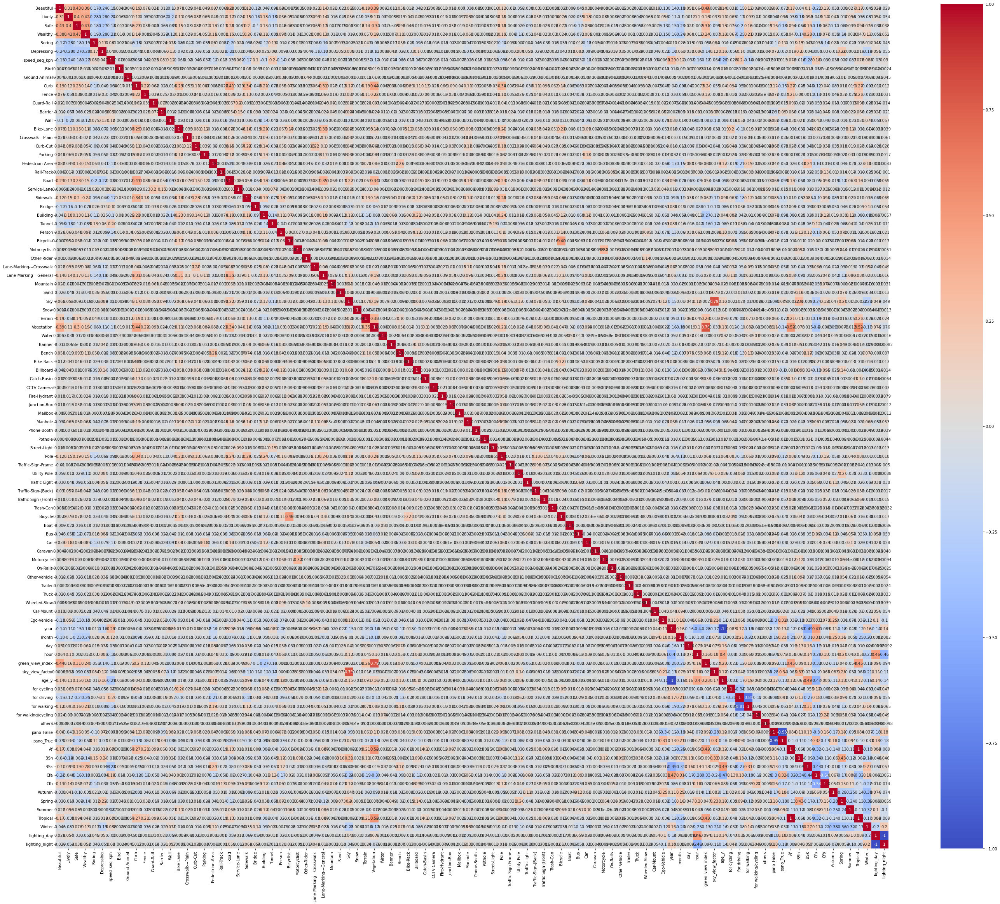

In [444]:
cols = [
    'Beautiful',
    'Lively',
    'Safe',
    'Wealthy',
    'Boring',
    'Depressing',
 'speed_seq_kph',
 'Bird',
 'Ground-Animal',
 'Curb',
 'Fence',
 'Guard-Rail',
 'Barrier',
 'Wall',
 'Bike-Lane',
 'Crosswalk---Plain',
 'Curb-Cut',
 'Parking',
 'Pedestrian-Area',
 'Rail-Track',
 'Road',
 'Service-Lane',
 'Sidewalk',
 'Bridge',
 'Building',
 'Tunnel',
 'Person',
 'Bicyclist',
 'Motorcyclist',
 'Other-Rider',
 'Lane-Marking---Crosswalk',
 'Lane-Marking---General',
 'Mountain',
 'Sand',
 'Sky',
 'Snow',
 'Terrain',
 'Vegetation',
 'Water',
 'Banner',
 'Bench',
 'Bike-Rack',
 'Billboard',
 'Catch-Basin',
 'CCTV-Camera',
 'Fire-Hydrant',
 'Junction-Box',
 'Mailbox',
 'Manhole',
 'Phone-Booth',
 'Pothole',
 'Street-Light',
 'Pole',
 'Traffic-Sign-Frame',
 'Utility-Pole',
 'Traffic-Light',
 'Traffic-Sign-(Back)',
 'Traffic-Sign-(Front)',
 'Trash-Can',
 'Bicycle',
 'Boat',
 'Bus',
 'Car',
 'Caravan',
 'Motorcycle',
 'On-Rails',
 'Other-Vehicle',
 'Trailer',
 'Truck',
 'Wheeled-Slow',
 'Car-Mount',
 'Ego-Vehicle',
 'year',
 'month',
 'day',
 'hour',
 'green_view_index',
 'sky_view_factor',
 'age_y',
 'for cycling',
 'for driving',
 'for walking',
 'for walking/cycling',
 'others',
 'pano_False',
 'pano_True',
 'Af',
 'BSh',
 'BSk',
 'Cfa',
 'Cfb',
 'Autumn',
 'Spring',
 'Summer',
 'Tropical',
 'Winter',
 'lighting_day',
 'lighting_night']

df_for_corr = df_new[cols]

import matplotlib.pyplot as plt

corr = df_for_corr.corr()
plt.figure(figsize=(48,40))
sns.heatmap(corr, cmap="coolwarm",annot=True)
plt.show()

In [446]:
selected_cities = pd.read_csv('/Users/yujun/Data/global_streetscapes/use_cases/selected_cities.csv').drop(columns=['Unnamed: 0'])
selected_cities

,city,city_ascii,city_id,city_lat,city_lon,country,iso2,iso3,admin_name,capital,population,continent,koppen_geiger_zone,zone_description,img_count
0,Baku,Baku,1031946365,40.3667,49.8352,Azerbaijan,AZ,AZE,Bakı,primary,2181800.0,Asia,BSk,Mid-latitude steppe,29290
1,Zagreb,Zagreb,1191233290,45.8131,15.9772,Croatia,HR,HRV,"Zagreb, Grad",primary,790017.0,Europe,Cfb,"Marine west coast, warm summer",34100
2,Ulaanbaatar,Ulaanbaatar,1496024767,47.9214,106.9055,Mongolia,MN,MNG,Ulaanbaatar,primary,1396288.0,Asia,BSk,Mid-latitude steppe,11131
3,Washington,Washington,1840006060,38.9047,-77.0163,United States,US,USA,District of Columbia,primary,5379184.0,North America,Cfa,"Humid subtropical, no dry season",207103
4,Asunción,Asuncion,1600057911,-25.3000,-57.6333,Paraguay,PY,PRY,Asunción,primary,524190.0,South America,Cfa,"Humid subtropical, no dry season",37687
5,Singapore,Singapore,1702341327,1.3000,103.8000,Singapore,SG,SGP,Central Singapore,primary,5271000.0,Asia,Af,Tropical rainforest,23047
6,Wellington,Wellington,1554772152,-41.2889,174.7772,New Zealand,NZ,NZL,Wellington,primary,418500.0,Oceania,Cfb,"Marine west coast, warm summer",23139
7,Dodoma,Dodoma,1834288497,-6.1835,35.7460,Tanzania,TZ,TZA,Dodoma,primary,410956.0,Africa,BSh,Subtropical steppe,25858


In [447]:
df_new = df_new.merge(selected_cities[['city_id', 'continent']], on='city_id', how='left')
df_new.continent.value_counts()

North America    207103
Asia              63000
South America     37687
Europe            34100
Africa            25858
Oceania           23139
Name: continent, dtype: int64

In [448]:
df_dummies = pd.get_dummies(df_new['continent'])
df_new = pd.concat([df_new, df_dummies], axis=1)
del df_new['continent']
df_new.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 390887 entries, 0 to 390886
Data columns (total 123 columns):
 #    Column                    Non-Null Count   Dtype  
---   ------                    --------------   -----  
 0    uuid                      390887 non-null  object 
 1    source                    390887 non-null  object 
 2    orig_id                   390887 non-null  int64  
 3    city_id                   390887 non-null  int64  
 4    sequenceIndex             390887 non-null  int64  
 5    sequenceId                390887 non-null  object 
 6    speed_seq_kph             390492 non-null  float64
 7    transportation_mode       390492 non-null  object 
 8    seq_img_count             390887 non-null  int64  
 9    highway                   381802 non-null  object 
 10   Bird                      335379 non-null  float64
 11   Ground-Animal             335379 non-null  float64
 12   Curb                      335379 non-null  float64
 13   Fence                     3

In [449]:
df_new.columns.tolist()

['uuid',
 'source',
 'orig_id',
 'city_id',
 'sequenceIndex',
 'sequenceId',
 'speed_seq_kph',
 'transportation_mode',
 'seq_img_count',
 'highway',
 'Bird',
 'Ground-Animal',
 'Curb',
 'Fence',
 'Guard-Rail',
 'Barrier',
 'Wall',
 'Bike-Lane',
 'Crosswalk---Plain',
 'Curb-Cut',
 'Parking',
 'Pedestrian-Area',
 'Rail-Track',
 'Road',
 'Service-Lane',
 'Sidewalk',
 'Bridge',
 'Building',
 'Tunnel',
 'Person',
 'Bicyclist',
 'Motorcyclist',
 'Other-Rider',
 'Lane-Marking---Crosswalk',
 'Lane-Marking---General',
 'Mountain',
 'Sand',
 'Sky',
 'Snow',
 'Terrain',
 'Vegetation',
 'Water',
 'Banner',
 'Bench',
 'Bike-Rack',
 'Billboard',
 'Catch-Basin',
 'CCTV-Camera',
 'Fire-Hydrant',
 'Junction-Box',
 'Mailbox',
 'Manhole',
 'Phone-Booth',
 'Pothole',
 'Street-Light',
 'Pole',
 'Traffic-Sign-Frame',
 'Utility-Pole',
 'Traffic-Light',
 'Traffic-Sign-(Back)',
 'Traffic-Sign-(Front)',
 'Trash-Can',
 'Bicycle',
 'Boat',
 'Bus',
 'Car',
 'Caravan',
 'Motorcycle',
 'On-Rails',
 'Other-Vehicle',


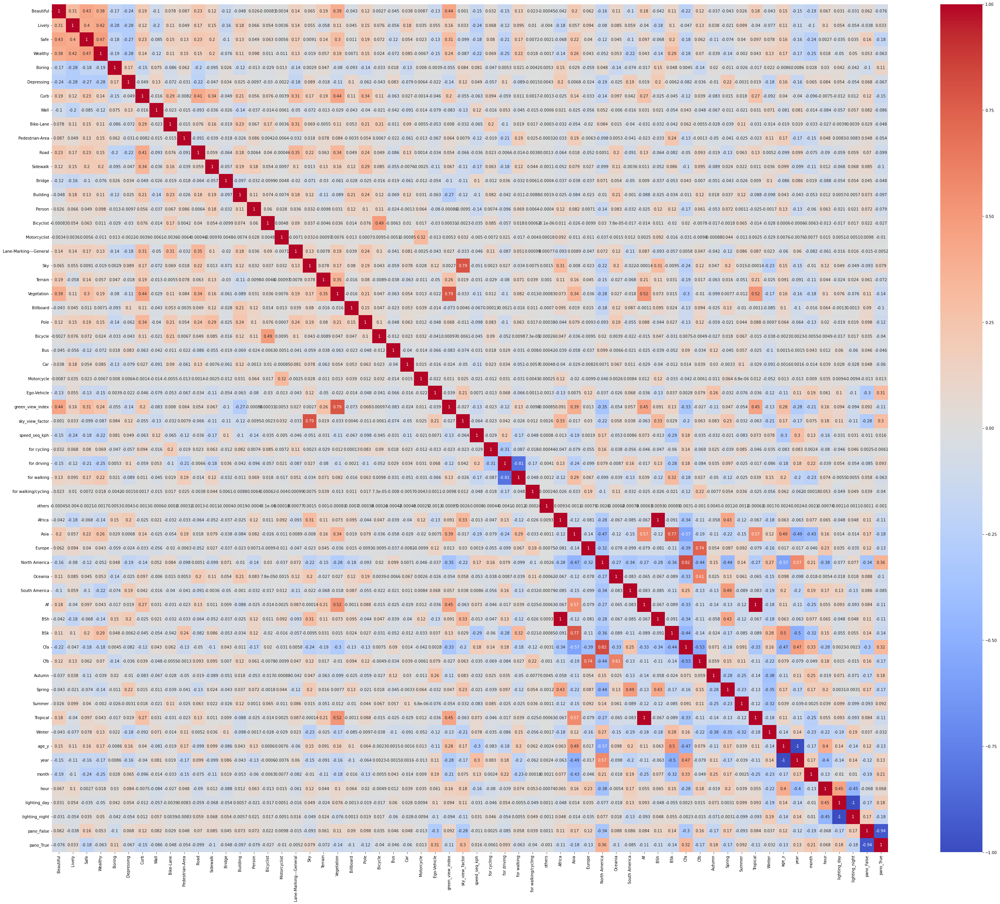

In [451]:
cols = [
     'Beautiful',
 'Lively',
 'Safe',
 'Wealthy',
     'Boring',
 'Depressing',
 'Curb',
 'Wall',
 'Bike-Lane',
 'Pedestrian-Area',
 'Road',
 'Sidewalk',
 'Bridge',
 'Building',
 'Person',
 'Bicyclist',
 'Motorcyclist',
 'Lane-Marking---General',
 'Sky',
 'Terrain',
 'Vegetation',
 'Billboard',
 'Pole',
 'Bicycle',
 'Bus',
 'Car',
 'Motorcycle',
 'Ego-Vehicle',
 'green_view_index',
 'sky_view_factor',
     'speed_seq_kph',
 'for cycling',
 'for driving',
 'for walking',
 'for walking/cycling',
 'others',
     'Africa',
 'Asia',
 'Europe',
 'North America',
 'Oceania',
 'South America',
 'Af',
 'BSh',
 'BSk',
 'Cfa',
 'Cfb',
 'Autumn',
 'Spring',
 'Summer',
 'Tropical',
 'Winter',
     'age_y',
     'year',
 'month',
 'hour',
 'lighting_day',
 'lighting_night',
     'pano_False',
 'pano_True']

df_for_corr = df_new[cols].dropna()

import matplotlib.pyplot as plt

corr = df_for_corr.corr()
plt.figure(figsize=(48,40))
sns.heatmap(corr, cmap="coolwarm",annot=True)
plt.show()

### Multiple linear regression

In [413]:
xcols = [
    'green_view_index',
    'sky_view_factor',
    'speed_seq_kph',
    'year',
    'month',
    'hour',
    'age_y',
    'for cycling',
    'for driving',
    'for walking',
    'for walking/cycling',
    'others',
    'pano_False',
    'pano_True',
    'Af',
    'BSh',
    'BSk',
    'Cfa',
    'Cfb',
    'Autumn',
    'Spring',
    'Summer',
    'Tropical',
    'Winter',
    'lighting_day',
    'lighting_night'
]
df_for_mlr = df_for_corr.dropna()
x = df_for_mlr[xcols]
y = df_for_mlr['Beautiful']

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

from sklearn.linear_model import LinearRegression
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

print("Intercept: ", mlr.intercept_)
print("Coefficients:")
print(list(zip(x, mlr.coef_)))

#Prediction of test set
y_pred_mlr= mlr.predict(x_test)

#Model Evaluation
from sklearn import metrics
meanAbErr = metrics.mean_absolute_error(y_test, y_pred_mlr)
meanSqErr = metrics.mean_squared_error(y_test, y_pred_mlr)
rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, y_pred_mlr))
r2 = metrics.r2_score(y_test, y_pred_mlr)
#print('R squared: {:.2f}'.format(mlr.score(x,y)))
print('R squared: {:.2f}'.format(r2))
print('Mean Absolute Error:', meanAbErr)
print('Mean Square Error:', meanSqErr)
print('Root Mean Square Error:', rootMeanSqErr)

Intercept:  21512865057893.67
Coefficients:
[('green_view_index', 6.42752648095169), ('sky_view_factor', 0.7338794683825126), ('speed_seq_kph', -0.015416550750020241), ('year', -10663855587.629509), ('month', -0.04219431241650473), ('hour', -0.020485492845555425), ('age_y', -10663855587.63918), ('for cycling', 0.3344797462351523), ('for driving', -0.2959433736314143), ('for walking', -0.07842854831704749), ('for walking/cycling', -0.26144254029244307), ('others', -0.039674052205033034), ('pano_False', -0.1858336693406302), ('pano_True', -0.29905382539869035), ('Af', 10137166508.17196), ('BSh', 55234247198.924805), ('BSk', 55234247199.45173), ('Cfa', 55234247199.40387), ('Cfb', 55234247200.30269), ('Autumn', -20131936861.898876), ('Spring', -20131936862.202442), ('Summer', -20131936861.83402), ('Tropical', 24965143829.16894), ('Winter', -20131936861.88427), ('lighting_day', 25012485548.29707), ('lighting_night', 25012485548.28443)]
R squared: 0.24
Mean Absolute Error: 1.7884354669900808

In [414]:
xcols = [
    'green_view_index',
    'sky_view_factor',
    'speed_seq_kph',
    'month',
    'hour',
    'age_y'
]
df_for_mlr = df_for_corr.dropna()
x = df_for_mlr[xcols]
y = df_for_mlr['Beautiful']

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

from sklearn.linear_model import LinearRegression
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

print("Intercept: ", mlr.intercept_)
print("Coefficients:")
print(list(zip(x, mlr.coef_)))

#Prediction of test set
y_pred_mlr= mlr.predict(x_test)

#Model Evaluation
from sklearn import metrics
meanAbErr = metrics.mean_absolute_error(y_test, y_pred_mlr)
meanSqErr = metrics.mean_squared_error(y_test, y_pred_mlr)
rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, y_pred_mlr))
r2 = metrics.r2_score(y_test, y_pred_mlr)
#print('R squared: {:.2f}'.format(mlr.score(x,y)))
print('R squared: {:.2f}'.format(r2))
print('Mean Absolute Error:', meanAbErr)
print('Mean Square Error:', meanSqErr)
print('Root Mean Square Error:', rootMeanSqErr)

Intercept:  4.80712905654224
Coefficients:
[('green_view_index', 6.1165072654419275), ('sky_view_factor', 0.30401487222819823), ('speed_seq_kph', -0.0181928875349249), ('month', -0.06003289919986278), ('hour', -0.015387601896006908), ('age_y', -0.004085547841278417)]
R squared: 0.21
Mean Absolute Error: 1.8281130741539113
Mean Square Error: 4.753950339606735
Root Mean Square Error: 2.1803555534835906


In [415]:
xcols = [
    'green_view_index',
    'sky_view_factor',
    'speed_seq_kph',
    'month',
    'hour',
    'age_y'
]
df_for_mlr = df_for_corr.dropna()
x = df_for_mlr[xcols]
y = df_for_mlr['Beautiful']

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

from sklearn.linear_model import LinearRegression
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

print("Intercept: ", mlr.intercept_)
print("Coefficients:")
print(list(zip(x, mlr.coef_)))

#Prediction of test set
y_pred_mlr= mlr.predict(x_test)

#Model Evaluation
from sklearn import metrics
meanAbErr = metrics.mean_absolute_error(y_test, y_pred_mlr)
meanSqErr = metrics.mean_squared_error(y_test, y_pred_mlr)
rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, y_pred_mlr))
r2 = metrics.r2_score(y_test, y_pred_mlr)
#print('R squared: {:.2f}'.format(mlr.score(x,y)))
print('R squared: {:.2f}'.format(r2))
print('Mean Absolute Error:', meanAbErr)
print('Mean Square Error:', meanSqErr)
print('Root Mean Square Error:', rootMeanSqErr)

Intercept:  4.80712905654224
Coefficients:
[('green_view_index', 6.1165072654419275), ('sky_view_factor', 0.30401487222819823), ('speed_seq_kph', -0.0181928875349249), ('month', -0.06003289919986278), ('hour', -0.015387601896006908), ('age_y', -0.004085547841278417)]
R squared: 0.21
Mean Absolute Error: 1.8281130741539113
Mean Square Error: 4.753950339606735
Root Mean Square Error: 2.1803555534835906


### Random forest regression

In [395]:
# baseline

In [417]:
xcols = [
    'green_view_index',
    'sky_view_factor',
    'speed_seq_kph',
    'year',
    'month',
    'hour',
    'age_y',
    'for cycling',
    'for driving',
    'for walking',
    'for walking/cycling',
    'others',
    'pano_False',
    'pano_True',
    'Af',
    'BSh',
    'BSk',
    'Cfa',
    'Cfb',
    'Autumn',
    'Spring',
    'Summer',
    'Tropical',
    'Winter',
    'lighting_day',
    'lighting_night'
]
df_for_mlr = df_for_corr.dropna()
x = df_for_mlr[xcols]
y = df_for_mlr['Beautiful']

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

# Import the model we are using
from sklearn.ensemble import RandomForestRegressor

# Instantiate model with 1000 decision trees
rf = RandomForestRegressor(n_estimators = 10, max_depth = 10, random_state = 100)

# Train the model on training data
rf.fit(x_train, y_train)

# Use the forest's predict method on the test data
predictions = rf.predict(x_test)

#Model Evaluation
from sklearn import metrics
meanAbErr = metrics.mean_absolute_error(y_test, predictions)
meanSqErr = metrics.mean_squared_error(y_test, predictions)
rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, predictions))
r2 = metrics.r2_score(y_test, predictions)
#print('R squared: {:.2f}'.format(mlr.score(x,y)))
print('R squared: {:.2f}'.format(r2))
print('Mean Absolute Error:', meanAbErr)
print('Mean Square Error:', meanSqErr)
print('Root Mean Square Error:', rootMeanSqErr)

R squared: 0.39
Mean Absolute Error: 1.5635685371201207
Mean Square Error: 3.6535677488469473
Root Mean Square Error: 1.9114308119434895


Text(0.5, 1.0, 'Global Feature Importance - Built-in Method')

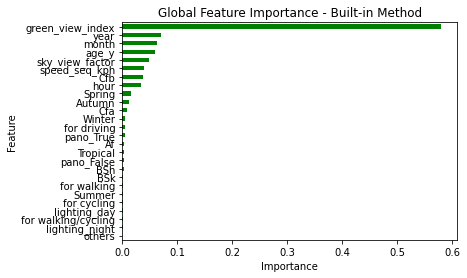

In [418]:
global_importances = pd.Series(rf.feature_importances_, index=x_train.columns)
global_importances.sort_values(ascending=True, inplace=True)
global_importances.plot.barh(color='green')
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Global Feature Importance - Built-in Method")

In [419]:
xcols = [
    'green_view_index',
    'sky_view_factor',
    'speed_seq_kph',
    'year',
    'month',
    'hour',
    'age_y',
    'for cycling',
    'for driving',
    'for walking',
    'for walking/cycling',
    'others',
    'pano_False',
    'pano_True',
    'Af',
    'BSh',
    'BSk',
    'Cfa',
    'Cfb',
    'Autumn',
    'Spring',
    'Summer',
    'Tropical',
    'Winter',
    'lighting_day',
    'lighting_night'
]
df_for_mlr = df_for_corr.dropna()
x = df_for_mlr[xcols]
y = df_for_mlr['Beautiful']

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

# Import the model we are using
from sklearn.ensemble import RandomForestRegressor

# Instantiate model with 1000 decision trees
rf = RandomForestRegressor(n_estimators = 100, max_depth = 10, random_state = 100)

# Train the model on training data
rf.fit(x_train, y_train)

# Use the forest's predict method on the test data
predictions = rf.predict(x_test)

#Model Evaluation
from sklearn import metrics
meanAbErr = metrics.mean_absolute_error(y_test, predictions)
meanSqErr = metrics.mean_squared_error(y_test, predictions)
rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, predictions))
r2 = metrics.r2_score(y_test, predictions)
#print('R squared: {:.2f}'.format(mlr.score(x,y)))
print('R squared: {:.2f}'.format(r2))
print('Mean Absolute Error:', meanAbErr)
print('Mean Square Error:', meanSqErr)
print('Root Mean Square Error:', rootMeanSqErr)

R squared: 0.40
Mean Absolute Error: 1.5595310784434424
Mean Square Error: 3.6299484127888184
Root Mean Square Error: 1.9052423501457285


Text(0.5, 1.0, 'Global Feature Importance - Built-in Method')

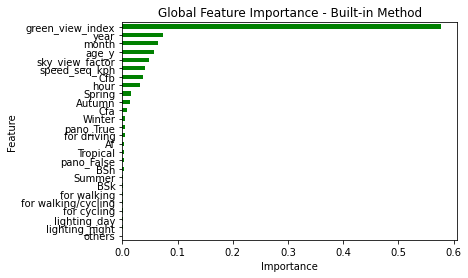

In [420]:
global_importances = pd.Series(rf.feature_importances_, index=x_train.columns)
global_importances.sort_values(ascending=True, inplace=True)
global_importances.plot.barh(color='green')
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Global Feature Importance - Built-in Method")

In [421]:
xcols = [
    'green_view_index',
    'sky_view_factor',
    'speed_seq_kph',
    'year',
    'month',
    'hour',
    'age_y',
    'for cycling',
    'for driving',
    'for walking',
    'for walking/cycling',
    'others',
    'pano_False',
    'pano_True',
    'Af',
    'BSh',
    'BSk',
    'Cfa',
    'Cfb',
    'Autumn',
    'Spring',
    'Summer',
    'Tropical',
    'Winter',
    'lighting_day',
    'lighting_night'
]
df_for_mlr = df_for_corr.dropna()
x = df_for_mlr[xcols]
y = df_for_mlr['Beautiful']

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

# Import the model we are using
from sklearn.ensemble import RandomForestRegressor

# Instantiate model with 1000 decision trees
rf = RandomForestRegressor(n_estimators = 100, max_depth = 50, random_state = 100)

# Train the model on training data
rf.fit(x_train, y_train)

# Use the forest's predict method on the test data
predictions = rf.predict(x_test)

#Model Evaluation
from sklearn import metrics
meanAbErr = metrics.mean_absolute_error(y_test, predictions)
meanSqErr = metrics.mean_squared_error(y_test, predictions)
rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, predictions))
r2 = metrics.r2_score(y_test, predictions)
#print('R squared: {:.2f}'.format(mlr.score(x,y)))
print('R squared: {:.2f}'.format(r2))
print('Mean Absolute Error:', meanAbErr)
print('Mean Square Error:', meanSqErr)
print('Root Mean Square Error:', rootMeanSqErr)

R squared: 0.48
Mean Absolute Error: 1.4048691077357134
Mean Square Error: 3.1522465238737603
Root Mean Square Error: 1.7754567085326975


Text(0.5, 1.0, 'Global Feature Importance - Built-in Method')

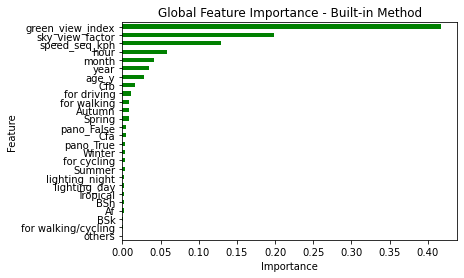

In [422]:
global_importances = pd.Series(rf.feature_importances_, index=x_train.columns)
global_importances.sort_values(ascending=True, inplace=True)
global_importances.plot.barh(color='green')
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Global Feature Importance - Built-in Method")

In [423]:
xcols = [
    'green_view_index',
    'sky_view_factor',
    'speed_seq_kph',
    'year',
    'month',
    'hour',
    'age_y',
    'for cycling',
    'for driving',
    'for walking',
    'for walking/cycling',
    'others',
    'pano_False',
    'pano_True',
    'Af',
    'BSh',
    'BSk',
    'Cfa',
    'Cfb',
    'Autumn',
    'Spring',
    'Summer',
    'Tropical',
    'Winter',
    'lighting_day',
    'lighting_night'
]
df_for_mlr = df_for_corr.dropna()
x = df_for_mlr[xcols]
y = df_for_mlr['Beautiful']

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

# Import the model we are using
from sklearn.ensemble import RandomForestRegressor

# Instantiate model with 100 decision trees
rf = RandomForestRegressor(n_estimators = 100, max_depth = 100, random_state = 100)

# Train the model on training data
rf.fit(x_train, y_train)

# Use the forest's predict method on the test data
predictions = rf.predict(x_test)

#Model Evaluation
from sklearn import metrics
meanAbErr = metrics.mean_absolute_error(y_test, predictions)
meanSqErr = metrics.mean_squared_error(y_test, predictions)
rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, predictions))
r2 = metrics.r2_score(y_test, predictions)
#print('R squared: {:.2f}'.format(mlr.score(x,y)))
print('R squared: {:.2f}'.format(r2))
print('Mean Absolute Error:', meanAbErr)
print('Mean Square Error:', meanSqErr)
print('Root Mean Square Error:', rootMeanSqErr)

R squared: 0.48
Mean Absolute Error: 1.4049691176444976
Mean Square Error: 3.152530392814197
Root Mean Square Error: 1.7755366492455729


Text(0.5, 1.0, 'Global Feature Importance - Built-in Method')

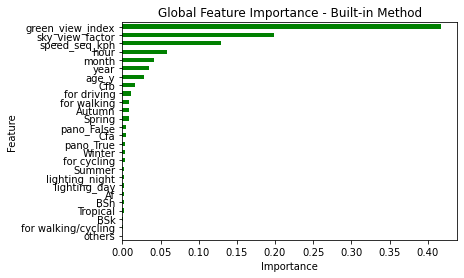

In [424]:
global_importances = pd.Series(rf.feature_importances_, index=x_train.columns)
global_importances.sort_values(ascending=True, inplace=True)
global_importances.plot.barh(color='green')
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Global Feature Importance - Built-in Method")

In [ ]:
# n_estimators = 10, max_depth = 10, random_state = 100
# R squared: 0.39
# Mean Absolute Error: 1.5635685371201207
# Mean Square Error: 3.6535677488469473
# Root Mean Square Error: 1.9114308119434895

# n_estimators = 100, max_depth = 10, random_state = 100
# R squared: 0.40
# Mean Absolute Error: 1.5595310784434424
# Mean Square Error: 3.6299484127888184
# Root Mean Square Error: 1.9052423501457285

# n_estimators = 100, max_depth = 50, random_state = 100
# R squared: 0.48
# Mean Absolute Error: 1.4048691077357134
# Mean Square Error: 3.1522465238737603
# Root Mean Square Error: 1.7754567085326975

# n_estimators = 100, max_depth = 100, random_state = 100
# R squared: 0.48
# Mean Absolute Error: 1.4049691176444976
# Mean Square Error: 3.152530392814197
# Root Mean Square Error: 1.7755366492455729

In [432]:
df_new.columns.tolist()

['uuid',
 'source',
 'orig_id',
 'city_id',
 'sequenceIndex',
 'sequenceId',
 'speed_seq_kph',
 'transportation_mode',
 'seq_img_count',
 'highway',
 'Bird',
 'Ground-Animal',
 'Curb',
 'Fence',
 'Guard-Rail',
 'Barrier',
 'Wall',
 'Bike-Lane',
 'Crosswalk---Plain',
 'Curb-Cut',
 'Parking',
 'Pedestrian-Area',
 'Rail-Track',
 'Road',
 'Service-Lane',
 'Sidewalk',
 'Bridge',
 'Building',
 'Tunnel',
 'Person',
 'Bicyclist',
 'Motorcyclist',
 'Other-Rider',
 'Lane-Marking---Crosswalk',
 'Lane-Marking---General',
 'Mountain',
 'Sand',
 'Sky',
 'Snow',
 'Terrain',
 'Vegetation',
 'Water',
 'Banner',
 'Bench',
 'Bike-Rack',
 'Billboard',
 'Catch-Basin',
 'CCTV-Camera',
 'Fire-Hydrant',
 'Junction-Box',
 'Mailbox',
 'Manhole',
 'Phone-Booth',
 'Pothole',
 'Street-Light',
 'Pole',
 'Traffic-Sign-Frame',
 'Utility-Pole',
 'Traffic-Light',
 'Traffic-Sign-(Back)',
 'Traffic-Sign-(Front)',
 'Trash-Can',
 'Bicycle',
 'Boat',
 'Bus',
 'Car',
 'Caravan',
 'Motorcycle',
 'On-Rails',
 'Other-Vehicle',


In [437]:
xcols = [
 'speed_seq_kph',
 'Bird',
 'Ground-Animal',
 'Curb',
 'Fence',
 'Guard-Rail',
 'Barrier',
 'Wall',
 'Bike-Lane',
 'Crosswalk---Plain',
 'Curb-Cut',
 'Parking',
 'Pedestrian-Area',
 'Rail-Track',
 'Road',
 'Service-Lane',
 'Sidewalk',
 'Bridge',
 'Building',
 'Tunnel',
 'Person',
 'Bicyclist',
 'Motorcyclist',
 'Other-Rider',
 'Lane-Marking---Crosswalk',
 'Lane-Marking---General',
 'Mountain',
 'Sand',
 'Sky',
 'Snow',
 'Terrain',
 'Vegetation',
 'Water',
 'Banner',
 'Bench',
 'Bike-Rack',
 'Billboard',
 'Catch-Basin',
 'CCTV-Camera',
 'Fire-Hydrant',
 'Junction-Box',
 'Mailbox',
 'Manhole',
 'Phone-Booth',
 'Pothole',
 'Street-Light',
 'Pole',
 'Traffic-Sign-Frame',
 'Utility-Pole',
 'Traffic-Light',
 'Traffic-Sign-(Back)',
 'Traffic-Sign-(Front)',
 'Trash-Can',
 'Bicycle',
 'Boat',
 'Bus',
 'Car',
 'Caravan',
 'Motorcycle',
 'On-Rails',
 'Other-Vehicle',
 'Trailer',
 'Truck',
 'Wheeled-Slow',
 'Car-Mount',
 'Ego-Vehicle',
 'year',
 'month',
 'day',
 'hour',
 'green_view_index',
 'sky_view_factor',
 'age_y',
 'for cycling',
 'for driving',
 'for walking',
 'for walking/cycling',
 'others',
 'pano_False',
 'pano_True',
 'Af',
 'BSh',
 'BSk',
 'Cfa',
 'Cfb',
 'Autumn',
 'Spring',
 'Summer',
 'Tropical',
 'Winter',
 'lighting_day',
 'lighting_night']

df_for_mlr = df_new.drop(columns=['hrs_aft_sunrise', 'hrs_aft_sunset']).dropna()
x = df_for_mlr[xcols]
y = df_for_mlr['Beautiful']

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

# Import the model we are using
from sklearn.ensemble import RandomForestRegressor

# Instantiate model with 100 decision trees
rf = RandomForestRegressor(n_estimators = 100, max_depth = 50, random_state = 100)

# Train the model on training data
rf.fit(x_train, y_train)

# Use the forest's predict method on the test data
predictions = rf.predict(x_test)

#Model Evaluation
from sklearn import metrics
meanAbErr = metrics.mean_absolute_error(y_test, predictions)
meanSqErr = metrics.mean_squared_error(y_test, predictions)
rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, predictions))
r2 = metrics.r2_score(y_test, predictions)
#print('R squared: {:.2f}'.format(mlr.score(x,y)))
print('R squared: {:.2f}'.format(r2))
print('Mean Absolute Error:', meanAbErr)
print('Mean Square Error:', meanSqErr)
print('Root Mean Square Error:', rootMeanSqErr)

R squared: 0.55
Mean Absolute Error: 1.3094432138492493
Mean Square Error: 2.698802087216428
Root Mean Square Error: 1.6428031188235637


Text(0.5, 1.0, "Feature importance for predicting 'Beautiful'")

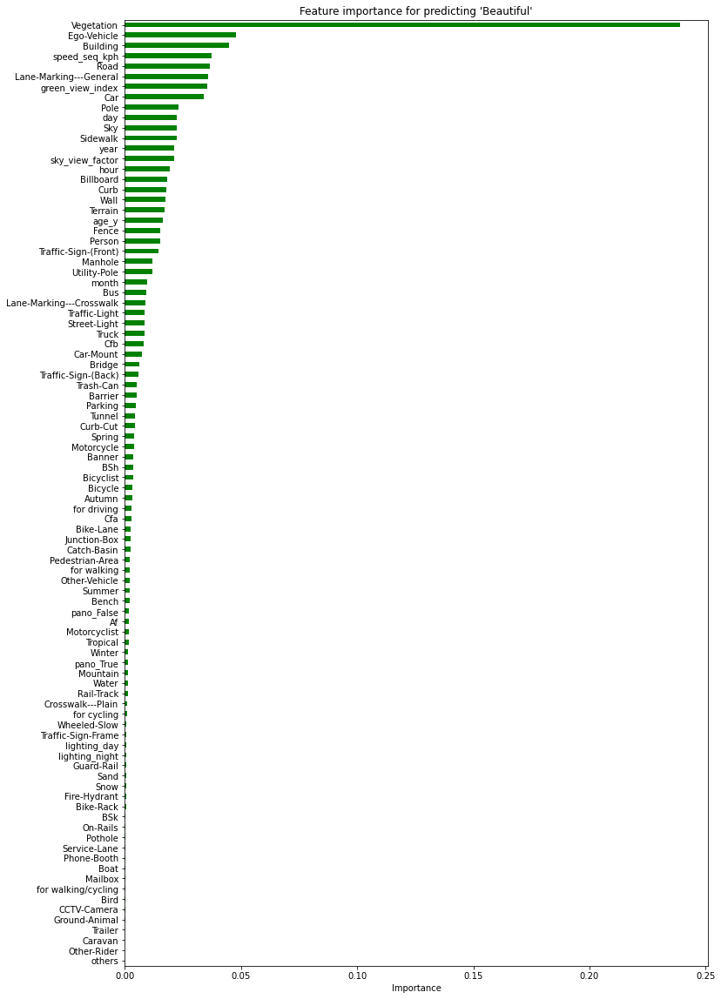

In [595]:
global_importances = pd.Series(rf.feature_importances_, index=x_train.columns)
global_importances.sort_values(ascending=True, inplace=True)
plt.figure(figsize=(12,20))
global_importances.plot.barh(color='green')
plt.xlabel("Importance")
#plt.ylabel("Feature")
plt.title("Feature importance for predicting 'Beautiful'")

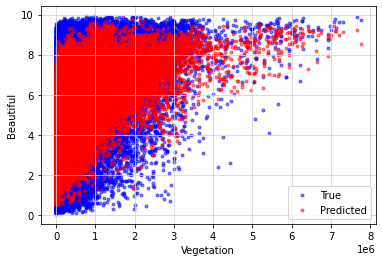

In [454]:
# Import library for visualization
import matplotlib.pyplot as plt

# Define x axis
x_axis = x_test.Vegetation

# Build scatterplot
plt.scatter(x_axis, y_test, c = 'b', alpha = 0.5, marker = '.', label = 'True')
plt.scatter(x_axis, predictions, c = 'r', alpha = 0.5, marker = '.', label = 'Predicted')
plt.xlabel('Vegetation')
plt.ylabel('Beautiful')
plt.grid(color = '#D3D3D3', linestyle = 'solid')
plt.legend(loc = 'lower right')
plt.show()

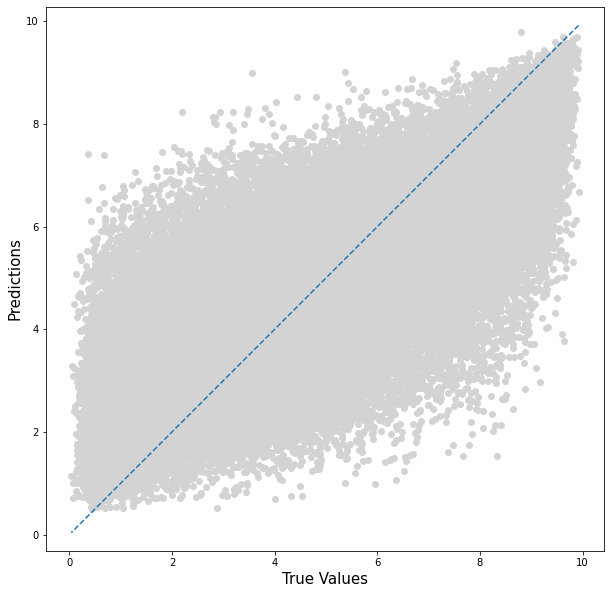

In [459]:
plt.figure(figsize=(10,10))
plt.scatter(y_test, predictions, c='lightgrey')
# plt.yscale('log')
# plt.xscale('log')

p1 = max(max(predictions), max(y_test))
p2 = min(min(predictions), min(y_test))
plt.plot([p1, p2], [p1, p2], '--')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

In [443]:
xcols = [
 'speed_seq_kph',
 'Bird',
 'Ground-Animal',
 'Curb',
 'Fence',
 'Guard-Rail',
 'Barrier',
 'Wall',
 'Bike-Lane',
 'Crosswalk---Plain',
 'Curb-Cut',
 'Parking',
 'Pedestrian-Area',
 'Rail-Track',
 'Road',
 'Service-Lane',
 'Sidewalk',
 'Bridge',
 'Building',
 'Tunnel',
 'Person',
 'Bicyclist',
 'Motorcyclist',
 'Other-Rider',
 'Lane-Marking---Crosswalk',
 'Lane-Marking---General',
 'Mountain',
 'Sand',
 'Sky',
 'Snow',
 'Terrain',
 'Vegetation',
 'Water',
 'Banner',
 'Bench',
 'Bike-Rack',
 'Billboard',
 'Catch-Basin',
 'CCTV-Camera',
 'Fire-Hydrant',
 'Junction-Box',
 'Mailbox',
 'Manhole',
 'Phone-Booth',
 'Pothole',
 'Street-Light',
 'Pole',
 'Traffic-Sign-Frame',
 'Utility-Pole',
 'Traffic-Light',
 'Traffic-Sign-(Back)',
 'Traffic-Sign-(Front)',
 'Trash-Can',
 'Bicycle',
 'Boat',
 'Bus',
 'Car',
 'Caravan',
 'Motorcycle',
 'On-Rails',
 'Other-Vehicle',
 'Trailer',
 'Truck',
 'Wheeled-Slow',
 'Car-Mount',
 'Ego-Vehicle',
 'year',
 'month',
 'day',
 'hour',
 'green_view_index',
 'sky_view_factor',
 'age_y',
 'for cycling',
 'for driving',
 'for walking',
 'for walking/cycling',
 'others',
 'pano_False',
 'pano_True',
 'Af',
 'BSh',
 'BSk',
 'Cfa',
 'Cfb',
 'Autumn',
 'Spring',
 'Summer',
 'Tropical',
 'Winter',
 'lighting_day',
 'lighting_night']

df_for_mlr = df_new.drop(columns=['hrs_aft_sunrise', 'hrs_aft_sunset']).dropna()
x = df_for_mlr[xcols]
y = df_for_mlr['Beautiful']

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

# Import the model we are using
from sklearn.ensemble import RandomForestRegressor

# Instantiate model with 100 decision trees
rf = RandomForestRegressor(n_estimators = 100, max_depth = 100, random_state = 100)

# Train the model on training data
rf.fit(x_train, y_train)

# Use the forest's predict method on the test data
predictions = rf.predict(x_test)

#Model Evaluation
from sklearn import metrics
meanAbErr = metrics.mean_absolute_error(y_test, predictions)
meanSqErr = metrics.mean_squared_error(y_test, predictions)
rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, predictions))
r2 = metrics.r2_score(y_test, predictions)
#print('R squared: {:.2f}'.format(mlr.score(x,y)))
print('R squared: {:.2f}'.format(r2))
print('Mean Absolute Error:', meanAbErr)
print('Mean Square Error:', meanSqErr)
print('Root Mean Square Error:', rootMeanSqErr)

R squared: 0.55
Mean Absolute Error: 1.3095869652138319
Mean Square Error: 2.698980536629157
Root Mean Square Error: 1.6428574304026375


### Compare between cities

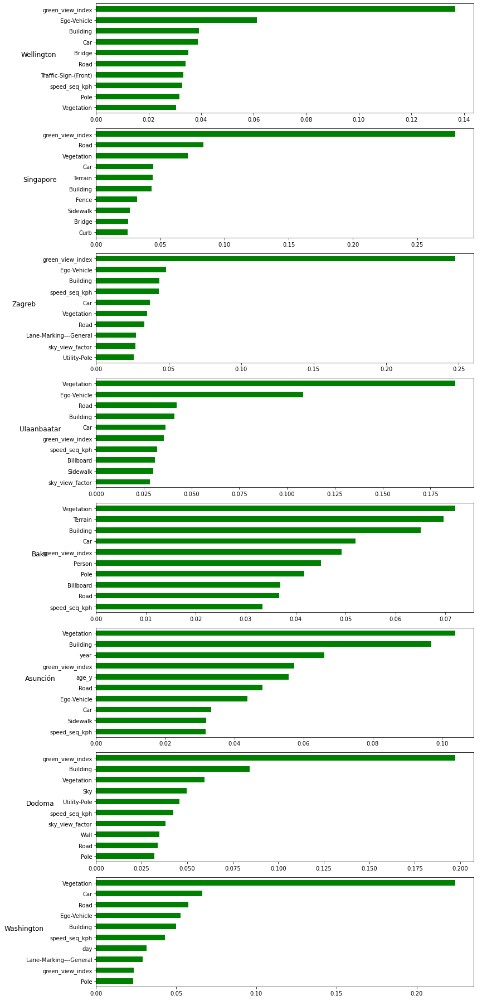

In [601]:
xcols = [
 'speed_seq_kph',
 'Bird',
 'Ground-Animal',
 'Curb',
 'Fence',
 'Guard-Rail',
 'Barrier',
 'Wall',
 'Bike-Lane',
 'Crosswalk---Plain',
 'Curb-Cut',
 'Parking',
 'Pedestrian-Area',
 'Rail-Track',
 'Road',
 'Service-Lane',
 'Sidewalk',
 'Bridge',
 'Building',
 'Tunnel',
 'Person',
 'Bicyclist',
 'Motorcyclist',
 'Other-Rider',
 'Lane-Marking---Crosswalk',
 'Lane-Marking---General',
 'Mountain',
 'Sand',
 'Sky',
 'Snow',
 'Terrain',
 'Vegetation',
 'Water',
 'Banner',
 'Bench',
 'Bike-Rack',
 'Billboard',
 'Catch-Basin',
 'CCTV-Camera',
 'Fire-Hydrant',
 'Junction-Box',
 'Mailbox',
 'Manhole',
 'Phone-Booth',
 'Pothole',
 'Street-Light',
 'Pole',
 'Traffic-Sign-Frame',
 'Utility-Pole',
 'Traffic-Light',
 'Traffic-Sign-(Back)',
 'Traffic-Sign-(Front)',
 'Trash-Can',
 'Bicycle',
 'Boat',
 'Bus',
 'Car',
 'Caravan',
 'Motorcycle',
 'On-Rails',
 'Other-Vehicle',
 'Trailer',
 'Truck',
 'Wheeled-Slow',
 'Car-Mount',
 'Ego-Vehicle',
 'year',
 'month',
 'day',
 'hour',
 'green_view_index',
 'sky_view_factor',
 'age_y',
 'for cycling',
 'for driving',
 'for walking',
 'for walking/cycling',
 'others',
 'pano_False',
 'pano_True',
 'Af',
 'BSh',
 'BSk',
 'Cfa',
 'Cfb',
 'Autumn',
 'Spring',
 'Summer',
 'Tropical',
 'Winter',
 'lighting_day',
 'lighting_night']

df_for_mlr = df_new.drop(columns=['hrs_aft_sunrise', 'hrs_aft_sunset']).dropna()

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics

results = {
    'city':[],
    'R2': [],
    'MAE': [],
    'MSE': [],
    'RMSE': []
}

# Create a grid for the plots
fig, axes = plt.subplots(len(data_dict), 1, figsize=(12, 25))

row = 0

for city in df_for_mlr['city'].unique().tolist():
    
    df_city = df_for_mlr[df_for_mlr['city'] == city]
    x = df_city[xcols]
    y = df_city['Beautiful']
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)
    rf = RandomForestRegressor(n_estimators = 100, max_depth = 50, random_state = 100)
    rf.fit(x_train, y_train)
    predictions = rf.predict(x_test)

    #Model Evaluation
    meanAbErr = metrics.mean_absolute_error(y_test, predictions)
    meanSqErr = metrics.mean_squared_error(y_test, predictions)
    rootMeanSqErr = np.sqrt(metrics.mean_squared_error(y_test, predictions))
    r2 = metrics.r2_score(y_test, predictions)
    results['city'].append(city)
    results['R2'].append(r2)
    results['MAE'].append(meanAbErr)
    results['MSE'].append(meanSqErr)
    results['RMSE'].append(rootMeanSqErr)

    global_importances = pd.Series(rf.feature_importances_, index=x_train.columns)
    global_importances.sort_values(ascending=True, inplace=True)
    global_importances[-10:].plot.barh(color='green', ax=axes[row])
    row += 1

for ax, row in zip(axes, df_for_mlr['city'].unique().tolist()):
    ax.set_ylabel(row, rotation=0, size='large')

# Adjust layout and display
plt.tight_layout()
plt.show()


In [602]:
df_results = pd.DataFrame.from_dict(results)
df_results

,city,R2,MAE,MSE,RMSE
0,Wellington,0.412438,1.377458,2.931304,1.712105
1,Singapore,0.570466,1.196671,2.389981,1.545956
2,Zagreb,0.556960,1.215367,2.379694,1.542626
3,Ulaanbaatar,0.429925,1.196671,2.223390,1.491104
4,Baku,0.405254,1.286275,2.578270,1.605699
5,Asunción,0.501314,1.278072,2.632882,1.622616
6,Dodoma,0.456501,1.338919,2.844088,1.686442
7,Washington,0.518822,1.319773,2.719314,1.649034


# Image query

In [462]:
df_all = df_all.merge(selected_cities[['city_id', 'city', 'continent']], on='city_id', how='left')

In [533]:
query_result = df_all.query("city=='Singapore' & calculated_day_night=='day' & year==2018 & type_highway=='for walking'")
query_result

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10,city,continent
23140,ebb9ead9-7c84-45de-b806-f6c2778995fb,Mapillary,492175448486006,1702341327,False,25,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,10020.0,608.0,0.0,0.0,22380.0,0.0,0.0,0.0,0.0,7312.0,0.0,843064.0,0.0,1684.0,0.0,0.0,0.0,10644.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,76640.0,1967264.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,79644.0,0.0,0.0,0.0,0.0,0.0,10536.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3029796.0,ebb9ead9-7c84-45de-b806-f6c2778995fb.jpeg,9.87,5.75,1.17,2.82,6.40,8.76,1.318088,103.815426,2018-06-17 15:04:13.202000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.649306,0.000000,5,POINT (103.81542563438416 1.3180875299077286),8a6520d9ccb7fff,Singapore,Asia
23144,3c5afd64-64dd-4c1d-ba9d-1085fe70fdf4,Mapillary,165980922102432,1702341327,False,24,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,27264.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,695768.0,0.0,4332.0,0.0,0.0,0.0,12288.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5964.0,0.0,118928.0,2133224.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3740.0,0.0,0.0,0.0,0.0,15196.0,41224.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3057928.0,3c5afd64-64dd-4c1d-ba9d-1085fe70fdf4.jpeg,9.69,4.75,1.51,3.26,9.01,9.08,1.318114,103.815426,2018-06-17 15:04:11.097000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.697604,0.001950,5,POINT (103.81542563438416 1.318114344900536),8a6520d9ccb7fff,Singapore,Asia
23145,e40fffad-a7f1-405d-9aa3-1fdb66fad340,Mapillary,298396318424761,1702341327,False,23,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,e40fffad-a7f1-405d-9aa3-1fdb66fad340.jpeg,9.53,4.53,1.31,5.27,9.03,9.16,1.318130,103.815431,2018-06-17 15:04:09.722000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,NaN,NaN,5,POINT (103.8154309988022 1.3181304338961013),8a6520d9ccb7fff,Singapore,Asia
23149,5f44d9c3-6932-4470-9fb8-4d2ee9b973dc,Mapillary,1647979305385699,1702341327,False,22,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,48648.0,0.0,0.0,0.0,2368.0,0.0,0.0,0.0,0.0,0.0,0.0,777904.0,0.0,2728.0,0.0,0.0,0.0,10072.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4036.0,0.0,292616.0,1963460.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5720.0,10088.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3117640.0,5f44d9c3-6932-4470-9fb8-4d2ee9b973dc.jpeg,9.86,4.00,1.80,4.34,9.03,9.01,1.318168,103.815426,2018-06-17 15:04:06.657000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.629790,0.001295,5,POINT (103.81542563438416 1.3181679748852986),8a6520d9ccb7fff,Singapore,Asia
23150,6b07

In [493]:
query_result['geometry'].dtype

dtype('O')

In [534]:
sg = df_all.query("city=='Singapore'")
sg = gp.GeoDataFrame(sg, geometry=gp.points_from_xy(sg.lon, sg.lat), crs="EPSG:4326")
query_result = gp.GeoDataFrame(query_result, geometry=gp.points_from_xy(query_result.lon, query_result.lat), crs="EPSG:4326")

<AxesSubplot:>

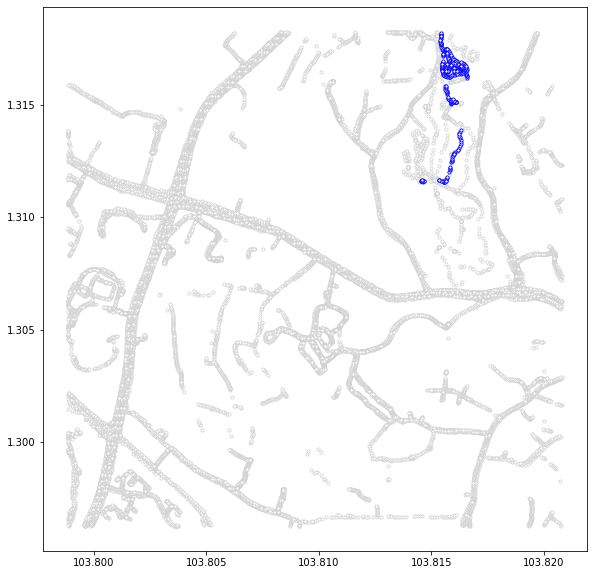

In [535]:
fig, ax = plt.subplots(figsize=(10, 10))
sg.plot(ax=ax,
        color='white',
        edgecolor='lightgrey',
        linewidth=0.8,
     alpha=1, 
     markersize=10)
query_result.plot(ax=ax,
     color='white',
    edgecolor='blue', # this modifies the color of the surrounding circle #998cc0
    linewidth=0.8, # this modifies the width of the surrounding circle
     alpha=1, 
     markersize=10)

In [536]:
query_result = df_all.query("city=='Singapore' & calculated_day_night=='day' & year==2018")
query_result

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10,city,continent
23140,ebb9ead9-7c84-45de-b806-f6c2778995fb,Mapillary,492175448486006,1702341327,False,25,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,10020.0,608.0,0.0,0.0,22380.0,0.0,0.0,0.0,0.0,7312.0,0.0,843064.0,0.0,1684.0,0.0,0.0,0.0,10644.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,76640.0,1967264.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,79644.0,0.0,0.0,0.0,0.0,0.0,10536.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3029796.0,ebb9ead9-7c84-45de-b806-f6c2778995fb.jpeg,9.87,5.75,1.17,2.82,6.40,8.76,1.318088,103.815426,2018-06-17 15:04:13.202000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.649306,0.000000,5,POINT (103.81542563438416 1.3180875299077286),8a6520d9ccb7fff,Singapore,Asia
23144,3c5afd64-64dd-4c1d-ba9d-1085fe70fdf4,Mapillary,165980922102432,1702341327,False,24,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,27264.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,695768.0,0.0,4332.0,0.0,0.0,0.0,12288.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5964.0,0.0,118928.0,2133224.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3740.0,0.0,0.0,0.0,0.0,15196.0,41224.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3057928.0,3c5afd64-64dd-4c1d-ba9d-1085fe70fdf4.jpeg,9.69,4.75,1.51,3.26,9.01,9.08,1.318114,103.815426,2018-06-17 15:04:11.097000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.697604,0.001950,5,POINT (103.81542563438416 1.318114344900536),8a6520d9ccb7fff,Singapore,Asia
23145,e40fffad-a7f1-405d-9aa3-1fdb66fad340,Mapillary,298396318424761,1702341327,False,23,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,e40fffad-a7f1-405d-9aa3-1fdb66fad340.jpeg,9.53,4.53,1.31,5.27,9.03,9.16,1.318130,103.815431,2018-06-17 15:04:09.722000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,NaN,NaN,5,POINT (103.8154309988022 1.3181304338961013),8a6520d9ccb7fff,Singapore,Asia
23149,5f44d9c3-6932-4470-9fb8-4d2ee9b973dc,Mapillary,1647979305385699,1702341327,False,22,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,48648.0,0.0,0.0,0.0,2368.0,0.0,0.0,0.0,0.0,0.0,0.0,777904.0,0.0,2728.0,0.0,0.0,0.0,10072.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4036.0,0.0,292616.0,1963460.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5720.0,10088.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3117640.0,5f44d9c3-6932-4470-9fb8-4d2ee9b973dc.jpeg,9.86,4.00,1.80,4.34,9.03,9.01,1.318168,103.815426,2018-06-17 15:04:06.657000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.629790,0.001295,5,POINT (103.81542563438416 1.3181679748852986),8a6520d9ccb7fff,Singapore,Asia
23150,6b07

In [537]:
sg = df_all.query("city=='Singapore'")
sg = gp.GeoDataFrame(sg, geometry=gp.points_from_xy(sg.lon, sg.lat), crs="EPSG:4326")
query_result = gp.GeoDataFrame(query_result, geometry=gp.points_from_xy(query_result.lon, query_result.lat), crs="EPSG:4326")

<AxesSubplot:>

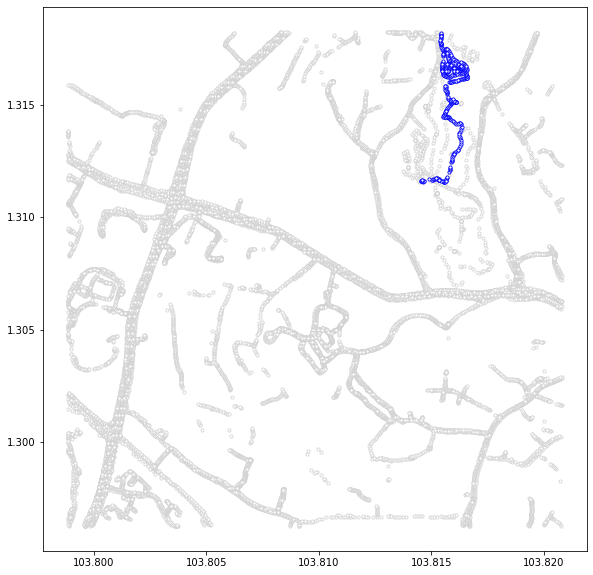

In [538]:
fig, ax = plt.subplots(figsize=(10, 10))
sg.plot(ax=ax,
        color='white',
        edgecolor='lightgrey',
        linewidth=0.8,
     alpha=1, 
     markersize=10)
query_result.plot(ax=ax,
     color='white',
    edgecolor='blue', # this modifies the color of the surrounding circle #998cc0
    linewidth=0.8, # this modifies the width of the surrounding circle
     alpha=1, 
     markersize=10)

In [549]:
query_result = df_all.query("city=='Singapore' & calculated_day_night=='night' & year==2018")
query_result

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10,city,continent
29045,edf317e6-1b07-4fd2-b20c-56c63a804d1c,KartaView,359504485,1702341327,False,492,1339703,48.251187,driving,59,primary,for driving,0.0,0.0,16064.0,183568.0,0.0,0.0,610848.0,0.0,0.0,0.0,0.0,0.0,0.0,1707992.0,40.0,38552.0,0.0,1054264.0,0.0,0.0,0.0,0.0,0.0,4584.0,98232.0,0.0,0.0,671304.0,0.0,0.0,666184.0,0.0,0.0,0.0,0.0,10560.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,26528.0,35696.0,0.0,0.0,0.0,0.0,11856.0,0.0,0.0,0.0,288.0,44872.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5181432.0,edf317e6-1b07-4fd2-b20c-56c63a804d1c.jpeg,7.49,3.51,3.62,2.24,0.56,1.40,1.302555,103.820066,2018-04-06 23:50:15+08:00,Af,Tropical rainforest,Tropical,night,NaN,4.65,2018,4,6,23,0.128571,0.129560,5,POINT (103.820066 1.302555),8a6520d8208ffff,Singapore,Asia
29050,9d9c3ad1-0799-4f8a-a1e5-d34165fe4327,KartaView,359504487,1702341327,False,493,1339703,48.251187,driving,59,primary,for driving,0.0,0.0,16528.0,0.0,0.0,0.0,500680.0,0.0,0.0,10720.0,0.0,0.0,0.0,1698600.0,0.0,27944.0,0.0,966688.0,0.0,0.0,0.0,0.0,0.0,0.0,106416.0,0.0,0.0,0.0,0.0,0.0,974216.0,0.0,0.0,0.0,0.0,19720.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,936.0,68784.0,0.0,0.0,0.0,0.0,30640.0,0.0,0.0,0.0,0.0,43704.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,133400.0,0.0,4598976.0,9d9c3ad1-0799-4f8a-a1e5-d34165fe4327.jpeg,2.43,2.49,0.66,3.92,2.33,1.61,1.302603,103.820177,2018-04-06 23:50:16+08:00,Af,Tropical rainforest,Tropical,night,NaN,4.65,2018,4,6,23,0.211833,0.000000,5,POINT (103.820177 1.302603),8a6520d8208ffff,Singapore,Asia
29056,0c4b6b91-3808-44ca-af0d-c0f9cd6a1554,KartaView,359504489,1702341327,False,494,1339703,48.251187,driving,59,primary,for driving,0.0,0.0,7024.0,62128.0,0.0,0.0,553024.0,0.0,0.0,0.0,0.0,0.0,0.0,1679272.0,0.0,67144.0,0.0,608360.0,0.0,0.0,0.0,0.0,0.0,0.0,79080.0,0.0,0.0,1111416.0,0.0,0.0,594648.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,17200.0,83832.0,0.0,0.0,0.0,0.0,44640.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45288.0,0.0,528.0,0.0,0.0,0.0,4953584.0,0c4b6b91-3808-44ca-af0d-c0f9cd6a1554.jpeg,6.81,3.29,1.38,2.45,0.49,1.87,1.302647,103.820294,2018-04-06 23:50:17+08:00,Af,Tropical rainforest,Tropical,night,NaN,4.65,2018,4,6,23,0.120044,0.224366,5,POINT (103.820294 1.302647),8a6520d8208ffff,Singapore,Asia
29062,dca143a9-652f-43cf-94a1-17f8d2f75393,KartaView,359504491,1702341327,False,495,1339703,48.251187,driving,59,primary,for driving,0.0,0.0,56696.0,97952.0,0.0,256648.0,1208.0,0.0,0.0,0.0,0.0,0.0,0.0,1741520.0,0.0,33168.0,0.0,397320.0,0.0,17392.0,0.0,0.0,0.0,0.0,106664.0,0.0,0.0,280552.0,0.0,134328.0,1895992.0,0.0,0.0,0.0,0.0,10320.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,28640.0,52280.0,0.0,0.0,0.0,0.0,4928.0,0.0,0.0,0.0,0.0,54720.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5170328.0,dca143a9-652f-43cf-94a1-17f8d2f75393.jpeg,4.88,2.70,2.48,2.49,0.99,2.83,1.302694,103.820407,2018-04-06 23:50:18+08:00,Af,Tropical rainforest,Tropical,night,NaN,4.65,2018,4,6,23,0.366706,0.054262,5,POINT (103.820407 1.302694),8a6520d8208ffff,Singapore,Asia
29070,e9f88480-f8c7-4c6f-81ee-3

In [550]:
sg = df_all.query("city=='Singapore'")
sg = gp.GeoDataFrame(sg, geometry=gp.points_from_xy(sg.lon, sg.lat), crs="EPSG:4326")
query_result = gp.GeoDataFrame(query_result, geometry=gp.points_from_xy(query_result.lon, query_result.lat), crs="EPSG:4326")

<AxesSubplot:>

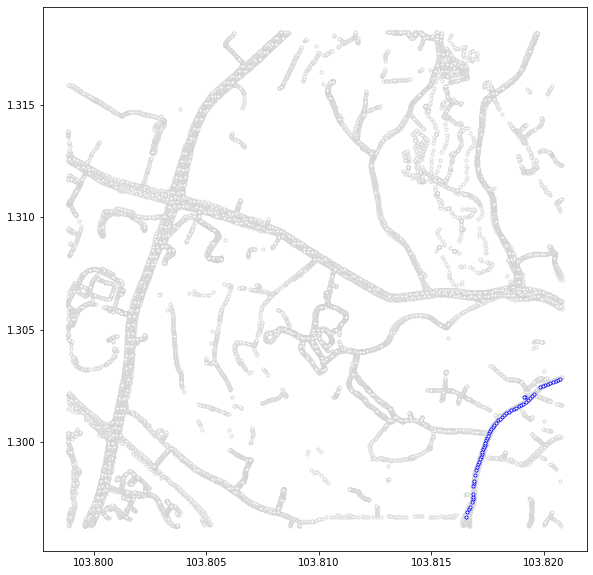

In [551]:
fig, ax = plt.subplots(figsize=(10, 10))
sg.plot(ax=ax,
        color='white',
        edgecolor='lightgrey',
        linewidth=0.8,
     alpha=1, 
     markersize=10)
query_result.plot(ax=ax,
     color='white',
    edgecolor='blue', # this modifies the color of the surrounding circle #998cc0
    linewidth=0.8, # this modifies the width of the surrounding circle
     alpha=1, 
     markersize=10)

In [552]:
query_result = df_all.query("city=='Singapore' & year==2018")
query_result

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10,city,continent
23140,ebb9ead9-7c84-45de-b806-f6c2778995fb,Mapillary,492175448486006,1702341327,False,25,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,10020.0,608.0,0.0,0.0,22380.0,0.0,0.0,0.0,0.0,7312.0,0.0,843064.0,0.0,1684.0,0.0,0.0,0.0,10644.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,76640.0,1967264.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,79644.0,0.0,0.0,0.0,0.0,0.0,10536.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3029796.0,ebb9ead9-7c84-45de-b806-f6c2778995fb.jpeg,9.87,5.75,1.17,2.82,6.40,8.76,1.318088,103.815426,2018-06-17 15:04:13.202000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.649306,0.000000,5,POINT (103.81542563438416 1.3180875299077286),8a6520d9ccb7fff,Singapore,Asia
23144,3c5afd64-64dd-4c1d-ba9d-1085fe70fdf4,Mapillary,165980922102432,1702341327,False,24,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,27264.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,695768.0,0.0,4332.0,0.0,0.0,0.0,12288.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5964.0,0.0,118928.0,2133224.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3740.0,0.0,0.0,0.0,0.0,15196.0,41224.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3057928.0,3c5afd64-64dd-4c1d-ba9d-1085fe70fdf4.jpeg,9.69,4.75,1.51,3.26,9.01,9.08,1.318114,103.815426,2018-06-17 15:04:11.097000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.697604,0.001950,5,POINT (103.81542563438416 1.318114344900536),8a6520d9ccb7fff,Singapore,Asia
23145,e40fffad-a7f1-405d-9aa3-1fdb66fad340,Mapillary,298396318424761,1702341327,False,23,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,e40fffad-a7f1-405d-9aa3-1fdb66fad340.jpeg,9.53,4.53,1.31,5.27,9.03,9.16,1.318130,103.815431,2018-06-17 15:04:09.722000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,NaN,NaN,5,POINT (103.8154309988022 1.3181304338961013),8a6520d9ccb7fff,Singapore,Asia
23149,5f44d9c3-6932-4470-9fb8-4d2ee9b973dc,Mapillary,1647979305385699,1702341327,False,22,QUr2Wb8zTIaeW2eraIIYHw,2.097881,walking,287,footway,for walking,0.0,0.0,48648.0,0.0,0.0,0.0,2368.0,0.0,0.0,0.0,0.0,0.0,0.0,777904.0,0.0,2728.0,0.0,0.0,0.0,10072.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4036.0,0.0,292616.0,1963460.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5720.0,10088.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3117640.0,5f44d9c3-6932-4470-9fb8-4d2ee9b973dc.jpeg,9.86,4.00,1.80,4.34,9.03,9.01,1.318168,103.815426,2018-06-17 15:04:06.657000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-4.12,2018,6,17,15,0.629790,0.001295,5,POINT (103.81542563438416 1.3181679748852986),8a6520d9ccb7fff,Singapore,Asia
23150,6b07

In [553]:
sg = df_all.query("city=='Singapore'")
sg = gp.GeoDataFrame(sg, geometry=gp.points_from_xy(sg.lon, sg.lat), crs="EPSG:4326")
query_result = gp.GeoDataFrame(query_result, geometry=gp.points_from_xy(query_result.lon, query_result.lat), crs="EPSG:4326")

<AxesSubplot:>

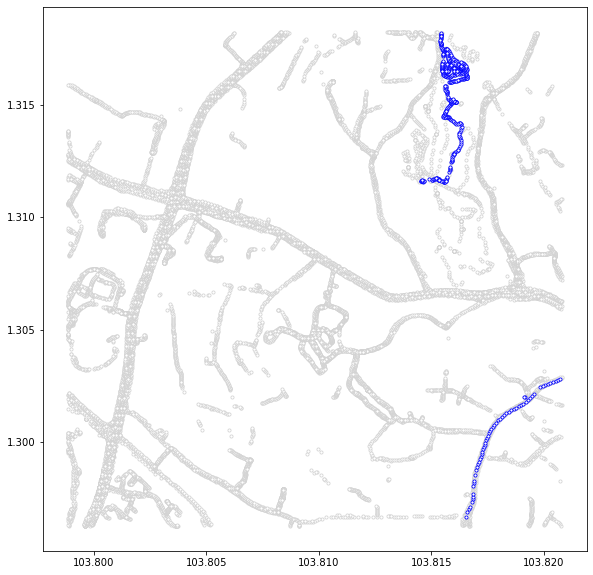

In [554]:
fig, ax = plt.subplots(figsize=(10, 10))
sg.plot(ax=ax,
        color='white',
        edgecolor='lightgrey',
        linewidth=0.8,
     alpha=1, 
     markersize=10)
query_result.plot(ax=ax,
     color='white',
    edgecolor='blue', # this modifies the color of the surrounding circle #998cc0
    linewidth=0.8, # this modifies the width of the surrounding circle
     alpha=1, 
     markersize=10)

In [560]:
query_result = df_all.query("city=='Singapore' & calculated_day_night=='day' & year==2015 & type_highway=='for walking'")
query_result

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10,city,continent
23141,caab976b-d893-47b3-99ae-49a1ad26c4b1,Mapillary,369268314457198,1702341327,False,5,Kob0RdnEWnfxYC2lOyaDGg,2.029842,walking,6,footway,for walking,0.0,0.0,11633.0,0.0,0.0,0.0,752.0,0.0,0.0,0.0,0.0,39671.0,0.0,399656.0,0.0,40454.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,409213.0,2149227.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1176.0,0.0,0.0,0.0,0.0,0.0,28996.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3080778.0,caab976b-d893-47b3-99ae-49a1ad26c4b1.jpeg,9.66,6.74,1.44,5.79,8.04,8.34,1.318093,103.815882,2015-06-10 16:37:32.299000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-2.54,2015,6,10,16,0.697625,0.000000,8,POINT (103.81588160991669 1.3180928929063214),8a6520d9ccb7fff,Singapore,Asia
23151,af2e7896-7c99-4d01-b3f5-ce7ad04128c9,Mapillary,321795739374893,1702341327,False,5,Bb1R8uPW4CdfJ6jM5Oo4mQ,3.971944,walking,13,footway,for walking,0.0,0.0,656.0,0.0,0.0,0.0,52692.0,0.0,0.0,0.0,0.0,0.0,0.0,494897.0,0.0,1708.0,0.0,0.0,0.0,4327.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,69427.0,0.0,481931.0,1980431.0,0.0,0.0,0.0,0.0,1044.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4904.0,14233.0,0.0,0.0,0.0,0.0,92.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3106342.0,af2e7896-7c99-4d01-b3f5-ce7ad04128c9.jpeg,9.95,6.95,3.43,3.13,9.48,8.30,1.318200,103.815458,2015-06-10 10:37:13.745000+08:00,Af,Tropical rainforest,Tropical,day,3.65,NaN,2015,6,10,10,0.637544,0.022350,8,POINT (103.81545782089232 1.3182001528755904),8a6520d9ccb7fff,Singapore,Asia
23270,87255221-c49b-41cb-8b48-5a67801ee994,Mapillary,849259619356077,1702341327,False,6,vjYSrxoDZW5qbIJEAD4GzA,3.696210,walking,10,footway,for walking,0.0,0.0,0.0,0.0,0.0,0.0,87324.0,0.0,0.0,0.0,0.0,801542.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18516.0,0.0,36766.0,1802570.0,0.0,0.0,46654.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2793372.0,87255221-c49b-41cb-8b48-5a67801ee994.jpeg,8.42,4.29,3.05,1.65,4.77,6.09,1.316865,103.816402,2015-06-10 15:56:03.607000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-3.23,2015,6,10,15,0.645303,0.006629,8,POINT (103.81640195846558 1.3168647659288837),8a6520d9cd9ffff,Singapore,Asia
23273,c3a6f3af-e11e-40e3-8271-6eb55b5ea821,Mapillary,532215427960633,1702341327,False,5,vjYSrxoDZW5qbIJEAD4GzA,3.696210,walking,10,footway,for walking,0.0,0.0,168.0,0.0,0.0,0.0,96746.0,0.0,0.0,0.0,0.0,1036.0,0.0,888347.0,0.0,0.0,0.0,29899.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2410.0,0.0,311483.0,1735333.0,0.0,0.0,6784.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,22713.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3094919.0,c3a6f3af-e11e-40e3-8271-6eb55b5ea821.jpeg,9.53,4.12,3.80,2.38,4.13,7.24,1.316913,103.816289,2015-06-10 15:55:47.446000+08:00,Af,Tropical rainforest,Tropical,day,NaN,-3.24,2015,6,10,15,0.560704,0.000779,8,POINT (103.81628930568696 1.316913032939425),8a6520d9cd9ff

In [591]:
query_result2 = df_all.query("city=='Singapore' & hour>=20 & year==2018 & speed_seq_kph>=30")
query_result2

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10,city,continent
29045,edf317e6-1b07-4fd2-b20c-56c63a804d1c,KartaView,359504485,1702341327,False,492,1339703,48.251187,driving,59,primary,for driving,0.0,0.0,16064.0,183568.0,0.0,0.0,610848.0,0.0,0.0,0.0,0.0,0.0,0.0,1707992.0,40.0,38552.0,0.0,1054264.0,0.0,0.0,0.0,0.0,0.0,4584.0,98232.0,0.0,0.0,671304.0,0.0,0.0,666184.0,0.0,0.0,0.0,0.0,10560.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,26528.0,35696.0,0.0,0.0,0.0,0.0,11856.0,0.0,0.0,0.0,288.0,44872.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5181432.0,edf317e6-1b07-4fd2-b20c-56c63a804d1c.jpeg,7.49,3.51,3.62,2.24,0.56,1.40,1.302555,103.820066,2018-04-06 23:50:15+08:00,Af,Tropical rainforest,Tropical,night,NaN,4.65,2018,4,6,23,0.128571,0.129560,5,POINT (103.820066 1.302555),8a6520d8208ffff,Singapore,Asia
29050,9d9c3ad1-0799-4f8a-a1e5-d34165fe4327,KartaView,359504487,1702341327,False,493,1339703,48.251187,driving,59,primary,for driving,0.0,0.0,16528.0,0.0,0.0,0.0,500680.0,0.0,0.0,10720.0,0.0,0.0,0.0,1698600.0,0.0,27944.0,0.0,966688.0,0.0,0.0,0.0,0.0,0.0,0.0,106416.0,0.0,0.0,0.0,0.0,0.0,974216.0,0.0,0.0,0.0,0.0,19720.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,936.0,68784.0,0.0,0.0,0.0,0.0,30640.0,0.0,0.0,0.0,0.0,43704.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,133400.0,0.0,4598976.0,9d9c3ad1-0799-4f8a-a1e5-d34165fe4327.jpeg,2.43,2.49,0.66,3.92,2.33,1.61,1.302603,103.820177,2018-04-06 23:50:16+08:00,Af,Tropical rainforest,Tropical,night,NaN,4.65,2018,4,6,23,0.211833,0.000000,5,POINT (103.820177 1.302603),8a6520d8208ffff,Singapore,Asia
29056,0c4b6b91-3808-44ca-af0d-c0f9cd6a1554,KartaView,359504489,1702341327,False,494,1339703,48.251187,driving,59,primary,for driving,0.0,0.0,7024.0,62128.0,0.0,0.0,553024.0,0.0,0.0,0.0,0.0,0.0,0.0,1679272.0,0.0,67144.0,0.0,608360.0,0.0,0.0,0.0,0.0,0.0,0.0,79080.0,0.0,0.0,1111416.0,0.0,0.0,594648.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,17200.0,83832.0,0.0,0.0,0.0,0.0,44640.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45288.0,0.0,528.0,0.0,0.0,0.0,4953584.0,0c4b6b91-3808-44ca-af0d-c0f9cd6a1554.jpeg,6.81,3.29,1.38,2.45,0.49,1.87,1.302647,103.820294,2018-04-06 23:50:17+08:00,Af,Tropical rainforest,Tropical,night,NaN,4.65,2018,4,6,23,0.120044,0.224366,5,POINT (103.820294 1.302647),8a6520d8208ffff,Singapore,Asia
29062,dca143a9-652f-43cf-94a1-17f8d2f75393,KartaView,359504491,1702341327,False,495,1339703,48.251187,driving,59,primary,for driving,0.0,0.0,56696.0,97952.0,0.0,256648.0,1208.0,0.0,0.0,0.0,0.0,0.0,0.0,1741520.0,0.0,33168.0,0.0,397320.0,0.0,17392.0,0.0,0.0,0.0,0.0,106664.0,0.0,0.0,280552.0,0.0,134328.0,1895992.0,0.0,0.0,0.0,0.0,10320.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,28640.0,52280.0,0.0,0.0,0.0,0.0,4928.0,0.0,0.0,0.0,0.0,54720.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5170328.0,dca143a9-652f-43cf-94a1-17f8d2f75393.jpeg,4.88,2.70,2.48,2.49,0.99,2.83,1.302694,103.820407,2018-04-06 23:50:18+08:00,Af,Tropical rainforest,Tropical,night,NaN,4.65,2018,4,6,23,0.366706,0.054262,5,POINT (103.820407 1.302694),8a6520d8208ffff,Singapore,Asia
29070,e9f88480-f8c7-4c6f-81ee-3

In [592]:
sg = df_all.query("city=='Singapore'")
sg = gp.GeoDataFrame(sg, geometry=gp.points_from_xy(sg.lon, sg.lat), crs="EPSG:4326")
query_result = gp.GeoDataFrame(query_result, geometry=gp.points_from_xy(query_result.lon, query_result.lat), crs="EPSG:4326")
query_result2 = gp.GeoDataFrame(query_result2, geometry=gp.points_from_xy(query_result2.lon, query_result2.lat), crs="EPSG:4326")

<AxesSubplot:>

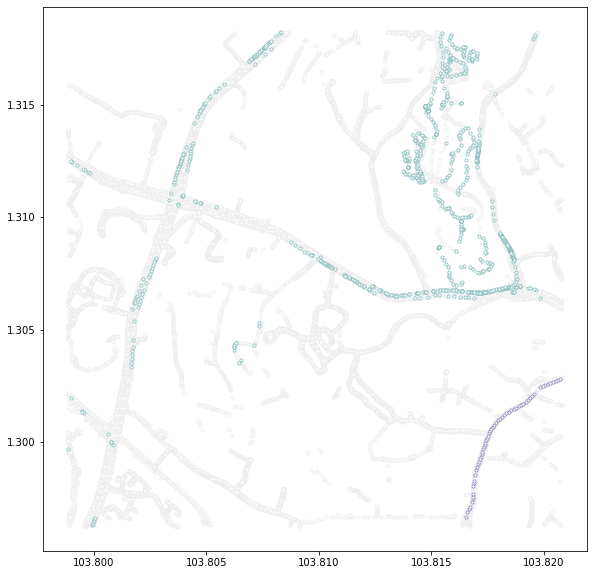

In [593]:
fig, ax = plt.subplots(figsize=(10, 10))
sg.plot(ax=ax,
        color='white',
        edgecolor='#eeeeee',
        linewidth=0.8,
     alpha=1, 
     markersize=10)
query_result.plot(ax=ax,
     color='white',
    edgecolor='#8CC0C0', # this modifies the color of the surrounding circle #998cc0
    linewidth=0.8, # this modifies the width of the surrounding circle
     alpha=1, 
     markersize=10)
query_result2.plot(ax=ax,
     color='white',
    edgecolor='#998cc0', # this modifies the color of the surrounding circle #998cc0
    linewidth=0.8, # this modifies the width of the surrounding circle
     alpha=1, 
     markersize=10)

<AxesSubplot:>

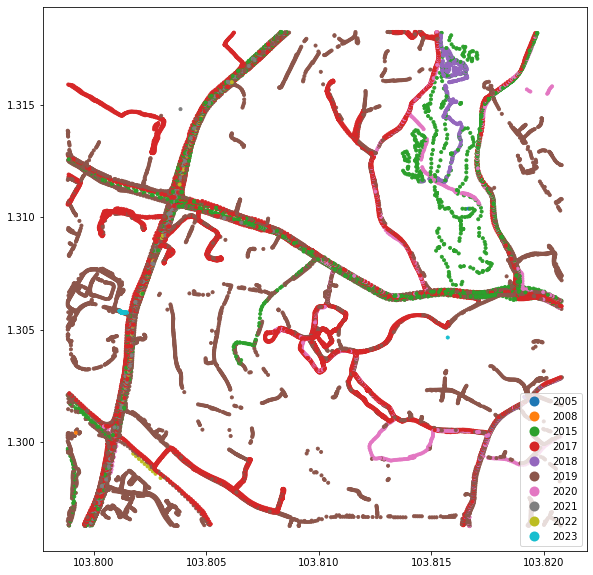

In [559]:
fig, ax = plt.subplots(figsize=(10, 10))
sg.plot(ax=ax,
        column='year',
        categorical=True, 
        cmap='tab10',
        linewidth=0.8,
     alpha=1, 
     markersize=10,
    legend=True,
       legend_kwds={'loc': 'lower right'})

In [555]:
sg.year.value_counts()

2019    9049
2017    8059
2015    2953
2020     968
2021     836
2018     495
2023     121
2022      96
2005       1
2008       1
Name: year, dtype: int64

In [563]:
sg[sg['orig_id'] == 169943701683038]

,uuid,source,orig_id,city_id,pano_status,sequenceIndex,sequenceId,speed_seq_kph,transportation_mode,seq_img_count,highway,type_highway,Bird,Ground-Animal,Curb,Fence,Guard-Rail,Barrier,Wall,Bike-Lane,Crosswalk---Plain,Curb-Cut,Parking,Pedestrian-Area,Rail-Track,Road,Service-Lane,Sidewalk,Bridge,Building,Tunnel,Person,Bicyclist,Motorcyclist,Other-Rider,Lane-Marking---Crosswalk,Lane-Marking---General,Mountain,Sand,Sky,Snow,Terrain,Vegetation,Water,Banner,Bench,Bike-Rack,Billboard,Catch-Basin,CCTV-Camera,Fire-Hydrant,Junction-Box,Mailbox,Manhole,Phone-Booth,Pothole,Street-Light,Pole,Traffic-Sign-Frame,Utility-Pole,Traffic-Light,Traffic-Sign-(Back),Traffic-Sign-(Front),Trash-Can,Bicycle,Boat,Bus,Car,Caravan,Motorcycle,On-Rails,Other-Vehicle,Trailer,Truck,Wheeled-Slow,Car-Mount,Ego-Vehicle,Total,Image_name,Beautiful,Boring,Depressing,Lively,Safe,Wealthy,lat,lon,datetime_local,koppen_geiger_zone,zone_description,season,calculated_day_night,hrs_aft_sunrise,hrs_aft_sunset,year,month,day,hour,green_view_index,sky_view_factor,age_y,geometry,h3_10,city,continent
25391,a734675b-3014-4820-98f1-4101f189aa84,Mapillary,169943701683038,1702341327,False,2,6vJv34uT2tAl29WgNlaoBA,1.918958,walking,4,footway,for walking,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,426399.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2690325.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3116724.0,a734675b-3014-4820-98f1-4101f189aa84.jpeg,3.99,7.2,4.3,3.17,7.5,5.99,1.313449,103.814304,2015-06-10 11:18:16.516000+08:00,Af,Tropical rainforest,Tropical,day,4.33,NaN,2015,6,10,11,0.86319,0.0,8,POINT (103.81430 1.31345),8a6520d9cc27fff,Singapore,Asia


In [589]:
sg[sg['sequenceId'] == '1339703'].hour.value_counts()

23    59
Name: hour, dtype: int64

<AxesSubplot:>

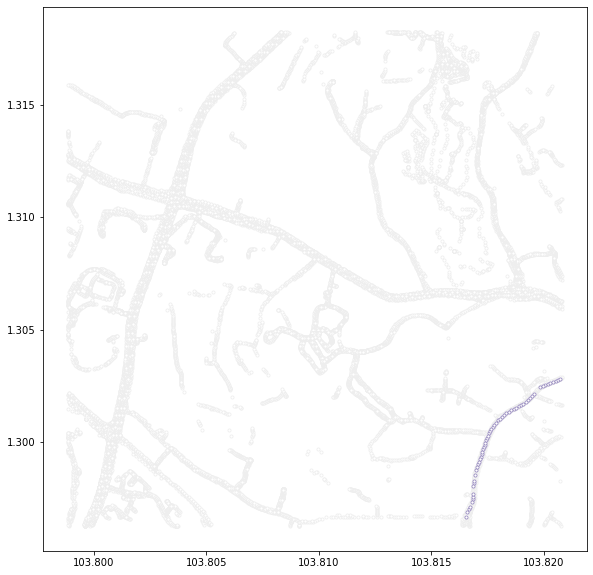

In [590]:
fig, ax = plt.subplots(figsize=(10, 10))
sg.plot(ax=ax,
        color='white',
        edgecolor='#eeeeee',
        linewidth=0.8,
     alpha=1, 
     markersize=10)
sg[sg['sequenceId'] == '1339703'].plot(ax=ax,
     color='white',
    edgecolor='#998cc0', # this modifies the color of the surrounding circle #998cc0
    linewidth=0.8, # this modifies the width of the surrounding circle
     alpha=1, 
     markersize=10)

# Pano & lighting_condition distribution

In [2]:
contextual = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities688_all_standard/tables/contextual.csv')[['uuid', 'source', 'orig_id', 'pano_status', 'lighting_condition']]
#lc = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities677/tables/lighting_condition.csv').drop(columns=['Unnamed: 0'])
sm = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities688_all_standard/tables/simplemaps.csv')

/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (4) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (12) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [3]:
contextual.pano_status.value_counts()

False    8524354
True      712138
Name: pano_status, dtype: int64

<AxesSubplot:>

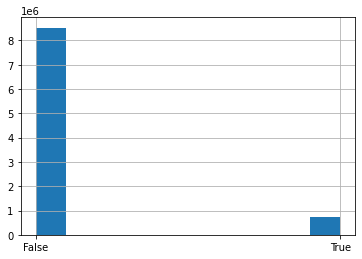

In [4]:
contextual.pano_status.astype(str).hist()

In [5]:
contextual.lighting_condition.value_counts()

day          8660853
dusk/dawn     316094
night         259545
Name: lighting_condition, dtype: int64

In [15]:
len(contextual.query("lighting_condition=='night'"))/len(contextual)

0.028099953965206703

<AxesSubplot:>

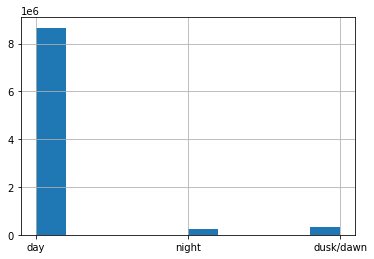

In [6]:
contextual.lighting_condition.hist()

In [8]:
contextual.query("lighting_condition=='night'").sample(n=20, random_state=1)

,uuid,source,orig_id,pano_status,lighting_condition
1927907,bce3c7b9-ce35-44eb-b4e8-d7315455e51b,Mapillary,960086274772439,False,night
8309329,9bd6b416-4d1b-4a62-b7c2-24476f94dc7d,KartaView,602816906,False,night
3947198,3d79a29f-8ca8-46c0-9a87-bccf77dbec4b,Mapillary,342361437553799,False,night
4493228,c9130e23-9347-4ca9-aa37-b1d73f3d3e12,Mapillary,5544928978913011,False,night
3718705,e666601d-2c84-4f27-830f-94aab0f90825,Mapillary,309716460606269,False,night
6129635,23f95d06-ff72-4f33-ba66-01ae127e5eea,Mapillary,3339703049589461,False,night
4901357,f6c132a5-3f1a-4d74-9fce-0080ec94cec4,Mapillary,258223819470251,False,night
2206673,b1dff76a-a787-4e61-8a5d-5a22527e48bf,Mapillary,477365070240600,False,night
4396200,0bc5cb7a-6363-4627-b237-8cf6ff76c45d,Mapillary,2044191512401361,False,night
2155125,0142e254-5788-4ccd-ae62-1cbb25189935,Mapillary,402909247429910,False,night


## pano

In [16]:
contextual_sm = contextual.merge(sm[['uuid', 'city_id']], on='uuid', how='left')

In [13]:
pano_src = contextual_sm.groupby('source').pano_status.sum().reset_index().rename(columns={
    'pano_status': 'pano_True'
}).merge(contextual_sm.groupby('source').uuid.count().rename('total'), on='source', how='left')
pano_src['pano_True_perc'] = pano_src['pano_True']/pano_src['total']
pano_src

,source,pano_True,total,pano_True_perc
0,KartaView,9684,1066583,0.009079
1,Mapillary,702454,8169909,0.085981


In [17]:
(9684+702454)/(1066583+8169909)

0.07710048360351528

In [19]:
pano_city = contextual_sm.groupby('city_id').pano_status.sum().reset_index().rename(columns={
    'pano_status': 'pano_True'
})
pano_city = pano_city.merge(contextual_sm.groupby('city_id').uuid.count().rename('total'), on='city_id', how='left')
pano_city['pano_False'] = pano_city['total'] - pano_city['pano_True']
pano_city['pano_True_perc'] = pano_city['pano_True']/pano_city['total']
pano_city['pano_False_perc'] = 1 - pano_city['pano_True_perc']
pano_city

,city_id,pano_True,total,pano_False,pano_True_perc,pano_False_perc
0,1,10410,11005,595,0.945934,0.054066
1,1004993580,0,57,57,0.000000,1.000000
2,1008162156,8,40550,40542,0.000197,0.999803
3,1012126319,0,4872,4872,0.000000,1.000000
4,1012973369,0,2603,2603,0.000000,1.000000
...,...,...,...,...,...,...
683,1894157390,0,2865,2865,0.000000,1.000000
684,1894950283,0,276,276,0.000000,1.000000
685,1901760068,221,41082,40861,0.005379,0.994621
686,1930654114,6,1890,1884,0.003175,0.996825


In [20]:
cities = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities688_all_standard/svi_count_by_city.csv').drop(columns=['Unnamed: 0'])
cities.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 688 entries, 0 to 687
Data columns (total 13 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   city        688 non-null    object 
 1   city_ascii  688 non-null    object 
 2   city_id     688 non-null    int64  
 3   city_lat    688 non-null    float64
 4   city_lon    688 non-null    float64
 5   country     688 non-null    object 
 6   iso2        687 non-null    object 
 7   iso3        688 non-null    object 
 8   admin_name  660 non-null    object 
 9   capital     392 non-null    object 
 10  population  679 non-null    float64
 11  continent   688 non-null    object 
 12  img_count   688 non-null    int64  
dtypes: float64(3), int64(2), object(8)
memory usage: 70.0+ KB


In [21]:
pano_city = pano_city.merge(cities[['city', 'city_id', 'country', 'continent']], on='city_id', how='left')

In [22]:
pano_city.total.sum()

9236492

In [23]:
pano_city

,city_id,pano_True,total,pano_False,pano_True_perc,pano_False_perc,city,country,continent
0,1,10410,11005,595,0.945934,0.054066,Primošten,Croatia,Europe
1,1004993580,0,57,57,0.000000,1.000000,Kabul,Afghanistan,Asia
2,1008162156,8,40550,40542,0.000197,0.999803,Tirana,Albania,Europe
3,1012126319,0,4872,4872,0.000000,1.000000,Oran,Algeria,Africa
4,1012973369,0,2603,2603,0.000000,1.000000,Algiers,Algeria,Africa
...,...,...,...,...,...,...,...,...,...
683,1894157390,0,2865,2865,0.000000,1.000000,Lusaka,Zambia,Africa
684,1894950283,0,276,276,0.000000,1.000000,Chililabombwe,Zambia,Africa
685,1901760068,221,41082,40861,0.005379,0.994621,Pristina,Kosovo,Europe
686,1930654114,6,1890,1884,0.003175,0.996825,Longyearbyen,Svalbard,Europe


In [24]:
pano_city.to_csv('/Users/yujun/Data/global_streetscapes/cities688_all_standard/cities688_pano_perc.csv')

In [239]:
pano_city = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities677/cities677_pano_perc.csv').drop(columns=['Unnamed: 0'])

<AxesSubplot:>

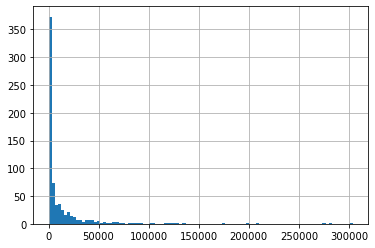

In [25]:
pano_city.total.hist(bins=100)

In [31]:
df = pano_city.query("pano_True_perc>0.1 & total>10000")
print(df.city.nunique() == len(df))
df = df[['city', 'pano_True_perc', 'pano_False_perc']].sort_values('pano_True_perc').rename(columns={'pano_True_perc': 'Pano: True', 'pano_False_perc': 'Pano: False'})
print(len(df))

True
35


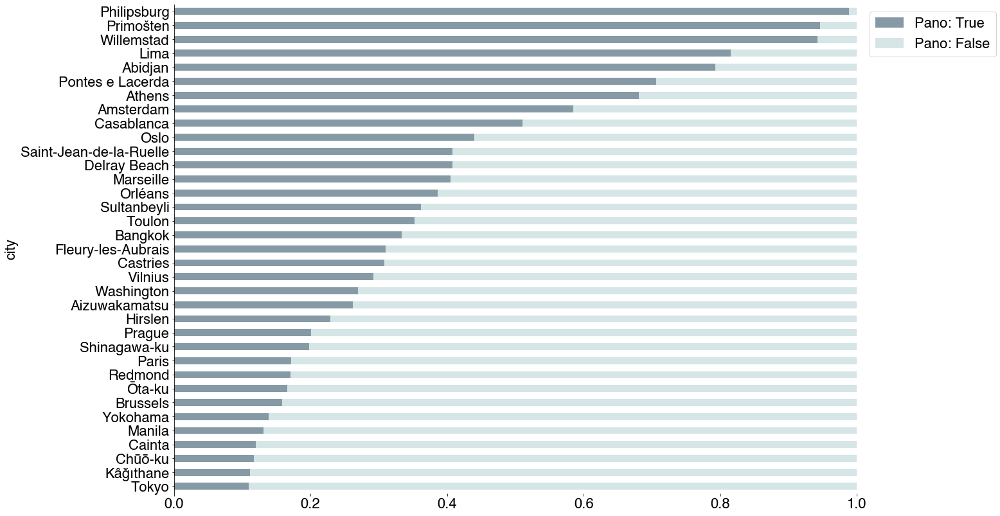

In [46]:
import matplotlib.pyplot as plt 
import matplotlib
import numpy as np

min_val, max_val = 0.6,0.88
n = 10
orig_cmap = plt.cm.bone
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 22}

fig,ax = plt.subplots(figsize=(20,14))
plt.rc('xtick', labelsize=22) #fontsize of the x tick labels
plt.rc('ytick', labelsize=22) #fontsize of the x tick labels
plt.rc('font', **hfont)

# plot a Stacked Bar Chart using matplotlib 
df.plot( 
    x = 'city', 
    kind = 'barh', 
    stacked = True, 
#    title = 'Stacked Bar Graph', 
    mark_right = True,
    ax=ax,
    cmap = cmap
)
plt.legend(bbox_to_anchor=(0.96, 1.0))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/pano_share_2.png', format='png', dpi=300, facecolor='white', bbox_inches='tight')

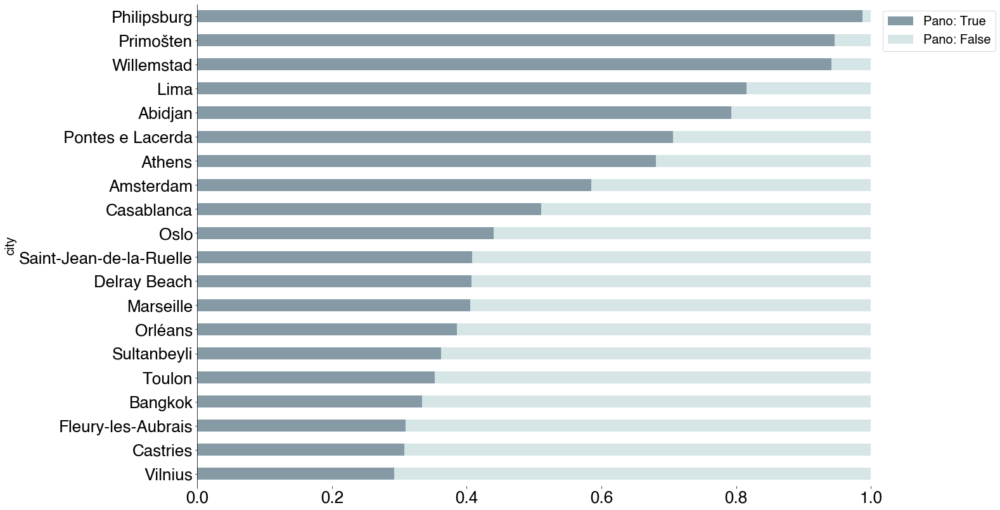

In [54]:
import matplotlib.pyplot as plt 
import matplotlib
import numpy as np

min_val, max_val = 0.6,0.88
n = 10
orig_cmap = plt.cm.bone
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 20}

fig,ax = plt.subplots(figsize=(20,14))
plt.rc('xtick', labelsize=26) #fontsize of the x tick labels
plt.rc('ytick', labelsize=26) #fontsize of the x tick labels
plt.rc('font', **hfont)

# plot a Stacked Bar Chart using matplotlib 
df.iloc[15:].plot( 
    x = 'city', 
    kind = 'barh', 
    stacked = True, 
#    title = 'Stacked Bar Graph', 
    mark_right = True,
    ax=ax,
    cmap = cmap
)
plt.legend(bbox_to_anchor=(0.96, 1.0))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/pano_share_3.png', format='png', dpi=300, facecolor='white', bbox_inches='tight')

In [752]:
df = pano_city.query("pano_True_perc>0.05 & total>10000").sort_values('total')
print(df.city.nunique() == len(df))
df = df[['city', 'pano_True', 'pano_False']]
print(len(df))

True
35


<AxesSubplot:title={'center':'Stacked Bar Graph'}, ylabel='city'>

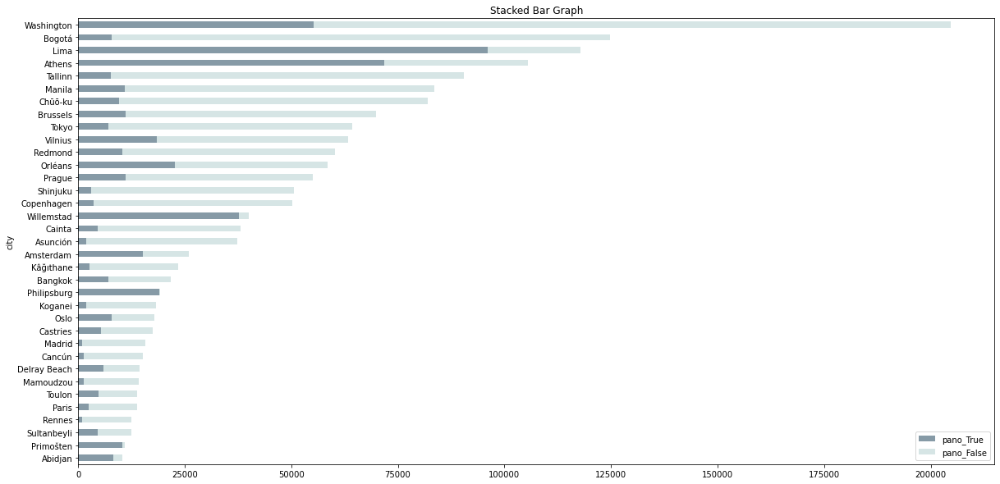

In [753]:
import matplotlib.pyplot as plt 

min_val, max_val = 0.6,0.88
n = 10
orig_cmap = plt.cm.bone
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# plot a Stacked Bar Chart using matplotlib 
df.plot( 
    x = 'city', 
    kind = 'barh', 
    stacked = True, 
    title = 'Stacked Bar Graph', 
    mark_right = True,
    figsize = (20, 10),
    cmap = cmap
)

In [754]:
df = pano_city.query("pano_True_perc>0.05 & total>10000")
print(df.city.nunique() == len(df))
df = df[['city', 'pano_True', 'pano_False']].sort_values('pano_True')
print(len(df))

True
35


<AxesSubplot:title={'center':'Stacked Bar Graph'}, ylabel='city'>

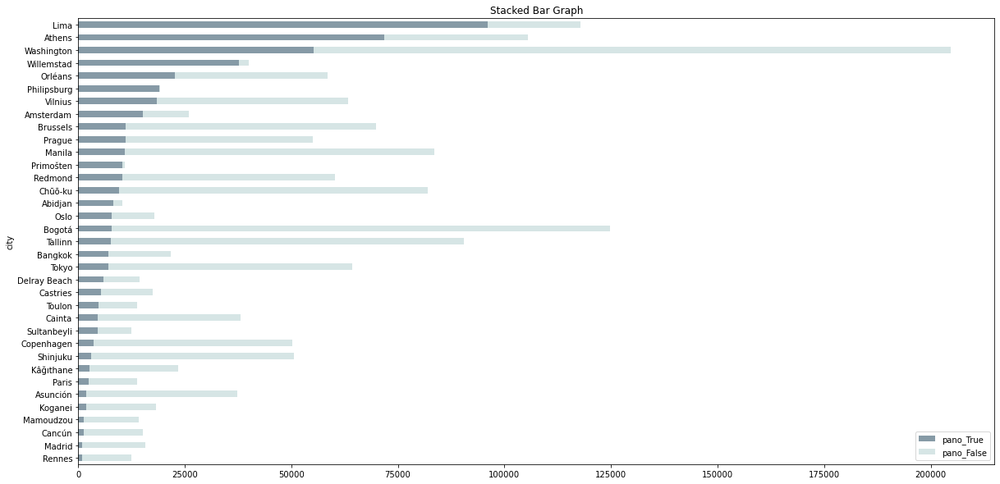

In [755]:
import matplotlib.pyplot as plt 

min_val, max_val = 0.6,0.88
n = 10
orig_cmap = plt.cm.bone
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# plot a Stacked Bar Chart using matplotlib 
df.plot( 
    x = 'city', 
    kind = 'barh', 
    stacked = True, 
    title = 'Stacked Bar Graph', 
    mark_right = True,
    figsize = (20, 10),
    cmap = cmap
)

## lighting condition

In [695]:
lc_sm = lc.merge(sm[['uuid', 'city_id']], on='uuid', how='left')

In [706]:
lc_city = lc_sm.groupby('city_id').lighting_condition.value_counts().rename('count').reset_index()
lc_city = lc_city.pivot(index='city_id', columns='lighting_condition', values='count').reset_index()

lighting_condition,city_id,day,dusk/dawn,night
0,1,10950.0,54.0,1.0
1,1004993580,56.0,1.0,NaN
2,1008162156,39575.0,959.0,16.0
3,1012126319,4400.0,468.0,4.0
4,1012973369,2439.0,51.0,113.0
...,...,...,...,...
672,1894157390,2861.0,2.0,2.0
673,1894950283,276.0,NaN,NaN
674,1901760068,38117.0,2403.0,562.0
675,1930654114,1756.0,69.0,65.0


In [707]:
lc_city = lc_sm.groupby('city_id').lighting_condition.value_counts().rename('count').reset_index()
lc_city = lc_city.pivot(index='city_id', columns='lighting_condition', values='count').reset_index()
lc_city = lc_city.merge(lc_sm.groupby('city_id').uuid.count().rename('total'), on='city_id', how='left')
lc_city['day_perc'] = lc_city['day']/lc_city['total']
lc_city['dusk/dawn_perc'] = lc_city['dusk/dawn']/lc_city['total']
lc_city['night_perc'] = lc_city['night']/lc_city['total']
lc_city

,city_id,day,dusk/dawn,night,total,day_perc,dusk/dawn_perc,night_perc
0,1,10950.0,54.0,1.0,11005,0.995002,0.004907,0.000091
1,1004993580,56.0,1.0,NaN,57,0.982456,0.017544,NaN
2,1008162156,39575.0,959.0,16.0,40550,0.975956,0.023650,0.000395
3,1012126319,4400.0,468.0,4.0,4872,0.903120,0.096059,0.000821
4,1012973369,2439.0,51.0,113.0,2603,0.936996,0.019593,0.043411
...,...,...,...,...,...,...,...,...
672,1894157390,2861.0,2.0,2.0,2865,0.998604,0.000698,0.000698
673,1894950283,276.0,NaN,NaN,276,1.000000,NaN,NaN
674,1901760068,38117.0,2403.0,562.0,41082,0.927827,0.058493,0.013680
675,1930654114,1756.0,69.0,65.0,1890,0.929101,0.036508,0.034392


In [708]:
lc_city = lc_city.merge(cities[['city', 'city_id', 'country', 'continent']], on='city_id', how='left')

In [709]:
lc_city.total.sum()

7127577

In [710]:
lc_city

,city_id,day,dusk/dawn,night,total,day_perc,dusk/dawn_perc,night_perc,city,country,continent
0,1,10950.0,54.0,1.0,11005,0.995002,0.004907,0.000091,Primošten,Croatia,Europe
1,1004993580,56.0,1.0,NaN,57,0.982456,0.017544,NaN,Kabul,Afghanistan,Asia
2,1008162156,39575.0,959.0,16.0,40550,0.975956,0.023650,0.000395,Tirana,Albania,Europe
3,1012126319,4400.0,468.0,4.0,4872,0.903120,0.096059,0.000821,Oran,Algeria,Africa
4,1012973369,2439.0,51.0,113.0,2603,0.936996,0.019593,0.043411,Algiers,Algeria,Africa
...,...,...,...,...,...,...,...,...,...,...,...
672,1894157390,2861.0,2.0,2.0,2865,0.998604,0.000698,0.000698,Lusaka,Zambia,Africa
673,1894950283,276.0,NaN,NaN,276,1.000000,NaN,NaN,Chililabombwe,Zambia,Africa
674,1901760068,38117.0,2403.0,562.0,41082,0.927827,0.058493,0.013680,Pristina,Kosovo,Europe
675,1930654114,1756.0,69.0,65.0,1890,0.929101,0.036508,0.034392,Longyearbyen,Svalbard,Europe


In [711]:
lc_city.to_csv('/Users/yujun/Data/global_streetscapes/cities677/cities677_lighting_condition_perc.csv')

<AxesSubplot:>

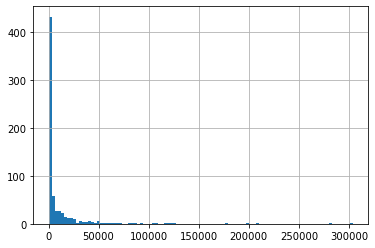

In [712]:
lc_city.total.hist(bins=100)

In [759]:
df = lc_city.query("night_perc>0.02 & total>10000")
print(df.city.nunique() == len(df))
df = df[['city', 'night_perc', 'dusk/dawn_perc', 'day_perc']].sort_values('night_perc')
print(len(df))

True
35


<AxesSubplot:title={'center':'Stacked Bar Graph'}, ylabel='city'>

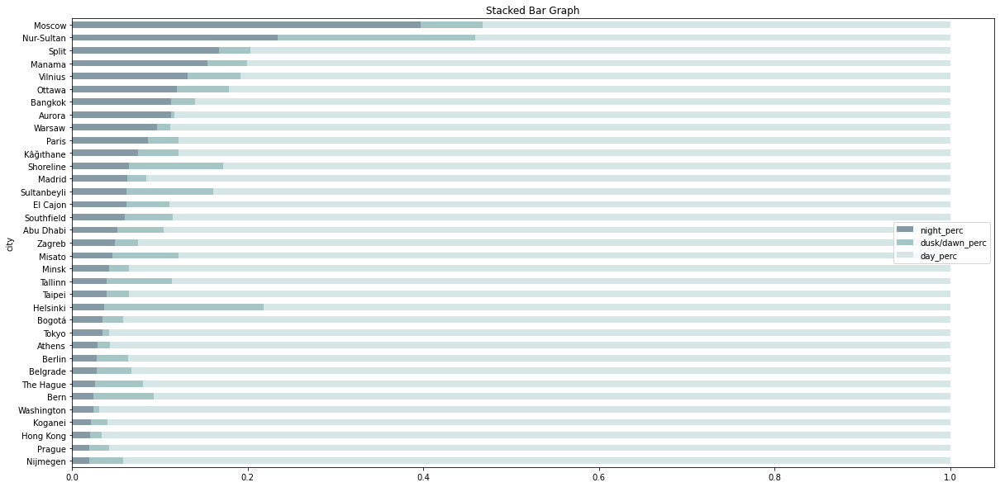

In [762]:
import matplotlib.pyplot as plt 

min_val, max_val = 0.6,0.88
n = 10
orig_cmap = plt.cm.bone
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# plot a Stacked Bar Chart using matplotlib 
df.plot( 
    x = 'city', 
    kind = 'barh', 
    stacked = True, 
    title = 'Stacked Bar Graph', 
    mark_right = True,
    figsize = (20, 10),
    cmap = cmap
)

In [769]:
df = lc_city.query("night_perc>0.02 & total>10000").sort_values('total')
print(df.city.nunique() == len(df))
df = df[['city', 'night', 'dusk/dawn', 'day']]
print(len(df))

True
35


<AxesSubplot:title={'center':'Stacked Bar Graph'}, ylabel='city'>

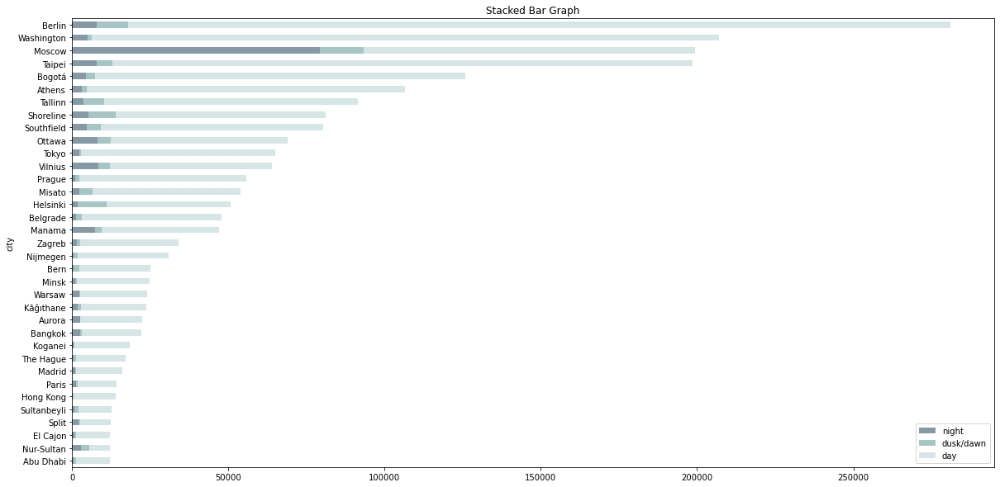

In [770]:
import matplotlib.pyplot as plt 

min_val, max_val = 0.6,0.88
n = 10
orig_cmap = plt.cm.bone
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# plot a Stacked Bar Chart using matplotlib 
df.plot( 
    x = 'city', 
    kind = 'barh', 
    stacked = True, 
    title = 'Stacked Bar Graph', 
    mark_right = True,
    figsize = (20, 10),
    cmap = cmap
)

In [771]:
df = lc_city.query("night_perc>0.02 & total>10000").sort_values('total')
print(df.city.nunique() == len(df))
df = df[['city', 'night', 'dusk/dawn', 'day']].sort_values('night')
print(len(df))

True
35


<AxesSubplot:title={'center':'Stacked Bar Graph'}, ylabel='city'>

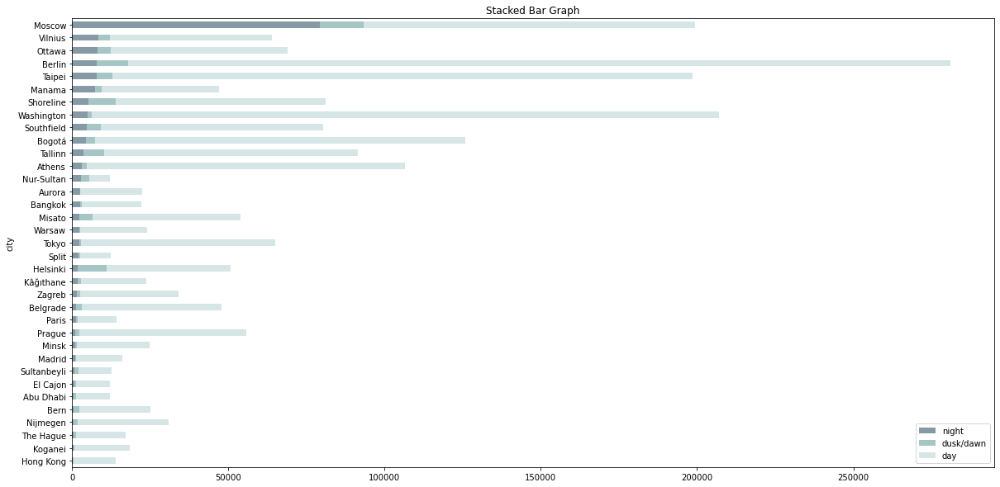

In [773]:
import matplotlib.pyplot as plt 

min_val, max_val = 0.6,0.88
n = 10
orig_cmap = plt.cm.bone
colors = orig_cmap(np.linspace(min_val, max_val, n))
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("mycmap", colors)

# plot a Stacked Bar Chart using matplotlib 
df.plot( 
    x = 'city', 
    kind = 'barh', 
    stacked = True, 
    title = 'Stacked Bar Graph', 
    mark_right = True,
    figsize = (20, 10),
    cmap = cmap
)

# Example images for continuous features
- GVI, SVI
- perception
- hFoV, vFoV
- hours after sunrise/sunset
- min, 10% percentile, Q1, mean, median, Q3, 90% percentile, max

## GVI and SVI

In [49]:
seg = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities677/tables/segmentation.csv').drop(columns=['Unnamed: 0'])

In [50]:
cols = ['uuid', 'source', 'orig_id', 'Vegetation', 'Sky', 'Total']
seg = seg[cols]
seg.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7127563 entries, 0 to 7127562
Data columns (total 6 columns):
 #   Column      Dtype 
---  ------      ----- 
 0   uuid        object
 1   source      object
 2   orig_id     int64 
 3   Vegetation  int64 
 4   Sky         int64 
 5   Total       int64 
dtypes: int64(4), object(2)
memory usage: 326.3+ MB


In [51]:
seg['green_view_index'] = seg.apply(lambda x: x['Vegetation']/x['Total'] if x['Total'] != 0 else None, axis=1)
seg['sky_view_index'] = seg.apply(lambda x: x['Sky']/x['Total'] if x['Total'] != 0 else None, axis=1)

### GVI

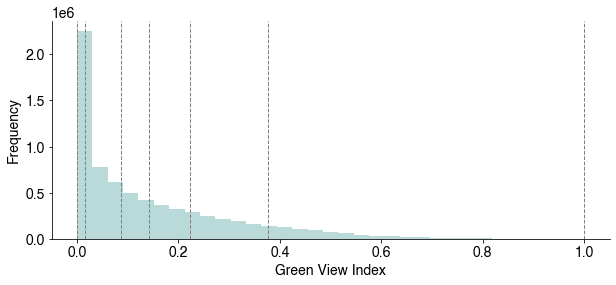

In [337]:
import numpy as np
import matplotlib.pyplot as plt

data = seg['green_view_index']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 14}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4.15))

plt.rc('xtick', labelsize=14) #fontsize of the x tick labels
plt.rc('ytick', labelsize=14) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=33, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
# ax.set_ylim(0, 1.6*(10**6))

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("Green View Index")
plt.ylabel("Frequency")
plt.subplots_adjust(bottom=0.15)

#plt.legend()
#plt.grid(True)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_gvi.png', format='png', dpi=300)
plt.show()

In [156]:
def isclose(a, b, rel_tol=0.00001, abs_tol=0.0):
    return abs(a-b) <= max(rel_tol * max(abs(a), abs(b)), abs_tol)

In [163]:
d = {'min': mini, 'p10': p10, 'p25': q1, 'mean': mean, 'median': q2, 'p75': q3, 'p90': p90, 'max': maxi}
for stat in d.keys():
    print(stat)
    print(seg[seg['green_view_index'].apply(lambda x: isclose(x, d[stat]))].sample(n=1, random_state=1).orig_id)

min
1288123    1212373909
Name: orig_id, dtype: int64
p10
1288123    1212373909
Name: orig_id, dtype: int64
p25
1479803    765389504452309
Name: orig_id, dtype: int64
mean
288087    1642937889428454
Name: orig_id, dtype: int64
median
2595122    285754523267783
Name: orig_id, dtype: int64
p75
628638    3272400733016120
Name: orig_id, dtype: int64
p90
3586917    1147342472345426
Name: orig_id, dtype: int64
max
2771499    297859521873772
Name: orig_id, dtype: int64


In [165]:
seg[seg['green_view_index'].apply(lambda x: isclose(x, d['max']))].sample(n=1, random_state=2)

,uuid,source,orig_id,Vegetation,Sky,Total,green_view_index,sky_view_index
3367210,a1a0538d-8861-4b5e-ab42-7ebbabe3172c,Mapillary,1216118405512773,2773160,0,2773160,1.0,0.0


In [166]:
print(d)

{'min': 0.0, 'p10': 0.0, 'p25': 0.016238074068990804, 'mean': 0.14290750085848877, 'median': 0.0867010138750259, 'p75': 0.22269844848422016, 'p90': 0.3766142704936358, 'max': 1.0}


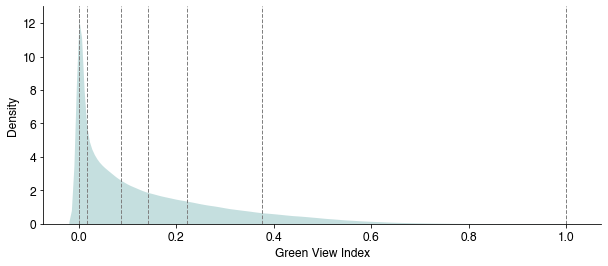

In [88]:
import numpy as np
import matplotlib.pyplot as plt

data = seg['green_view_index']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 12}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4))

plt.rc('xtick', labelsize=12) #fontsize of the x tick labels
plt.rc('ytick', labelsize=12) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
sns.kdeplot(data, ax=ax, color='#8CC0C0', fill=True, alpha=0.5, linewidth=0)

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
# ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 13)

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("Green View Index")
plt.ylabel("Density")
#plt.legend()
#plt.grid(True)
#plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_svi.key', format='png', dpi=300)
plt.show()

### SVI

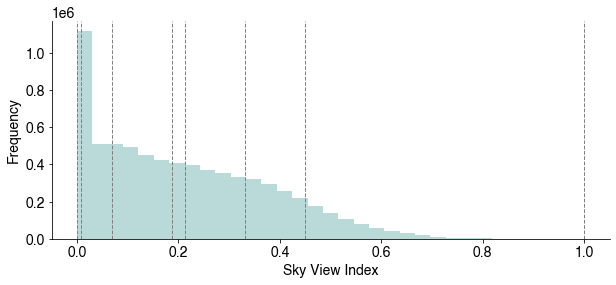

In [338]:
import numpy as np
import matplotlib.pyplot as plt

data = seg['sky_view_index']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 14}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4.15))

plt.rc('xtick', labelsize=14) #fontsize of the x tick labels
plt.rc('ytick', labelsize=14) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=33, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 1.6*(10**6))

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("Sky View Index")
plt.ylabel("Frequency")
plt.subplots_adjust(bottom=0.15)

#plt.legend()
#plt.grid(True)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_svi.png', format='png', dpi=300)
plt.show()

In [168]:
def isclose(a, b, rel_tol=0.00001, abs_tol=0.0):
    return abs(a-b) <= max(rel_tol * max(abs(a), abs(b)), abs_tol)

In [169]:
d = {'min': mini, 'p10': p10, 'p25': q1, 'mean': mean, 'median': q2, 'p75': q3, 'p90': p90, 'max': maxi}
for stat in d.keys():
    print(stat)
    print(seg[seg['sky_view_index'].apply(lambda x: isclose(x, d[stat]))].sample(n=1, random_state=1).orig_id)

min
5216274    310122424162607
Name: orig_id, dtype: int64
p10
5309179    296554431971719
Name: orig_id, dtype: int64
p25
6125129    813330519619530
Name: orig_id, dtype: int64
mean
3682042    921793561952120
Name: orig_id, dtype: int64
median
434125    768083510747110
Name: orig_id, dtype: int64
p75
1068625    1023678394
Name: orig_id, dtype: int64
p90
6380641    180653120699548
Name: orig_id, dtype: int64
max
2994438    1454278584910891
Name: orig_id, dtype: int64


In [174]:
seg[seg['sky_view_index'].apply(lambda x: isclose(x, d['max']))].sample(n=20, random_state=2)

,uuid,source,orig_id,Vegetation,Sky,Total,green_view_index,sky_view_index
3746148,2e9c354d-ff5d-4bc9-9448-2840118e7df3,Mapillary,3854993297886991,0,2359296,2359296,0.0,1.0
1843854,26af2fb3-2d01-4239-9001-0fb58a708275,Mapillary,2053036808172473,0,3151709,3151709,0.0,1.0
6415371,24947436-299b-427b-8b23-73c5a148a0ad,Mapillary,214934010439460,0,2359236,2359236,0.0,1.0
1353737,501e068a-f1bd-45f1-8a1c-c3c6708ea8c3,KartaView,159732327,0,8294400,8294400,0.0,1.0
1090707,d9237c3c-5fb2-4c9b-856a-862cb999f335,KartaView,13639734,0,7990272,7990272,0.0,1.0
664999,8a76b35c-c649-4703-ae9f-53531b1ffa2c,Mapillary,694227531294129,0,2359296,2359296,0.0,1.0
5882014,324845e0-b3d2-4849-a3c3-fbc84d009398,Mapillary,381339920131729,0,2097152,2097152,0.0,1.0
4792920,382594c9-f6a1-4c09-80a1-39276a14db27,Mapillary,483594519579756,0,2073600,2073600,0.0,1.0
1807637,66ea163f-30db-469f-83bf-3dbd3f724154,KartaView,13039213,0,5018112,5018112,0.0,1.0
809310,7cae1ba0-e958-43ed-bef7-f40bae15d293,Mapillary,271848128022651,0,3112960,3112960,0.0,1.0


In [236]:
seg.sort_values('sky_view_index', ascending=False)[:10]

,uuid,source,orig_id,Vegetation,Sky,Total,green_view_index,sky_view_index
6481027,5a8a85c2-a047-4090-9c63-6f97af830341,Mapillary,264378605367464,0,3145560,3145560,0.0,1.0
4700341,2dac32ae-89f1-47da-a3b3-5f250bd3441a,Mapillary,2582235045417634,0,3112960,3112960,0.0,1.0
6401930,07ab10b9-9970-469c-8234-2135077bbe94,Mapillary,405969024215666,0,2097152,2097152,0.0,1.0
5143184,dc96d2be-6abf-4859-9c21-fb5b77cbdf66,Mapillary,535315011339699,0,3145728,3145728,0.0,1.0
1633741,75c72bb4-dbaa-476e-a170-737ed318e7f3,Mapillary,389261266079492,0,2097152,2097152,0.0,1.0
3374007,5d9c1eb1-7e1d-4ce1-a096-5a5ad7d8ea3b,Mapillary,462529915038935,0,3145728,3145728,0.0,1.0
5402071,79af035c-2442-48e9-8f32-b86e8e93f04d,Mapillary,883556382582441,0,2097152,2097152,0.0,1.0
1632586,10817c14-97f8-4e3c-a8e0-10b378772d45,Mapillary,137830448390586,0,2073600,2073600,0.0,1.0
2692557,cb0af91a-34c7-44b7-b3f4-05acdd7862d7,Mapillary,1119629498531258,0,592929,592929,0.0,1.0
6372365,833514b4-b53d-48c5-b4cc-41eb98f9911f,Mapillary,345832393957187,0,2097152,2097152,0.0,1.0


In [237]:
seg[seg['sky_view_index']>=0.9]

,uuid,source,orig_id,Vegetation,Sky,Total,green_view_index,sky_view_index
5921,ad6ab2c2-b16c-4413-87cc-c592bdaf6cca,Mapillary,292776132455268,26034,2095029,2327148,0.011187,0.900256
6161,489c6796-a4a5-40bc-b928-1fb00cfe0f00,Mapillary,741888359837436,0,2359296,2359296,0.000000,1.000000
16303,9b149058-06fa-4771-8631-9aced723d6dd,Mapillary,1472207996468385,0,2097152,2097152,0.000000,1.000000
16878,f6242736-5923-406a-9f25-a8e44816f91d,Mapillary,917383145472531,24810,2135829,2357442,0.010524,0.905994
16959,f3872884-8ec9-498b-ad60-1a0c889bc4a7,Mapillary,2622866188012007,0,4194304,4194304,0.000000,1.000000
...,...,...,...,...,...,...,...,...
7063496,9d94d263-88f0-4224-9878-32e7a03f0bf3,Mapillary,532320251104857,174908,2864364,3141028,0.055685,0.911919
7069558,10c89173-4f5c-4df5-b56e-d780d50a665c,Mapillary,127587556201668,0,2097152,2097152,0.000000,1.000000
7081913,3ccd5549-7c16-4100-9760-bd071cfa63ca,Mapillary,744841036380192,0,2097152,2097152,0.000000,1.000000
7101324,75610d21-0d2f-45ea-a3c9-bd1261264473,Mapillary,488618879054125,130276,2974456,3141256,0.041473,0.946900


In [172]:
print(d)

{'min': 0.0, 'p10': 0.008236943751750946, 'p25': 0.06973989705135068, 'mean': 0.21289360801092191, 'median': 0.186612777404855, 'p75': 0.33199248896000555, 'p90': 0.4495013731238068, 'max': 1.0}


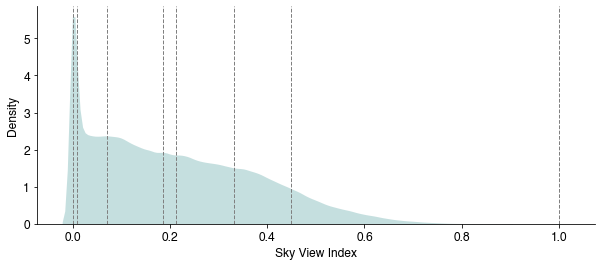

In [92]:
import numpy as np
import matplotlib.pyplot as plt

data = seg['sky_view_index']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 12}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4))

plt.rc('xtick', labelsize=12) #fontsize of the x tick labels
plt.rc('ytick', labelsize=12) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
sns.kdeplot(data, ax=ax, color='#8CC0C0', fill=True, alpha=0.5, linewidth=0)

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
# ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 13)

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("Sky View Index")
plt.ylabel("Density")
#plt.legend()
#plt.grid(True)
#plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_svi.key', format='png', dpi=300)
plt.show()

## Perception

In [71]:
perception = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities677/tables/perception.csv').drop(columns=['Unnamed: 0'])
perception.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7127577 entries, 0 to 7127576
Data columns (total 9 columns):
 #   Column      Dtype  
---  ------      -----  
 0   uuid        object 
 1   source      object 
 2   orig_id     int64  
 3   Beautiful   float64
 4   Boring      float64
 5   Depressing  float64
 6   Lively      float64
 7   Safe        float64
 8   Wealthy     float64
dtypes: float64(6), int64(1), object(2)
memory usage: 489.4+ MB


### Safe

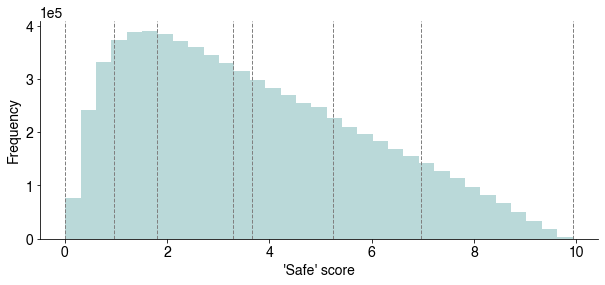

In [332]:
import numpy as np
import matplotlib.pyplot as plt

data = perception['Safe']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 14}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4.15))

plt.rc('xtick', labelsize=14) #fontsize of the x tick labels
plt.rc('ytick', labelsize=14) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=33, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 1.6*(10**6))

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("'Safe' score")
plt.ylabel("Frequency")
plt.subplots_adjust(bottom=0.15)

#plt.legend()
#plt.grid(True)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_safe.png', format='png', dpi=300)
plt.show()

In [223]:
def isclose(a, b, rel_tol=0.01, abs_tol=0.0):
    return abs(a-b) <= max(rel_tol * max(abs(a), abs(b)), abs_tol)

In [224]:
d = {'min': mini, 'p10': p10, 'p25': q1, 'mean': mean, 'median': q2, 'p75': q3, 'p90': p90, 'max': maxi}
for stat in d.keys():
    print(stat)
    print(perception[perception['Safe'].apply(lambda x: isclose(x, d[stat]))].sample(n=1, random_state=1))

min
                                         uuid     source           orig_id  \
2458337  94bb96f0-b95a-4afa-839c-e1aad88bece3  Mapillary  1102657750241557   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
2458337       2.52    3.64        7.55    1.64  0.01     0.59  
p10
                                        uuid     source    orig_id  Beautiful  \
204595  e28b2af9-c46c-400f-99c8-af11c60be693  KartaView  782902462       1.17   

        Boring  Depressing  Lively  Safe  Wealthy  
204595    4.95        5.42    2.36  0.97     1.99  
p25
                                         uuid     source          orig_id  \
6461644  0eb71f80-396d-4086-980b-8648d863dad9  Mapillary  936550313554291   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
6461644       4.83     1.7        6.64    6.53  1.79     2.75  
mean
                                         uuid     source          orig_id  \
6870138  c7c305b1-5f8e-4a37-9a33-a30fd68862be  Mapillary  3138287770241

In [217]:
perception.sort_values('Safe')

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
4827861,e78c612a-8c4a-4bb8-b6a7-33f918b59b8d,Mapillary,312002083857852,3.50,7.59,8.85,2.13,0.01,0.69
2458337,94bb96f0-b95a-4afa-839c-e1aad88bece3,Mapillary,1102657750241557,2.52,3.64,7.55,1.64,0.01,0.59
5001286,0c974620-8f54-4f9c-949f-eba3a85a5a65,Mapillary,4694770790650128,4.98,5.17,6.74,3.81,0.01,4.40
2074839,b4ab07f5-f9d9-47e5-9ba6-104ae967546f,Mapillary,221604863106948,1.82,8.16,7.39,5.58,0.02,1.28
2315499,b0d43e82-308c-4420-aa6c-198aed81346b,Mapillary,704426484067506,8.16,5.19,8.18,1.36,0.02,2.76
...,...,...,...,...,...,...,...,...,...
4328252,a3d6f9d9-18fa-40dc-b7c9-4fb0885e1103,Mapillary,769716893747882,7.05,4.39,1.99,9.34,9.92,9.27
1672436,c818e623-8f9d-4b91-81f2-defa27c1584e,Mapillary,605371973786556,9.82,1.17,0.55,9.69,9.93,9.45
1988238,53940434-4bcb-4748-9cb6-8fa31377a219,Mapillary,295828282035888,9.73,6.22,2.95,8.56,9.93,9.73
1053169,d301a82b-bb32-4313-ba02-9f9a210f0bac,Mapillary,912397255993563,3.54,3.79,6.48,7.24,NaN,4.28


In [220]:
perception[perception['Safe'].apply(lambda x: isclose(x, d['p10']))].sample(n=1, random_state=13)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
4729100,5ed08466-12dc-4c03-82b3-debe7bdaac0a,Mapillary,1085341505286358,3.53,7.47,7.02,2.5,0.97,6.41


In [189]:
perception[perception['Wealthy'].apply(lambda x: isclose(x, d['p25']))].sample(n=1, random_state=3)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
2466627,4f0964cc-486a-452d-b2c7-05cbd00d3e97,Mapillary,320186019733164,8.4,0.7,3.69,7.24,2.56,2.42


In [225]:
print(d)

{'min': 0.01, 'p10': 0.97, 'p25': 1.8, 'mean': 3.65369884848634, 'median': 3.29, 'p75': 5.25, 'p90': 6.97, 'max': 9.93}


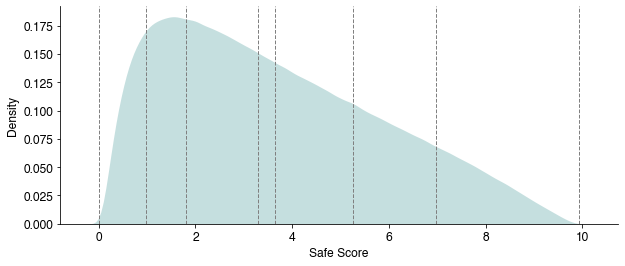

In [91]:
import numpy as np
import matplotlib.pyplot as plt

data = perception['Safe']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 12}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4))

plt.rc('xtick', labelsize=12) #fontsize of the x tick labels
plt.rc('ytick', labelsize=12) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
sns.kdeplot(data, ax=ax, color='#8CC0C0', fill=True, alpha=0.5, linewidth=0)

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
# ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 13)

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("Safe score")
plt.ylabel("Density")
#plt.legend()
#plt.grid(True)
#plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_svi.key', format='png', dpi=300)
plt.show()

### Beautiful

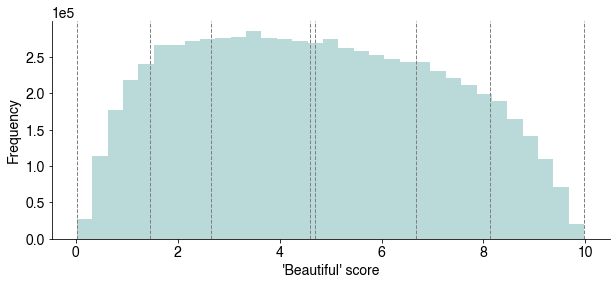

In [333]:
import numpy as np
import matplotlib.pyplot as plt

data = perception['Beautiful']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 14}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4.15))

plt.rc('xtick', labelsize=14) #fontsize of the x tick labels
plt.rc('ytick', labelsize=14) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=33, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 1.6*(10**6))

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("'Beautiful' score")
plt.ylabel("Frequency")
plt.subplots_adjust(bottom=0.15)

#plt.legend()
#plt.grid(True)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_beautiful.png', format='png', dpi=300)
plt.show()

In [180]:
def isclose(a, b, rel_tol=0.001, abs_tol=0.0):
    return abs(a-b) <= max(rel_tol * max(abs(a), abs(b)), abs_tol)

In [181]:
d = {'min': mini, 'p10': p10, 'p25': q1, 'mean': mean, 'median': q2, 'p75': q3, 'p90': p90, 'max': maxi}
for stat in d.keys():
    print(stat)
    print(perception[perception['Beautiful'].apply(lambda x: isclose(x, d[stat]))].sample(n=1, random_state=1))

min
                                         uuid     source          orig_id  \
5170517  4bb17b4d-1df0-4adb-aa8d-f47a5414ddd9  Mapillary  135248189066453   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
5170517       0.02    3.21        2.26    5.22  1.59     2.35  
p10
                                         uuid     source          orig_id  \
2234370  577650d6-8e7e-407b-956c-6e561d768fba  Mapillary  190175296298894   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
2234370       1.45    6.25        6.37    1.43  1.07     1.06  
p25
                                         uuid     source          orig_id  \
6685801  ab64cc3b-9470-4325-9fdc-6fbce7145fb6  Mapillary  140997274719601   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
6685801       2.65    4.88        3.56    0.83  4.84     2.41  
mean
                                         uuid     source           orig_id  \
4091086  e0183d10-e053-4ad5-ac14-2a1e54c124f0  Mapillary

In [183]:
perception[perception['Beautiful'].apply(lambda x: isclose(x, d['p90']))].sample(n=1, random_state=3)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
2950090,ed2e7e98-baa7-41c3-8d42-a6d38245b0b2,Mapillary,473970280506638,8.14,2.61,3.46,2.32,3.94,4.03


In [184]:
print(d)

{'min': 0.02, 'p10': 1.45, 'p25': 2.65, 'mean': 4.7014748392055274, 'median': 4.6, 'p75': 6.68, 'p90': 8.14, 'max': 9.98}


### Lively

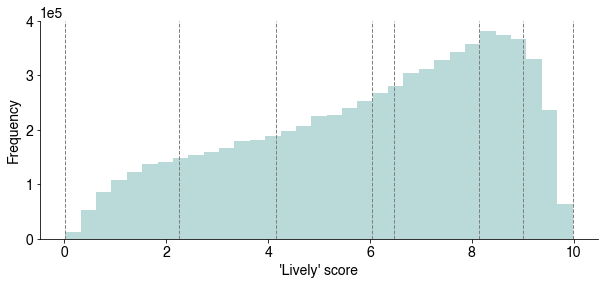

In [335]:
import numpy as np
import matplotlib.pyplot as plt

data = perception['Lively']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 14}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4.15))

plt.rc('xtick', labelsize=14) #fontsize of the x tick labels
plt.rc('ytick', labelsize=14) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=33, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 1.6*(10**6))

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("'Lively' score")
plt.ylabel("Frequency")
plt.subplots_adjust(bottom=0.15)

#plt.legend()
#plt.grid(True)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_lively.png', format='png', dpi=300)
plt.show()

In [194]:
def isclose(a, b, rel_tol=0.001, abs_tol=0.0):
    return abs(a-b) <= max(rel_tol * max(abs(a), abs(b)), abs_tol)

In [195]:
d = {'min': mini, 'p10': p10, 'p25': q1, 'mean': mean, 'median': q2, 'p75': q3, 'p90': p90, 'max': maxi}
for stat in d.keys():
    print(stat)
    print(perception[perception['Lively'].apply(lambda x: isclose(x, d[stat]))].sample(n=1, random_state=1))

min
                                         uuid     source          orig_id  \
1613868  aab5c2d2-9b54-450c-bdbb-3c2f78489220  Mapillary  529217935153244   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
1613868       1.69    5.74        7.06    0.02  0.62     0.73  
p10
                                         uuid     source           orig_id  \
2941302  a83e1729-7fa9-4248-910e-527f9a67f05a  Mapillary  1138329169926053   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
2941302       8.62    5.03        2.09    2.25  0.48     2.38  
p25
                                         uuid     source          orig_id  \
6866347  c45a4c1d-412f-498d-abe0-d84caa53a693  Mapillary  245219194054175   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
6866347       7.31    4.16        6.23    4.16  1.99     3.31  
mean
                                         uuid     source          orig_id  \
3117268  c249c9d9-5831-4f83-b826-9ecca4f9524e  Mapillar

In [197]:
perception[perception['Lively'].apply(lambda x: isclose(x, d['p90']))].sample(n=1, random_state=2)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
6884710,5e2e24d8-70e7-4ff1-bbf6-9d7408468c43,Mapillary,506155800813121,2.04,4.06,4.04,9.01,7.43,3.33


In [189]:
perception[perception['Lively'].apply(lambda x: isclose(x, d['p25']))].sample(n=1, random_state=3)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
2466627,4f0964cc-486a-452d-b2c7-05cbd00d3e97,Mapillary,320186019733164,8.4,0.7,3.69,7.24,2.56,2.42


In [196]:
print(d)

{'min': 0.02, 'p10': 2.25, 'p25': 4.16, 'mean': 6.032747132721261, 'median': 6.48, 'p75': 8.14, 'p90': 9.01, 'max': 9.98}


### Depressing

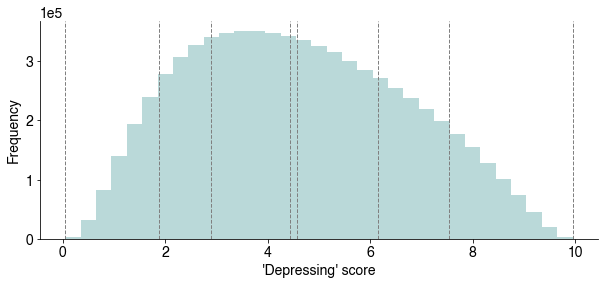

In [336]:
import numpy as np
import matplotlib.pyplot as plt

data = perception['Depressing']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 14}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4.15))

plt.rc('xtick', labelsize=14) #fontsize of the x tick labels
plt.rc('ytick', labelsize=14) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=33, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 1.6*(10**6))

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("'Depressing' score")
plt.ylabel("Frequency")
plt.subplots_adjust(bottom=0.15)

#plt.legend()
#plt.grid(True)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_depressing.png', format='png', dpi=300)
plt.show()

In [199]:
def isclose(a, b, rel_tol=0.001, abs_tol=0.0):
    return abs(a-b) <= max(rel_tol * max(abs(a), abs(b)), abs_tol)

In [200]:
d = {'min': mini, 'p10': p10, 'p25': q1, 'mean': mean, 'median': q2, 'p75': q3, 'p90': p90, 'max': maxi}
for stat in d.keys():
    print(stat)
    print(perception[perception['Depressing'].apply(lambda x: isclose(x, d[stat]))].sample(n=1, random_state=1))

min
                                         uuid     source          orig_id  \
7000190  e43188d3-7fa6-4beb-970b-4ae8ec241c6f  Mapillary  787281795517320   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
7000190       0.54    7.61        0.05    5.13  0.59     2.61  
p10
                                         uuid     source           orig_id  \
1556697  23ee9cce-1f70-46a5-9b92-c89651a2c72c  Mapillary  1965960733582503   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
1556697       2.99    4.73        1.87    6.37  3.27     1.17  
p25
                                         uuid     source          orig_id  \
3113338  b2eef6ba-d6d4-492e-80f5-3f06f090a785  Mapillary  138534731596534   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
3113338       6.16    7.92         2.9    5.27  0.22     4.04  
mean
                                         uuid     source          orig_id  \
3054587  85f808e9-8ed2-4a1e-90a2-0ec2d352eff9  Mapillar

In [212]:
perception.sort_values('Depressing')

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
7000190,e43188d3-7fa6-4beb-970b-4ae8ec241c6f,Mapillary,787281795517320,0.54,7.61,0.05,5.13,0.59,2.61
6844167,2e163c6d-cde4-4aec-ae80-87e5967b6deb,Mapillary,1146949879190288,7.28,1.05,0.06,7.00,2.30,5.39
2803221,309035f9-7941-4fdc-b242-4edf6b3e7878,Mapillary,618171759761087,7.59,6.36,0.07,2.99,1.43,0.36
6101089,3099064c-aaa5-46ae-b241-f01c53c99328,Mapillary,587484559310833,7.04,4.29,0.07,3.03,3.62,2.43
1190480,925377fd-c010-49b6-b83f-8a85796d4172,Mapillary,166714782009624,5.00,6.13,0.07,3.13,5.60,4.59
...,...,...,...,...,...,...,...,...,...
6309525,dc15b8cc-f4bc-4662-be1c-f8bf20ab07ac,Mapillary,1065828477352038,2.71,0.79,9.93,9.32,1.93,1.81
6631448,90f6e5f5-82ae-4821-b86e-0e7a5ca875f3,Mapillary,366490235198345,2.47,0.79,9.93,9.25,2.06,1.66
2576904,fa6a3693-a56a-4500-bbc7-df54c30924a2,Mapillary,969999223831518,1.43,6.54,9.95,7.44,0.50,0.77
2669482,6baecf3f-951c-4115-be5a-fe927e2e636f,Mapillary,520013066044521,1.43,6.53,9.95,7.43,0.50,0.76


In [206]:
perception[perception['Depressing'].apply(lambda x: isclose(x, d['min']))].sample(n=1, random_state=13)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
7000190,e43188d3-7fa6-4beb-970b-4ae8ec241c6f,Mapillary,787281795517320,0.54,7.61,0.05,5.13,0.59,2.61


In [189]:
perception[perception['Wealthy'].apply(lambda x: isclose(x, d['p25']))].sample(n=1, random_state=3)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
2466627,4f0964cc-486a-452d-b2c7-05cbd00d3e97,Mapillary,320186019733164,8.4,0.7,3.69,7.24,2.56,2.42


In [213]:
print(d)

{'min': 0.05, 'p10': 1.87, 'p25': 2.9, 'mean': 4.5775219783665655, 'median': 4.44, 'p75': 6.15, 'p90': 7.53, 'max': 9.95}


### Boring

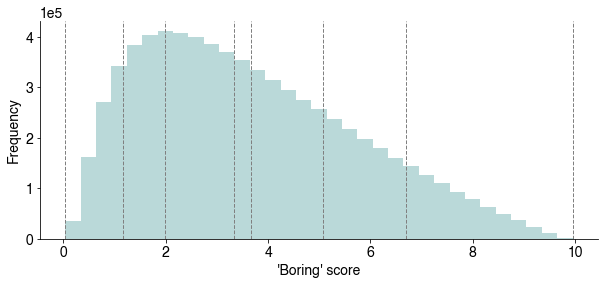

In [331]:
import numpy as np
import matplotlib.pyplot as plt

data = perception['Boring']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 14}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4.15))

plt.rc('xtick', labelsize=14) #fontsize of the x tick labels
plt.rc('ytick', labelsize=14) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=33, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 1.6*(10**6))
plt.subplots_adjust(bottom=0.15)

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("'Boring' score")
plt.ylabel("Frequency")
#plt.legend()
#plt.grid(True)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_boring.png', format='png', dpi=300)
plt.show()

In [231]:
def isclose(a, b, rel_tol=0.0001, abs_tol=0.0):
    return abs(a-b) <= max(rel_tol * max(abs(a), abs(b)), abs_tol)

In [232]:
d = {'min': mini, 'p10': p10, 'p25': q1, 'median': q2, 'p75': q3, 'p90': p90, 'max': maxi}
for stat in d.keys():
    print(stat)
    print(perception[perception['Boring'].apply(lambda x: isclose(x, d[stat]))].sample(n=1, random_state=1))

min
                                         uuid     source          orig_id  \
3648620  b8181ca3-1421-4ba9-b6a6-bc09a6982f57  Mapillary  904610136810581   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
3648620       3.04    0.04        1.92     2.6   1.5     8.44  
p10
                                         uuid     source          orig_id  \
4376388  a3bb42c8-883f-4a41-82cc-37fb7a26b421  Mapillary  998518047736463   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
4376388       2.82    1.16        7.76    6.59  2.75     0.25  
p25
                                         uuid     source           orig_id  \
3765159  ec107231-e023-426c-a975-538a86a9cb76  Mapillary  5529117780495167   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
3765159       2.76    1.98        6.08    5.58  7.64     4.99  
median
                                         uuid     source          orig_id  \
2506337  fd70c438-c772-4985-b99b-73a9d565a634  Mapill

In [230]:
def isclose(a, b, rel_tol=0.01, abs_tol=0.0):
    return abs(a-b) <= max(rel_tol * max(abs(a), abs(b)), abs_tol)

perception[perception['Boring'].apply(lambda x: isclose(x, d['mean']))].sample(n=1, random_state=1)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
5839857,f1b19775-16f6-4046-b163-303e7ac5b63b,Mapillary,3998537953569901,1.88,3.64,3.66,4.1,7.07,4.92


In [229]:
perception.sort_values('Boring')

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
3648620,b8181ca3-1421-4ba9-b6a6-bc09a6982f57,Mapillary,904610136810581,3.04,0.04,1.92,2.60,1.50,8.44
6449892,65e8d013-ee76-459f-8214-bf4df4312db1,Mapillary,1156789101429976,0.76,0.04,2.75,8.48,5.94,7.27
5637600,79da5f8e-2903-4c37-a301-d631f419d64b,Mapillary,2130273020470753,2.56,0.04,8.04,4.72,4.98,4.93
2136730,5963e2b2-04af-4a8b-ad48-5d13d5ce68b3,Mapillary,3951963468245407,0.98,0.05,2.03,8.24,1.33,5.65
5941162,fa5c9662-c916-4010-95b0-777a1d888c8e,Mapillary,336074484520658,6.00,0.05,3.26,5.66,2.72,6.17
...,...,...,...,...,...,...,...,...,...
5174243,e7c990b8-4772-4fe6-a485-b7fb5c8850a1,Mapillary,480504636506243,2.07,9.94,2.90,7.12,4.74,5.07
6045285,a39ca03f-9aee-496e-84ed-2e21b60e957c,Mapillary,4223022284414960,4.11,9.94,6.55,4.63,2.96,3.06
6422962,a335af7e-f43f-4bc9-afd4-d6ebca78f801,Mapillary,923221558412471,1.24,9.94,5.27,1.83,3.18,4.48
1706739,17ee6501-1d0d-4bf6-ab39-7258b6c58f97,Mapillary,327004175486041,5.15,9.95,2.03,3.98,2.10,4.41


In [233]:
perception[perception['Boring'].apply(lambda x: isclose(x, d['p10']))].sample(n=1, random_state=13)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
3426560,fd4e8845-736a-4f94-9290-88e3c21cfdc4,Mapillary,766635947340821,4.41,1.16,4.14,9.01,4.1,8.59


In [189]:
perception[perception['Boring'].apply(lambda x: isclose(x, d['p25']))].sample(n=1, random_state=3)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
2466627,4f0964cc-486a-452d-b2c7-05cbd00d3e97,Mapillary,320186019733164,8.4,0.7,3.69,7.24,2.56,2.42


In [213]:
print(d)

{'min': 0.05, 'p10': 1.87, 'p25': 2.9, 'mean': 4.5775219783665655, 'median': 4.44, 'p75': 6.15, 'p90': 7.53, 'max': 9.95}


### Wealthy

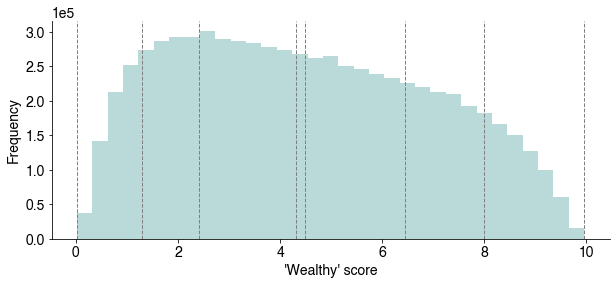

In [334]:
import numpy as np
import matplotlib.pyplot as plt

data = perception['Wealthy']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 14}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4.15))

plt.rc('xtick', labelsize=14) #fontsize of the x tick labels
plt.rc('ytick', labelsize=14) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=33, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 1.6*(10**6))

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("'Wealthy' score")
plt.ylabel("Frequency")
plt.subplots_adjust(bottom=0.15)

#plt.legend()
#plt.grid(True)
plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_wealthy.png', format='png', dpi=300)
plt.show()

In [186]:
def isclose(a, b, rel_tol=0.001, abs_tol=0.0):
    return abs(a-b) <= max(rel_tol * max(abs(a), abs(b)), abs_tol)

In [187]:
d = {'min': mini, 'p10': p10, 'p25': q1, 'mean': mean, 'median': q2, 'p75': q3, 'p90': p90, 'max': maxi}
for stat in d.keys():
    print(stat)
    print(perception[perception['Wealthy'].apply(lambda x: isclose(x, d[stat]))].sample(n=1, random_state=1))

min
                                        uuid     source          orig_id  \
903983  8b7798b1-60a3-42bb-a24b-be222628250a  Mapillary  301000988309872   

        Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
903983       1.71    7.85        7.41    1.62  0.29     0.02  
p10
                                         uuid     source          orig_id  \
4116191  282a4287-4832-474f-b3f5-b40d0043095c  Mapillary  859609107971317   

         Beautiful  Boring  Depressing  Lively  Safe  Wealthy  
4116191       5.07    5.78        9.51    0.59  0.45      1.3  
p25
                                        uuid     source    orig_id  Beautiful  \
202410  2b47b326-8d88-4594-adeb-4013116558b1  KartaView  766605574       6.12   

        Boring  Depressing  Lively  Safe  Wealthy  
202410    4.95        3.89     5.8  7.49     2.42  
mean
                                         uuid     source          orig_id  \
4332292  c951c1f0-d4a0-4394-820b-12171201172f  Mapillary  176498204358589   


In [191]:
perception[perception['Wealthy'].apply(lambda x: isclose(x, d['p90']))].sample(n=1, random_state=2)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
1837088,08b57884-addd-4cee-9700-dd3916f24b4d,Mapillary,306584100872343,6.98,2.15,2.2,9.19,6.22,8.0


In [189]:
perception[perception['Wealthy'].apply(lambda x: isclose(x, d['p25']))].sample(n=1, random_state=3)

,uuid,source,orig_id,Beautiful,Boring,Depressing,Lively,Safe,Wealthy
2466627,4f0964cc-486a-452d-b2c7-05cbd00d3e97,Mapillary,320186019733164,8.4,0.7,3.69,7.24,2.56,2.42


In [190]:
print(d)

{'min': 0.02, 'p10': 1.3, 'p25': 2.42, 'mean': 4.489897395706843, 'median': 4.31, 'p75': 6.45, 'p90': 8.0, 'max': 9.96}


## HFOV and VFOV

In [112]:
meta = pd.read_csv('/Users/yujun/Data/global_streetscapes/cities677/tables/metadata_common_attributes.csv').drop(columns=['Unnamed: 0'])
meta.info()

/Users/yujun/opt/anaconda3/envs/ox/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (14) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7127577 entries, 0 to 7127576
Data columns (total 15 columns):
 #   Column              Dtype  
---  ------              -----  
 0   uuid                object 
 1   source              object 
 2   orig_id             int64  
 3   lat                 float64
 4   lon                 float64
 5   datetime_local      object 
 6   width               int64  
 7   height              int64  
 8   heading             float64
 9   projection_type     object 
 10  hFoV                float64
 11  vFoV                float64
 12  sequence_index      int64  
 13  sequence_id         object 
 14  sequence_img_count  int64  
dtypes: float64(5), int64(5), object(5)
memory usage: 815.7+ MB


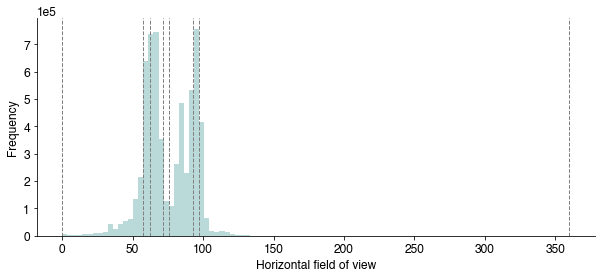

In [119]:
import numpy as np
import matplotlib.pyplot as plt

data = meta['hFoV']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 12}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4))

plt.rc('xtick', labelsize=12) #fontsize of the x tick labels
plt.rc('ytick', labelsize=12) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=100, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 1.6*(10**6))

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("Horizontal field of view")
plt.ylabel("Frequency")
#plt.legend()
#plt.grid(True)
#plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_hfov.key', format='png', dpi=300)
plt.show()

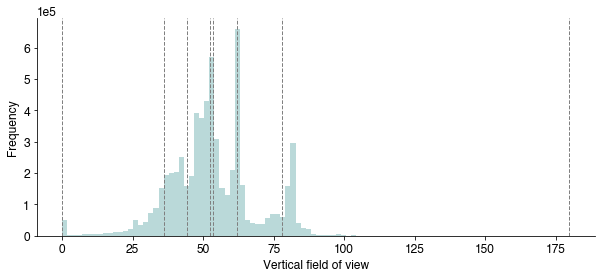

In [120]:
import numpy as np
import matplotlib.pyplot as plt

data = meta['vFoV']

# Calculate quartiles
q1 = np.nanpercentile(data, 25)
q2 = np.nanpercentile(data, 50)  # Median
q3 = np.nanpercentile(data, 75)

# Calculate some percentiles
p10 = np.nanpercentile(data, 10)
p90 = np.nanpercentile(data, 90)

# Calculate min, mean, max
mini = np.min(data)
maxi = np.max(data)
mean = np.mean(data)

hfont = {'family':'Helvetica',
        'weight': 'regular',
        'size': 12}

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 4))

plt.rc('xtick', labelsize=12) #fontsize of the x tick labels
plt.rc('ytick', labelsize=12) #fontsize of the x tick labels
plt.rc('font', **hfont)

# Histogram
ax.hist(data, bins=100, alpha=0.6, color='#8CC0C0')

# Quartiles and percentiles
# plt.axvline(x=q1, color='r', linestyle='--', label="Q1 (25th percentile)")
# plt.axvline(x=q2, color='b', linestyle='--', label="Q2 (Median/50th percentile)")
# plt.axvline(x=q3, color='r', linestyle='--', label="Q3 (75th percentile)")
# plt.axvline(x=p10, color='c', linestyle='-.', label="10th percentile")
# plt.axvline(x=p90, color='m', linestyle='-.', label="90th percentile")
# plt.axvline(x=mini, color='black', linestyle='-.', label="Minimum")
# plt.axvline(x=maxi, color='black', linestyle='-.', label="Maximum")
# plt.axvline(x=mean, color='black', linestyle='-.', label="Mean")

ax.axvline(x=q1, color='grey', linestyle='--', lw=1)
ax.axvline(x=q2, color='grey', linestyle='--', lw=1)
ax.axvline(x=q3, color='grey', linestyle='--', lw=1)
ax.axvline(x=p10, color='grey', linestyle='--', lw=1)
ax.axvline(x=p90, color='grey', linestyle='--', lw=1)
ax.axvline(x=mini, color='grey', linestyle='--', lw=1)
ax.axvline(x=maxi, color='grey', linestyle='--', lw=1)
ax.axvline(x=mean, color='grey', linestyle='--', lw=1)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
# ax.spines['left'].set_visible(False)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
#ax.set_ylim(0, 1.6*(10**6))

# Setting labels, title, and legend
#ax.title("Visualization of Quartiles and Percentiles")
plt.xlabel("Vertical field of view")
plt.ylabel("Frequency")
#plt.legend()
#plt.grid(True)
#plt.savefig('/Users/yujun/Code/Python/global-streetscapes-internal/img/percentiles_vfov.key', format='png', dpi=300)
plt.show()